# Visualize Zarr Files
https://towardsdatascience.com/displaying-a-gridded-dataset-on-a-web-based-map-ad6bbe90247f

In [6]:
import sys
import glob
import numpy as np
import xarray as xr
import matplotlib as mp
import matplotlib.pyplot as plt
import holoviews as hv
import holoviews.operation.datashader as hd
import bokeh as bk

#import rioxarray as rxr

print('Versions: ', 
  {
  'glob': hv.__version__, 
  'xarray': hv.__version__, 
  'holoviews': hv.__version__, 
  'bokeh': bk.__version__, 
  }
)

Versions:  {'glob': '1.14.7', 'xarray': '1.14.7', 'holoviews': '1.14.7', 'bokeh': '2.4.2'}


# Read Zarr file


In [342]:
# Test file
f = '/data/2019/S2019847/ACOUSTIC/GRIDDED/S2019847_sv.zarr'
#f = glob.glob(d+'/*')
print(f)

/data/2019/S2019847/ACOUSTIC/GRIDDED/S2019847_labels.zarr


In [344]:
kkk = xr.open_zarr('/data/2019/S2019847/ACOUSTIC/GRIDDED/S2019847_labels.zarr', consolidated = False)
kkk

<xarray.Dataset>
Dimensions:     (category: 4, ping_time: 3984739, range: 2634)
Coordinates:
  * category    (category) int64 -1 1 27 6009
  * ping_time   (ping_time) datetime64[ns] 2019-04-23T16:56:17.438000 ... 201...
  * range       (range) float64 -0.19 0.0 0.19 0.3799 ... 499.6 499.8 500.0
Data variables:
    annotation  (category, ping_time, range) float32 dask.array<chunksize=(1, 40000, 2634), meta=np.ndarray>
    object      (ping_time, range) int64 dask.array<chunksize=(40000, 2634), meta=np.ndarray>
    objecttype  (ping_time, range) int64 dask.array<chunksize=(40000, 2634), meta=np.ndarray>

In [337]:
data=xr.open_zarr(f, consolidated = False)
data


<xarray.Dataset>
Dimensions:            (frequency: 6, ping_time: 3984739, range: 2634)
Coordinates:
    channel_id         (frequency) <U38 dask.array<chunksize=(1,), meta=np.ndarray>
  * frequency          (frequency) float64 3.8e+04 1.8e+04 ... 2e+05 3.33e+05
    latitude           (ping_time) float64 dask.array<chunksize=(11690,), meta=np.ndarray>
    longitude          (ping_time) float64 dask.array<chunksize=(11690,), meta=np.ndarray>
  * ping_time          (ping_time) datetime64[ns] 2019-04-23T16:56:17.438000 ...
  * range              (range) float64 -0.19 0.0 0.19 ... 499.6 499.8 500.0
    raw_file           (ping_time) <U29 dask.array<chunksize=(11690,), meta=np.ndarray>
Data variables:
    angle_alongship    (frequency, ping_time, range) float32 dask.array<chunksize=(1, 11690, 2634), meta=np.ndarray>
    angle_athwartship  (frequency, ping_time, range) float32 dask.array<chunksize=(1, 11690, 2634), meta=np.ndarray>
    distance           (ping_time) float64 dask.array<chunksize=(11690,), meta=np.ndarray>
    heading            (ping_time) float32 dask.array<chunksize=(11690,), meta=np.ndarray>
    heave              (ping_time) float32 dask.array<chunksize=(11690,), meta=np.ndarray>
    pitch              (ping_time) float32 dask.array<chunksize=(11690,), meta=np.ndarray>
    pulse_length       (frequency) float32 dask.array<chunksize=(1,), meta=np.ndarray>
    roll               (ping_time) float32 dask.array<chunksize=(11690,), meta=np.ndarray>
    speed              (ping_time) float64 dask.array<chunksize=(11690,), meta=np.ndarray>
    sv                 (frequency, ping_time, range) float32 dask.array<chunksize=(1, 11690, 2634), meta=np.ndarray>
    transducer_draft   (frequency, ping_time) float64 dask.array<chunksize=(1, 11690), meta=np.ndarray>
Attributes:
    commit_sha:   XXXXXXXX
    description:  Multi-frequency sv values from EK.
    name:         CRIMAC-preprocessor
    pyecholab:    conda_version_20220419
    time:         2022-04-28T02:34:15Z
    version:      0.2

In [4]:
df = data.sv[0,1:1000,1:100]
df

<xarray.DataArray 'sv' (ping_time: 999, range: 99)>
dask.array<getitem, shape=(999, 99), dtype=float32, chunksize=(999, 99), chunktype=numpy.ndarray>
Coordinates:
    channel_id  <U37 dask.array<chunksize=(), meta=np.ndarray>
    frequency   float64 3.8e+04
    latitude    (ping_time) float64 dask.array<chunksize=(999,), meta=np.ndarray>
    longitude   (ping_time) float64 dask.array<chunksize=(999,), meta=np.ndarray>
  * ping_time   (ping_time) datetime64[ns] 2019-02-13T15:31:57.206000 ... 201...
  * range       (range) float64 0.0 0.1888 0.3776 0.5664 ... 18.12 18.31 18.5
    raw_file    (ping_time) <U21 dask.array<chunksize=(999,), meta=np.ndarray>

In [5]:
cdepth = 50
c1 = -82 # dB
c2 = -30 # dB
levels = 10**(np.linspace(c1, c2, cdepth)/10)
#print(levels)
cmap =  [mp.colors.rgb2hex(c) for c in mp.pyplot.cm.terrain(levels)]
#mp.pyplot.cm.terrain
#help(mp.colors.ListedColormap)
#cmap_nonlin = nlcmap(plt.cm.jet, levels)
#cmap=cmap_nonlin(levels)


In [6]:
# Colormap from c1 to c2 dB

# Clipping NaN as transparent
clipping = {'NaN': '#00000000'}

# Some arbitrary sizes we will use to display images.
image_height, image_width = 100, 500

# Maps will have the same height, but they will be wider
map_height, map_width = image_height, 100

# As we've seen, the coordinates in our dataset were called x and y, so we are 
# going to use these.
key_dimensions = ['ping_time', 'range']

# We are also going to need the name of the value stored in the file. We get it 
# from there this time, but we could also set this manually.
value_dimension = ['sv']

hv_dataset = hv.Dataset(df, vdims=value_dimension, kdims=key_dimensions)


# Plotting


In [7]:
#hv.extension('bokeh', logo=False)
#hv.opts.defaults(
#  hv.opts.Image(logz=True, 
#                height=image_height, width=image_width, 
#                colorbar=True, 
#                tools=['hover'], active_tools=['wheel_zoom'], 
#                clipping_colors=clipping),
#  hv.opts.Tiles(active_tools=['wheel_zoom'], height=map_height, width=map_width)
#)
#hv.config.image_rtol=1


In [8]:
print(hv_dataset)

:Dataset   [ping_time,range]   (sv)


In [9]:
hv.extension('bokeh', logo=False)
hv.opts.defaults(
  hv.opts.Image(logz=True, active_tools=['xwheel_zoom'], invert_yaxis=True,
                clipping_colors=clipping)
                )


In [10]:
hv_image_basic = hv.Image(hv_dataset).opts(title='first image')
print(hv_image_basic)

:Image   [ping_time,range]   (sv)


In [11]:
hv_image_basic

:Image   [ping_time,range]   (sv)

# The BIG data set instead

In [12]:
df = data.sv[0,1:90000,1:3000]
hv_dataset_large = hv.Dataset(df, vdims=value_dimension, kdims=key_dimensions)
hv_image_large = hv.Image(hv_dataset_large) #.opts(tools=[custom_hover])


In [13]:
hv.extension('bokeh', logo=False)
hv_dyn_large = hd.regrid(hv_image_large)
#hv_combined_large = hv_tiles_osm  * hv_dyn_large
#hv_combined_large
hv_dyn_large

:DynamicMap   []
   :Image   [ping_time,range]   (sv)

# 3D slider from frequencies
https://holoviews.org/user_guide/Gridded_Datasets.html

In [14]:
df = data.sv[:,1:1000,1:100]
hv_dataset_wfreq = hv.Dataset(df, vdims=value_dimension, kdims = ['frequency','ping_time', 'range'])
hv_dataset_wfreq
df.frequency.values


array([ 38000.,  18000.,  70000., 120000., 200000., 333000.])

In [15]:
#(hv_dataset_wfreq.to(hv.Image, ['ping_time', 'range'], 'sv', ['frequency']) +
#hv.HoloMap({frequency: hv.Image(hv_dataset_wfreq.select(frequency=frequency)) for frequency in df.frequency.values}, kdims='frequency'))

# K-means Segmentation

In [17]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import colors
from skimage.color import rgb2gray, rgb2hsv, hsv2rgb
from skimage.io import imread, imshow
from sklearn.cluster import KMeans



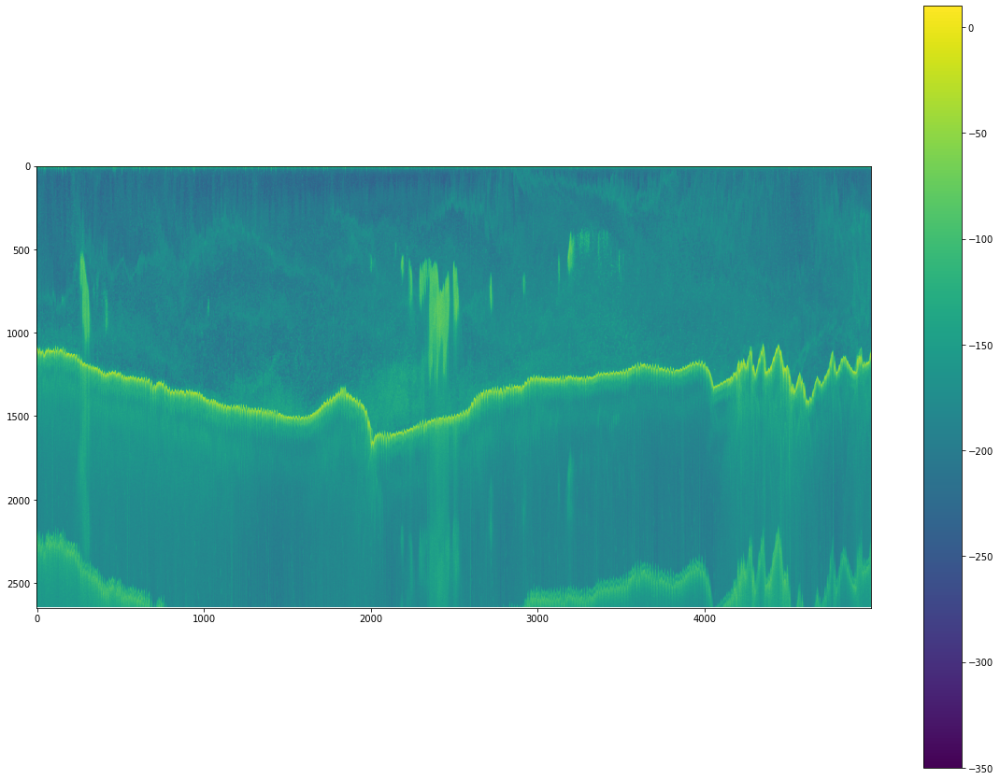

In [101]:
df = data.sv[0, 100000:105000, :] # Portion of dataset

plt.figure(figsize = (20, 15))
plt.imshow(20*np.log10(df.T.astype(float)), vmin = -350, vmax = 10)
plt.colorbar()

In [19]:
# Datashader on same dataset

hv_dataset_large = hv.Dataset(df, vdims=value_dimension, kdims=key_dimensions)
hv_image_large = hv.Image(hv_dataset_large).opts(width=800, height=500) #.opts(tools=[custom_hover])
hv.extension('bokeh', logo=False)
hv_dyn_large = hd.regrid(hv_image_large)
#hv_combined_large = hv_tiles_osm  * hv_dyn_large
#hv_combined_large
hv_dyn_large

:DynamicMap   []
   :Image   [ping_time,range]   (sv)

In [102]:
df6 = data.sv[:, 100000:103000, 0:2000]

def image_to_pandas(data):
    df = pd.DataFrame([np.array(data[0,:,:]).flatten(),
                       np.array(data[1,:,:]).flatten(),
                       np.array(data[2,:,:]).flatten(),
                       np.array(data[3,:,:]).flatten(),
                       np.array(data[4,:,:]).flatten()]).T
    df.columns = [int(data.frequency[0].values/1000),int(data.frequency[1].values/1000),int(data.frequency[2].values/1000),
                 int(data.frequency[3].values/1000), int(data.frequency[4].values/1000)]
    return df

df_pd = image_to_pandas(df6)

In [230]:
df_pd.isna().sum()
df_pd.head()

,38,18,70,120,200
0,6.430488,1.069094,15.537042,48.527451,106.316246
1,42.793007,17.432793,86.474510,189.950424,484.287140
2,44.808769,16.424692,86.240692,188.924606,480.369110
3,44.846088,16.207729,85.926376,189.952515,482.230011
4,6.855085,2.332829,17.707928,49.725548,118.431244


In [229]:
df_pd.info()
df_pd.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6000000 entries, 0 to 5999999
Data columns (total 5 columns):
 #   Column  Dtype  
---  ------  -----  
 0   38      float64
 1   18      float64
 2   70      float64
 3   120     float64
 4   200     float64
dtypes: float64(5)
memory usage: 228.9 MB


,38,18,70,120,200
count,6.000000e+06,6.000000e+06,6.000000e+06,6.000000e+06,6.000000e+06
mean,7.333292e-02,2.711954e-02,1.463465e-01,3.340284e-01,8.500304e-01
std,1.725393e+00,6.480213e-01,3.380723e+00,7.508130e+00,1.932421e+01
min,1.061111e-17,4.713574e-16,2.664082e-16,2.458892e-17,9.464758e-16
25%,1.809197e-10,8.383193e-10,5.247467e-10,1.147245e-09,2.578989e-09
50%,1.618882e-09,7.033103e-09,2.354407e-09,4.738138e-09,1.839159e-08
75%,1.259511e-08,7.240998e-08,9.265103e-09,1.914040e-08,1.913970e-07
max,4.521185e+01,1.752745e+01,8.694405e+01,1.930636e+02,5.016368e+02


In [218]:
# Transformation

deneme = df_pd
deneme = deneme.apply(lambda x: 20*np.log10(x.astype(float))) # Bu donusum olmadan clustering yapmiyor

/home/nilsolav/.local/lib/python3.7/site-packages/skimage/io/_plugins/matplotlib_plugin.py:150: UserWarning: Low image data range; displaying image with stretched contrast.
  lo, hi, cmap = _get_display_range(image)


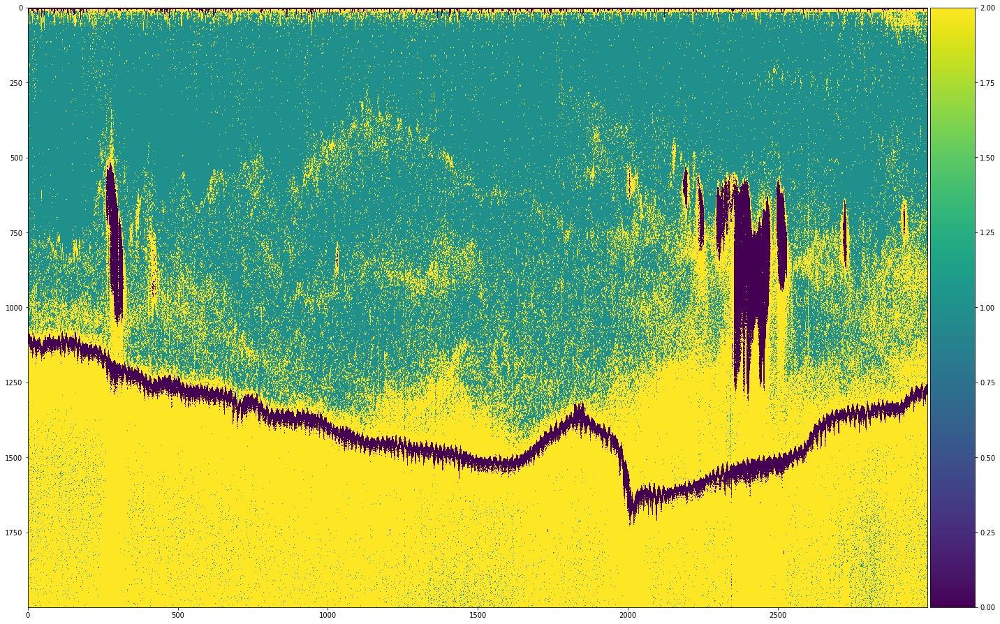

In [219]:
# K-Means Clustering Algorithm for Segmentation (Without depth information) # 4 Clusters

plt.figure(figsize=(20, 20))
kmeans = KMeans(n_clusters=  3, random_state = 42).fit(deneme)
result1 = kmeans.labels_.reshape(df6.shape[1],df6.shape[2])
imshow(result1.T, cmap='viridis')
plt.show()

/home/nilsolav/.local/lib/python3.7/site-packages/skimage/io/_plugins/matplotlib_plugin.py:150: UserWarning: Low image data range; displaying image with stretched contrast.
  lo, hi, cmap = _get_display_range(image)


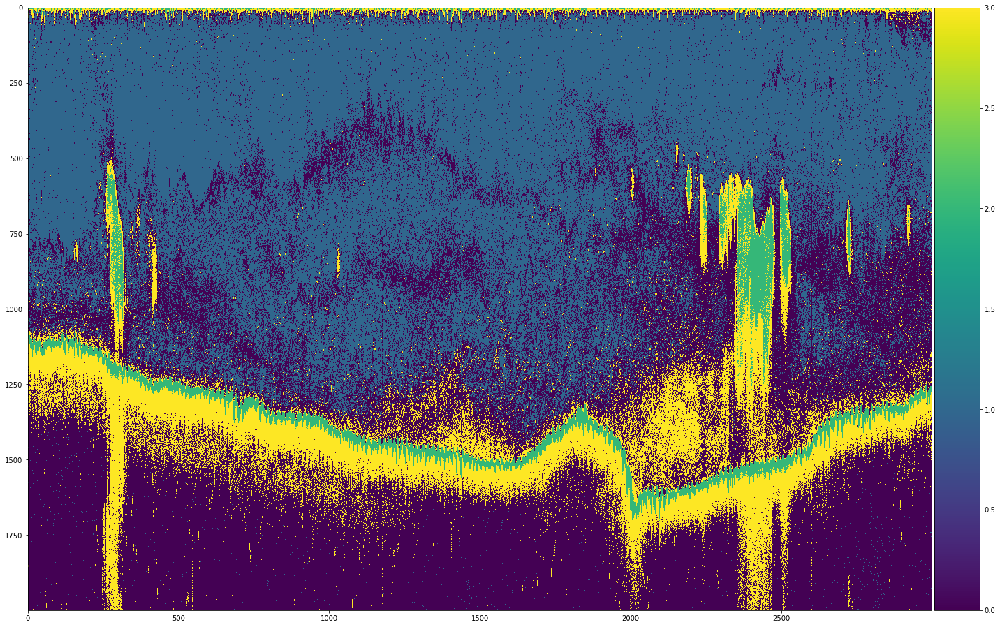

In [220]:
# K-Means Clustering Algorithm for Segmentation (Without depth information) # 4 Clusters

plt.figure(figsize=(20, 20))
kmeans = KMeans(n_clusters=  4, random_state = 42).fit(deneme)
result3 = kmeans.labels_.reshape(df6.shape[1],df6.shape[2])
imshow(result3.T, cmap='viridis')
plt.show()

/home/nilsolav/.local/lib/python3.7/site-packages/skimage/io/_plugins/matplotlib_plugin.py:150: UserWarning: Low image data range; displaying image with stretched contrast.
  lo, hi, cmap = _get_display_range(image)


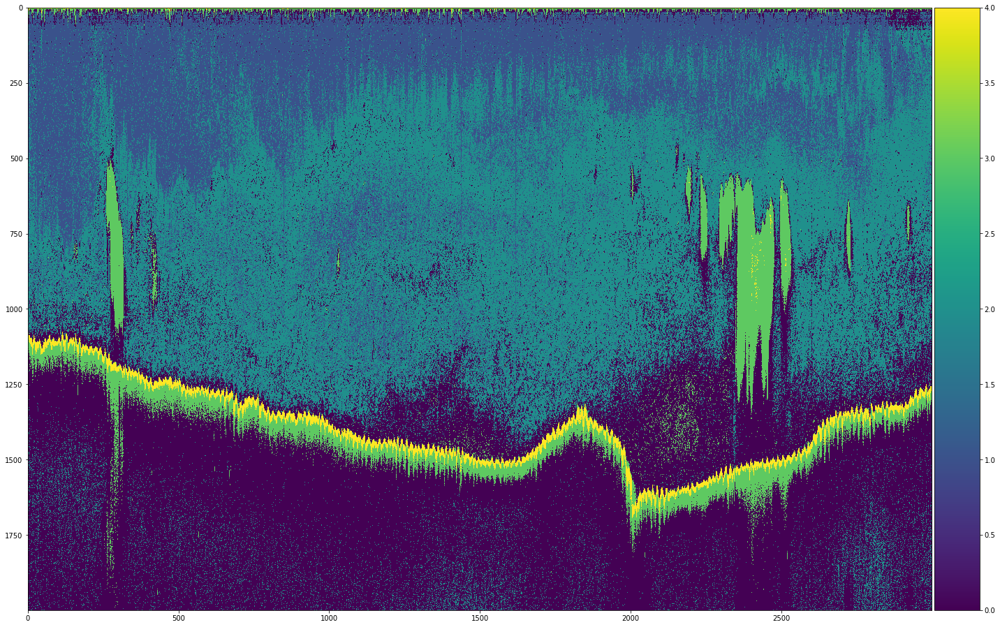

In [221]:
# K-Means Clustering Algorithm for Segmentation (Without depth information) # 5 Clusters

plt.figure(figsize=(20, 20))
kmeans = KMeans(n_clusters=  5, random_state = 42).fit(deneme)
result5 = kmeans.labels_.reshape(df6.shape[1],df6.shape[2])
imshow(result5.T, cmap='viridis')
plt.show()

# Adding Depth Information as Another Channel

In [222]:
# Creating depth array
sample = np.array(range(2000))
depth = np.tile(sample, (3000, 1)).T
deneme_d = deneme
deneme_d["depth"] = depth.T.flatten()

/home/nilsolav/.local/lib/python3.7/site-packages/sklearn/utils/validation.py:1692: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  FutureWarning,
/home/nilsolav/.local/lib/python3.7/site-packages/skimage/io/_plugins/matplotlib_plugin.py:150: UserWarning: Low image data range; displaying image with stretched contrast.
  lo, hi, cmap = _get_display_range(image)


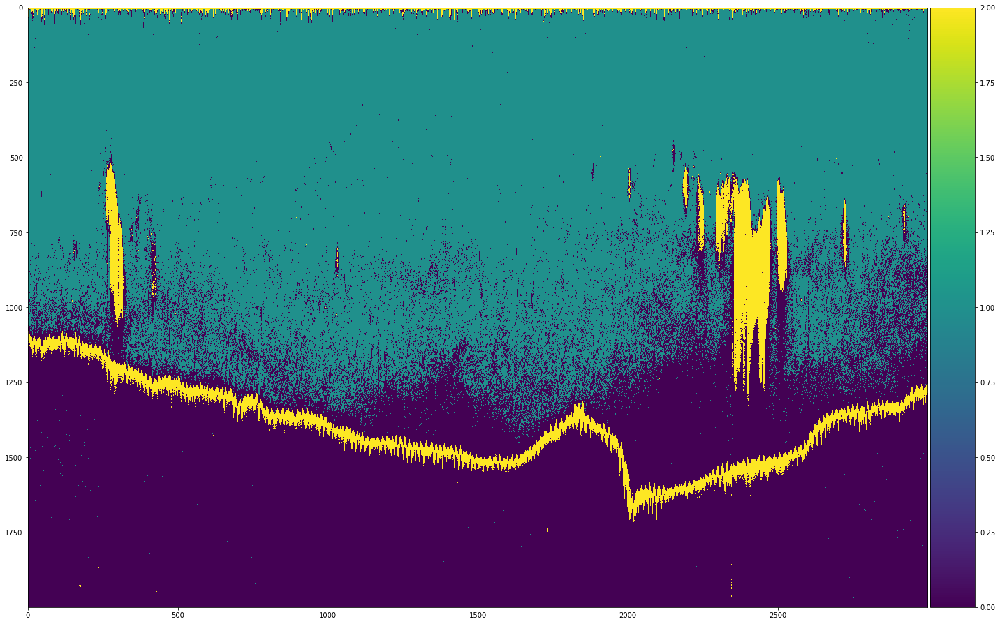

In [223]:
# K-Means Clustering Algorithm for Segmentation (With depth information) # 3 Clusters

# Normalization
normalized_df=(deneme_d-deneme_d.mean())/deneme_d.std() # Because we add another high ranged array to dataset

plt.figure(figsize=(20, 20))
kmeans = KMeans(n_clusters=  3, random_state = 42).fit(normalized_df)
result2 = kmeans.labels_.reshape(df6.shape[1],df6.shape[2])
imshow(result2.T, cmap='viridis')
plt.show()

/home/nilsolav/.local/lib/python3.7/site-packages/sklearn/utils/validation.py:1692: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  FutureWarning,
/home/nilsolav/.local/lib/python3.7/site-packages/skimage/io/_plugins/matplotlib_plugin.py:150: UserWarning: Low image data range; displaying image with stretched contrast.
  lo, hi, cmap = _get_display_range(image)


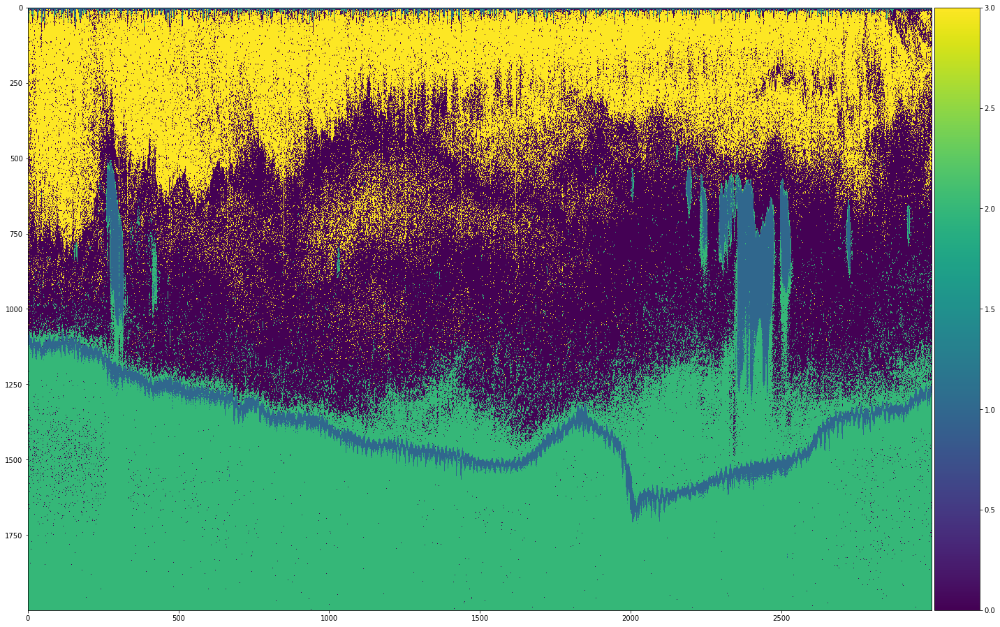

In [224]:
plt.figure(figsize=(20, 20))
kmeans = KMeans(n_clusters=  4, random_state = 42).fit(normalized_df)
result4 = kmeans.labels_.reshape(df6.shape[1],df6.shape[2])
imshow(result4.T, cmap='viridis')
plt.show()

/home/nilsolav/.local/lib/python3.7/site-packages/sklearn/utils/validation.py:1692: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['int', 'str']. An error will be raised in 1.2.
  FutureWarning,
/home/nilsolav/.local/lib/python3.7/site-packages/skimage/io/_plugins/matplotlib_plugin.py:150: UserWarning: Low image data range; displaying image with stretched contrast.
  lo, hi, cmap = _get_display_range(image)


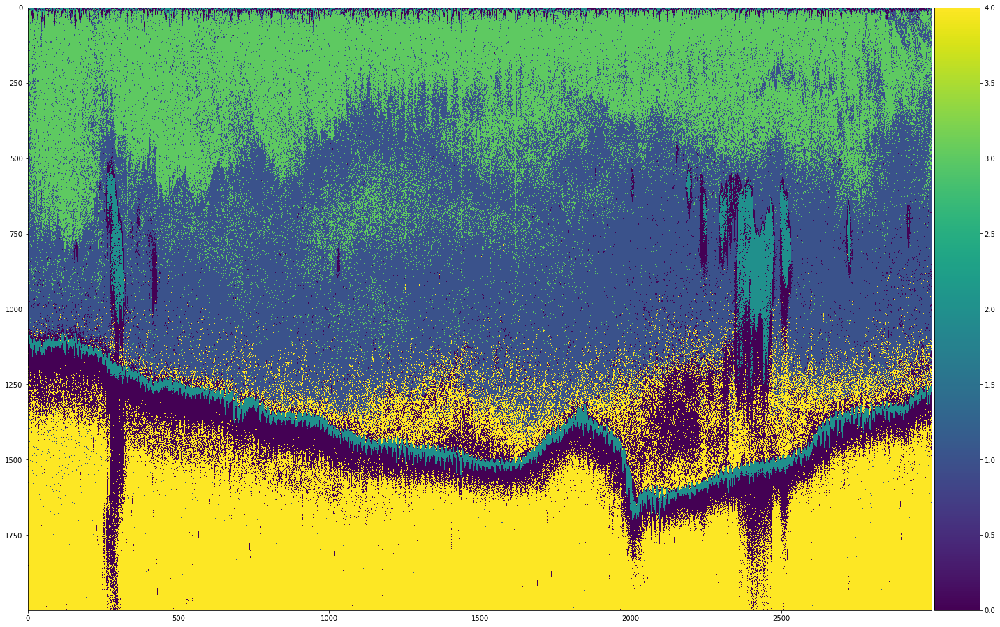

In [225]:
plt.figure(figsize=(20, 20))
kmeans = KMeans(n_clusters=  5, random_state = 42).fit(normalized_df)
result6 = kmeans.labels_.reshape(df6.shape[1],df6.shape[2])
imshow(result6.T, cmap='viridis')
plt.show()

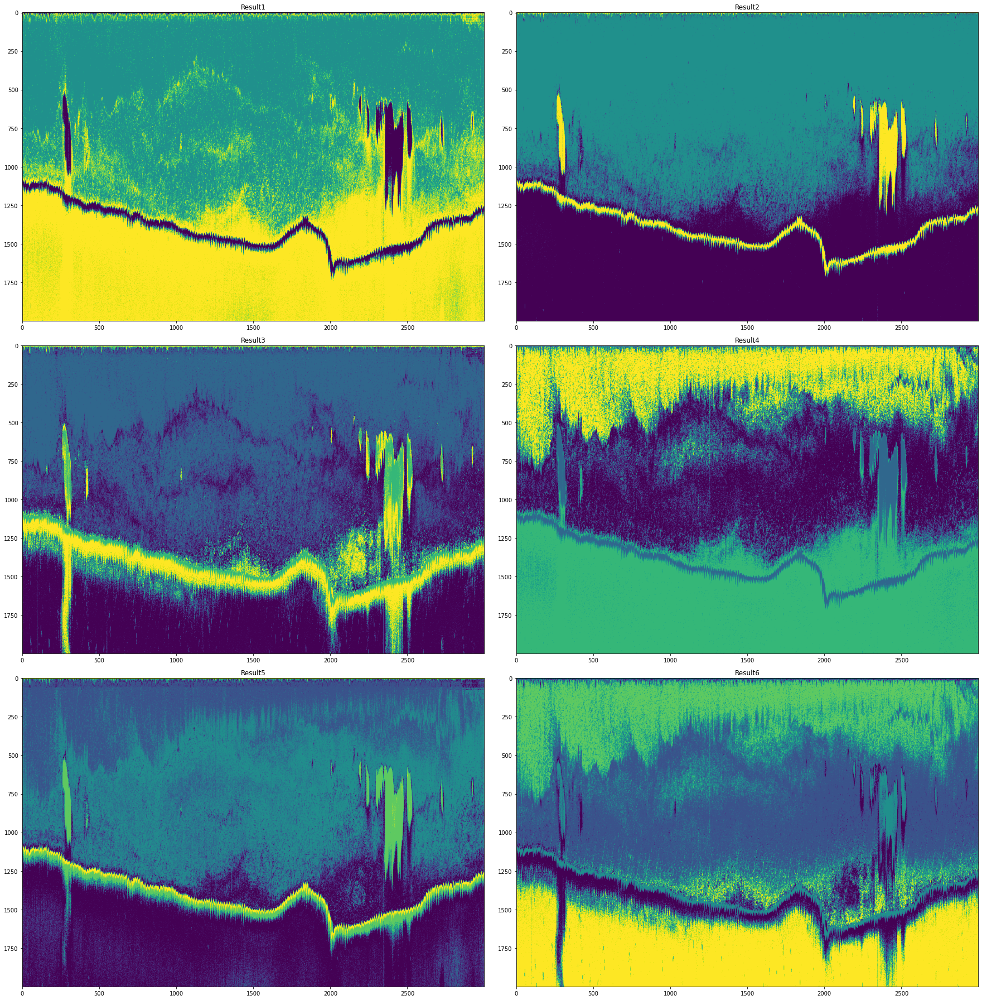

In [227]:
width=5
height=5
rows = 3
cols = 2
axes=[]
fig=plt.figure(figsize = (25, 25))

for a in range(rows*cols):
    axes.append( fig.add_subplot(rows, cols, int(a +1)))
    subplot_title=("Result"+str(a+1))
    axes[-1].set_title(subplot_title)  
    plt.imshow(globals()["result"+str(a+1)].T, cmap='viridis')
fig.tight_layout()    
plt.show()

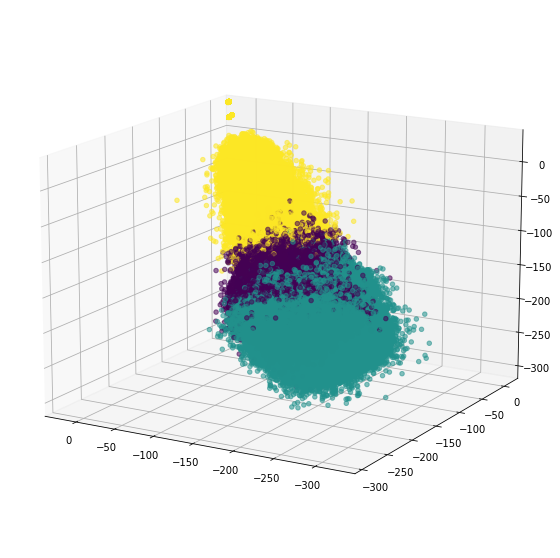

In [237]:
# Visual Representations of Clusters in 3D Space

deneme_dc = deneme_d
deneme_dc['cluster'] = result2.flatten()

def pixel_plotter_clusters(df):
    x_3d = df[38]
    y_3d = df[18]
    z_3d = df[70]
    
    fig = plt.figure(figsize=(12,10))
    ax_3d = plt.axes(projection='3d')
    ax_3d.scatter3D(xs = x_3d, ys =  y_3d, zs = z_3d, 
                    c = df['cluster'], alpha = 0.55);
    
    ax_3d.set_xlim3d(x_3d.min(), x_3d.max())
    ax_3d.set_ylim3d(y_3d.min(), y_3d.max())
    ax_3d.set_zlim3d(z_3d.min(), z_3d.max())
    ax_3d.invert_zaxis()   
    
    ax_3d.view_init(-165, 60)
    
pixel_plotter_clusters(deneme_dc)

In [249]:
# TSNE Plot of All Variables

from sklearn.manifold import TSNE
import seaborn as sns

normalized_deneme = normalized_df
normalized_deneme['cluster'] = result2.flatten()

tsne = TSNE(n_components=2, verbose=1, random_state=123)
z = tsne.fit_transform(normalized_deneme.drop(["depth", "cluster"], axis = 1))
                       
normalized_deneme["comp-1"] = z[:,0]
normalized_deneme["comp-2"] = z[:,1]


/home/nilsolav/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,
/home/nilsolav/.local/lib/python3.7/site-packages/sklearn/manifold/_t_sne.py:793: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  FutureWarning,


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 6000000 samples in 19.778s...
[t-SNE] Computed neighbors for 6000000 samples in 1114.805s...
[t-SNE] Computed conditional probabilities for sample 1000 / 6000000
[t-SNE] Computed conditional probabilities for sample 2000 / 6000000
[t-SNE] Computed conditional probabilities for sample 3000 / 6000000
[t-SNE] Computed conditional probabilities for sample 4000 / 6000000
[t-SNE] Computed conditional probabilities for sample 5000 / 6000000
[t-SNE] Computed conditional probabilities for sample 6000 / 6000000
[t-SNE] Computed conditional probabilities for sample 7000 / 6000000
[t-SNE] Computed conditional probabilities for sample 8000 / 6000000
[t-SNE] Computed conditional probabilities for sample 9000 / 6000000
[t-SNE] Computed conditional probabilities for sample 10000 / 6000000
[t-SNE] Computed conditional probabilities for sample 11000 / 6000000
[t-SNE] Computed conditional probabilities for sample 12000 / 6000000
[t-SNE] Computed c

NameError: name 'sns' is not defined

(array([-1.0e-04, -7.5e-05, -5.0e-05, -2.5e-05,  0.0e+00,  2.5e-05,
         5.0e-05,  7.5e-05,  1.0e-04]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

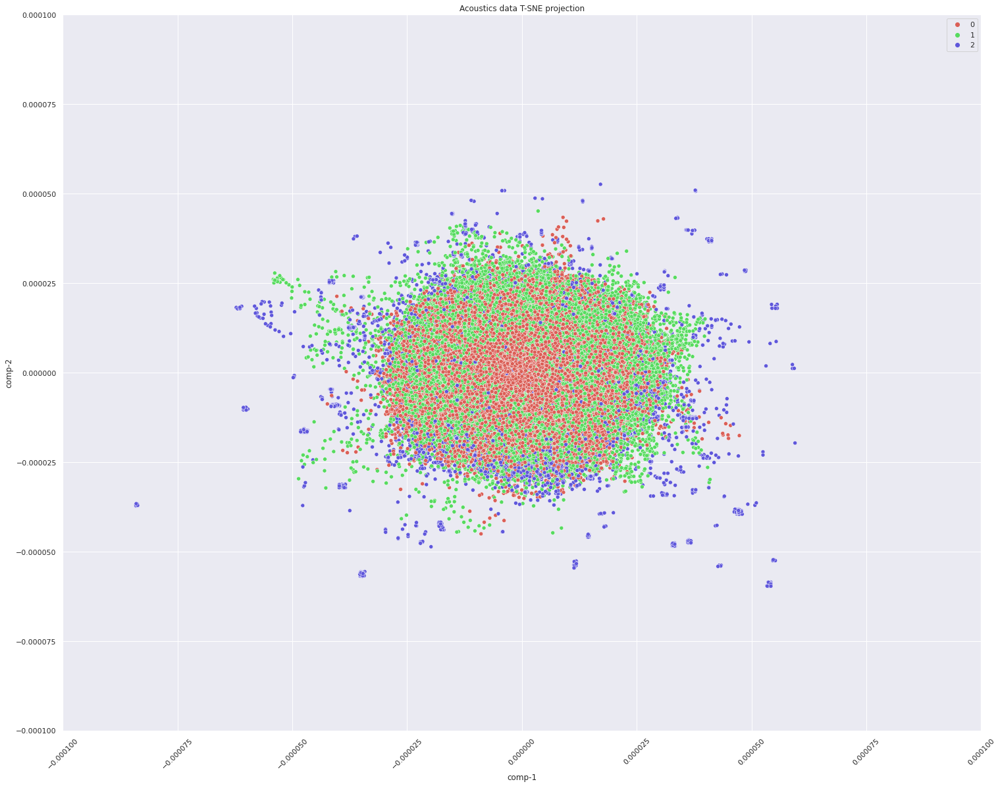

In [255]:
plt.figure(figsize = (25,20))
sns.scatterplot(x = "comp-1", y = "comp-2", hue = normalized_deneme["cluster"].tolist(),
                    palette = sns.color_palette("hls", 3),
                    data = normalized_deneme).set(title = "Acoustics data T-SNE projection",
                                                 ylim=(-0.0001,0.0001), xlim = (-0.0001,0.0001))
plt.xticks(rotation=45)


# Averaging over Schools

/opt/conda/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/opt/conda/lib/python3.7/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/opt/conda/lib/python3.7/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


Species=Other; ID=17; N=0.0; m_sv38=nan; m_r18=nan; m_r70=nan


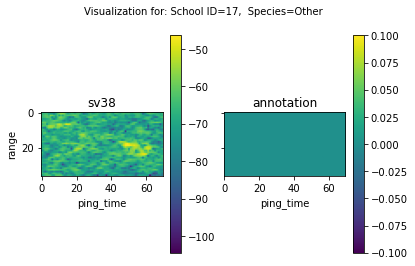

/opt/conda/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/opt/conda/lib/python3.7/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/opt/conda/lib/python3.7/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


Species=Other; ID=18; N=0.0; m_sv38=nan; m_r18=nan; m_r70=nan


/opt/conda/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/opt/conda/lib/python3.7/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/opt/conda/lib/python3.7/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


Species=Other; ID=19; N=0.0; m_sv38=nan; m_r18=nan; m_r70=nan


/opt/conda/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/opt/conda/lib/python3.7/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/opt/conda/lib/python3.7/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in true_divide
  ret = ret.dtype.type(ret / rcount)


Species=Other; ID=20; N=0.0; m_sv38=nan; m_r18=nan; m_r70=nan
Species=Other; ID=25; N=41.0; m_sv38=2.8091375e-07; m_r18=11.151987; m_r70=1.1749973
Species=Other; ID=26; N=35.0; m_sv38=3.3042309e-06; m_r18=4.451708; m_r70=2.0393474
Species=Other; ID=27; N=197.0; m_sv38=1.2195291e-05; m_r18=5.4991646; m_r70=1.8636341
Species=Other; ID=28; N=104.0; m_sv38=4.0415207e-06; m_r18=7.870353; m_r70=7.2157464
Species=Other; ID=29; N=103.0; m_sv38=4.29137e-08; m_r18=11.824016; m_r70=3.7293904
Species=Other; ID=31; N=69.0; m_sv38=2.4607672e-08; m_r18=52.059875; m_r70=17.976902
Species=Other; ID=32; N=70.0; m_sv38=7.3135566e-06; m_r18=21.3324; m_r70=27.430069


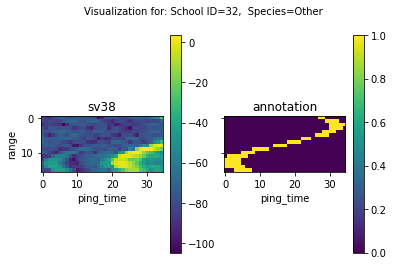

Species=Sandeel; ID=36; N=43.0; m_sv38=2.1685317e-07; m_r18=1.8324221; m_r70=3.3170986
Species=Other; ID=37; N=134.0; m_sv38=1.4056052e-06; m_r18=22.44932; m_r70=3.4758682
Species=Other; ID=38; N=539.0; m_sv38=3.2385553e-05; m_r18=8.89319; m_r70=3.7558444
Species=Other; ID=39; N=95.0; m_sv38=2.2451204e-06; m_r18=10.6316595; m_r70=45.62765
Species=Other; ID=41; N=21.0; m_sv38=2.3760894e-08; m_r18=15.21157; m_r70=0.93415815
Species=Other; ID=42; N=121.0; m_sv38=3.2054796e-08; m_r18=103.85593; m_r70=44.264206
Species=Other; ID=43; N=184.0; m_sv38=3.3790732e-07; m_r18=28.95464; m_r70=4.861972
Species=Other; ID=44; N=53.0; m_sv38=2.405309e-07; m_r18=25.291393; m_r70=9.870382
Species=Other; ID=45; N=21.0; m_sv38=2.6264416e-07; m_r18=8.156505; m_r70=1.6461158
Species=Other; ID=46; N=45.0; m_sv38=2.5850733e-07; m_r18=8.303579; m_r70=1.5601685


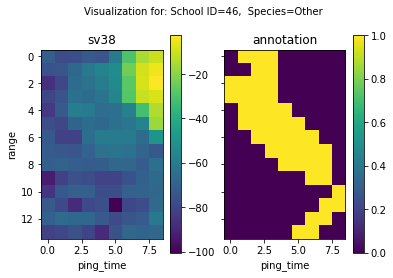

Species=Other; ID=47; N=126.0; m_sv38=2.550078e-07; m_r18=55.755066; m_r70=2.2871163
Species=Other; ID=48; N=179.0; m_sv38=1.6555244e-06; m_r18=16.954514; m_r70=10.379312
Species=Other; ID=49; N=36.0; m_sv38=1.6884046e-06; m_r18=6.8925734; m_r70=2.7193706
Species=Other; ID=50; N=58.0; m_sv38=6.820966e-08; m_r18=11.269234; m_r70=0.6755992
Species=Other; ID=51; N=129.0; m_sv38=9.691206e-07; m_r18=68.65493; m_r70=5.2885375
Species=Other; ID=52; N=42.0; m_sv38=2.4083081e-07; m_r18=59.696053; m_r70=1.6504455
Species=Other; ID=53; N=107.0; m_sv38=8.9184437e-07; m_r18=26.431559; m_r70=17.959776
Species=Sandeel; ID=54; N=44.0; m_sv38=2.5529704e-07; m_r18=0.51943547; m_r70=1.5049896
Species=Other; ID=55; N=75.0; m_sv38=4.3214227e-06; m_r18=10.312155; m_r70=5.8381934
Species=Other; ID=56; N=34.0; m_sv38=8.0619475e-06; m_r18=78.28193; m_r70=5.6723037


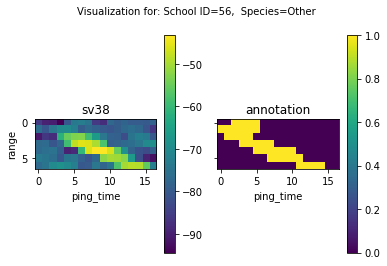

Species=Other; ID=57; N=36.0; m_sv38=1.074562e-06; m_r18=4.6062217; m_r70=1.1337303
Species=Other; ID=58; N=128.0; m_sv38=1.9700299e-06; m_r18=62.10577; m_r70=9.661944
Species=Other; ID=60; N=61.0; m_sv38=1.0824645e-06; m_r18=78.162476; m_r70=78.94794
Species=Other; ID=61; N=107.0; m_sv38=2.2588323e-07; m_r18=50.77646; m_r70=23.543257
Species=Other; ID=62; N=139.0; m_sv38=5.843471e-07; m_r18=16.328514; m_r70=2.1648414
Species=Other; ID=63; N=101.0; m_sv38=9.440701e-07; m_r18=4.9320436; m_r70=2.014989
Species=Other; ID=64; N=59.0; m_sv38=1.4647532e-06; m_r18=10.512729; m_r70=5.9621873
Species=Other; ID=65; N=27.0; m_sv38=4.8517967e-07; m_r18=14.660797; m_r70=2.3471355
Species=Other; ID=66; N=162.0; m_sv38=2.0856955e-05; m_r18=90.42439; m_r70=56.772167
Species=Other; ID=67; N=40.0; m_sv38=5.382697e-07; m_r18=17.908482; m_r70=3.1245694


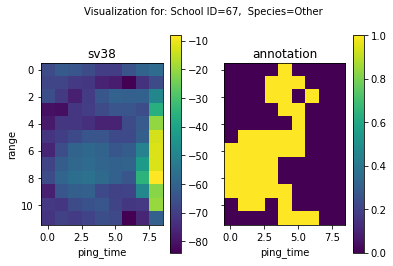

Species=Other; ID=68; N=69.0; m_sv38=1.3650957e-05; m_r18=9.358745; m_r70=1.9187565
Species=Other; ID=69; N=54.0; m_sv38=2.3474191e-08; m_r18=8.080606; m_r70=4.2344413
Species=Sandeel; ID=70; N=40.0; m_sv38=7.027127e-07; m_r18=13.166319; m_r70=4.406784
Species=Sandeel; ID=71; N=38.0; m_sv38=8.248763e-07; m_r18=2.3786209; m_r70=2.0905676
Species=Other; ID=72; N=47.0; m_sv38=2.3736837e-07; m_r18=108.71379; m_r70=39.233395
Species=Other; ID=73; N=130.0; m_sv38=3.0077572e-08; m_r18=244.1589; m_r70=20.027252
Species=Other; ID=74; N=177.0; m_sv38=1.4295716e-07; m_r18=12.477502; m_r70=9.091659
Species=Sandeel; ID=76; N=108.0; m_sv38=1.1429022e-07; m_r18=1.4144729; m_r70=2.227712
Species=Other; ID=78; N=61.0; m_sv38=1.7121661e-07; m_r18=4.595817; m_r70=4.2293596
Species=Other; ID=79; N=98.0; m_sv38=8.253715e-08; m_r18=7.71592; m_r70=3.175841


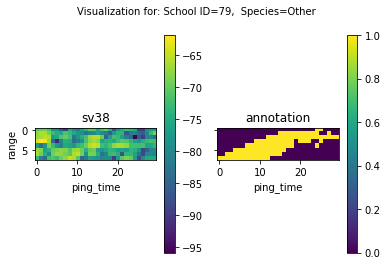

Species=Other; ID=80; N=52.0; m_sv38=5.33287e-08; m_r18=4.1662836; m_r70=1.6979886
Species=Other; ID=81; N=76.0; m_sv38=9.642046e-06; m_r18=1.230644; m_r70=1.6550014
Species=Sandeel; ID=82; N=30.0; m_sv38=4.848393e-07; m_r18=0.9184667; m_r70=1.0790203
Species=Other; ID=83; N=179.0; m_sv38=4.1141666e-06; m_r18=6.482439; m_r70=2.4307218
Species=Other; ID=84; N=61.0; m_sv38=1.3840037e-06; m_r18=27.000584; m_r70=0.9824326
Species=Sandeel; ID=86; N=73.0; m_sv38=1.8693294e-05; m_r18=3.3587198; m_r70=2.5414517
Species=Other; ID=87; N=150.0; m_sv38=1.5607868e-05; m_r18=16.949926; m_r70=6.2589383
Species=Other; ID=88; N=104.0; m_sv38=5.7912626e-08; m_r18=18.115337; m_r70=0.80995154
Species=Sandeel; ID=92; N=52.0; m_sv38=4.0816225e-08; m_r18=2.7619808; m_r70=3.8126984
Species=Sandeel; ID=93; N=53.0; m_sv38=2.9993416e-08; m_r18=2.2367105; m_r70=2.4063156


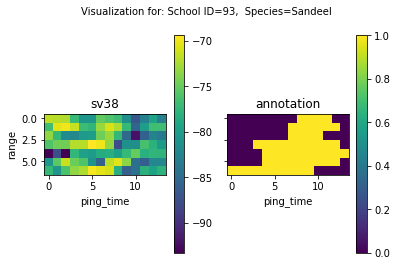

Species=Other; ID=94; N=26.0; m_sv38=1.0345221e-06; m_r18=1.6444937; m_r70=1.8477969
Species=Other; ID=95; N=11.0; m_sv38=2.1160677e-07; m_r18=0.88037246; m_r70=0.32798573
Species=Other; ID=96; N=102.0; m_sv38=2.3675013e-07; m_r18=9.718338; m_r70=3.7882748
Species=Sandeel; ID=97; N=70.0; m_sv38=7.765687e-07; m_r18=1.3212389; m_r70=1.6379447
Species=Sandeel; ID=98; N=55.0; m_sv38=5.576891e-07; m_r18=1.2555202; m_r70=3.4573753
Species=Sandeel; ID=99; N=144.0; m_sv38=1.2950119e-06; m_r18=0.4114499; m_r70=0.62290037
Species=Other; ID=100; N=19.0; m_sv38=2.1681835e-07; m_r18=19.85028; m_r70=0.91913337
Species=Sandeel; ID=101; N=21.0; m_sv38=3.55722e-07; m_r18=0.94171834; m_r70=2.7435956
Species=Sandeel; ID=102; N=194.0; m_sv38=1.2218566e-06; m_r18=0.6421919; m_r70=0.7850418
Species=Sandeel; ID=103; N=34.0; m_sv38=8.029092e-07; m_r18=2.9413805; m_r70=8.484743


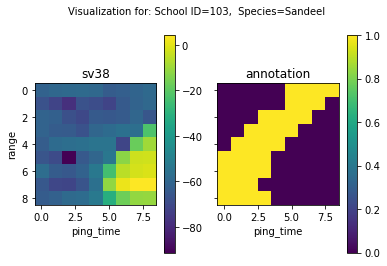

Species=Sandeel; ID=104; N=175.0; m_sv38=3.472545e-06; m_r18=0.59607273; m_r70=0.5012781
Species=Sandeel; ID=105; N=56.0; m_sv38=1.1719069e-06; m_r18=0.28298834; m_r70=1.5543976
Species=Other; ID=106; N=63.0; m_sv38=4.875893e-07; m_r18=3.3098357; m_r70=0.9177234
Species=Sandeel; ID=108; N=152.0; m_sv38=1.7982146e-06; m_r18=4.449675; m_r70=2.053734
Species=Other; ID=109; N=211.0; m_sv38=6.411803e-07; m_r18=5.7020516; m_r70=3.3729565
Species=Other; ID=110; N=175.0; m_sv38=1.8660786e-07; m_r18=4.2658515; m_r70=3.1931448
Species=Other; ID=111; N=1480.0; m_sv38=4.275581e-07; m_r18=8.663578; m_r70=4.745032
Species=Other; ID=112; N=570.0; m_sv38=4.5554225e-07; m_r18=4.8748765; m_r70=2.759286
Species=Other; ID=113; N=361.0; m_sv38=6.862214e-07; m_r18=7.643993; m_r70=2.2950294
Species=Other; ID=114; N=325.0; m_sv38=8.108438e-07; m_r18=12.752369; m_r70=2.6017559


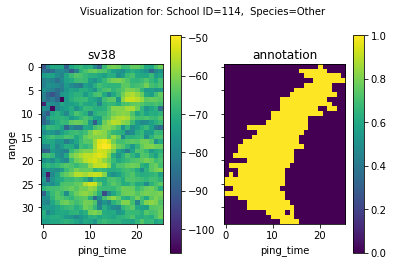

Species=Other; ID=115; N=522.0; m_sv38=4.1743233e-06; m_r18=150.65877; m_r70=1.4666115
Species=Other; ID=119; N=227.0; m_sv38=5.0407084e-07; m_r18=2.755762; m_r70=0.6681703
Species=Other; ID=120; N=417.0; m_sv38=4.1111326e-07; m_r18=2.308266; m_r70=1.1606299
Species=Other; ID=121; N=623.0; m_sv38=9.134588e-07; m_r18=1.1379153; m_r70=2.0192535
Species=Other; ID=122; N=101.0; m_sv38=1.0894927e-06; m_r18=51.699574; m_r70=0.6447216
Species=Other; ID=123; N=396.0; m_sv38=8.84799e-08; m_r18=35.89869; m_r70=13.50844
Species=Other; ID=125; N=141.0; m_sv38=2.036283e-07; m_r18=4.519491; m_r70=7.672409
Species=Other; ID=126; N=298.0; m_sv38=2.9368954e-07; m_r18=11.850285; m_r70=3.7861726
Species=Other; ID=127; N=314.0; m_sv38=3.100774e-07; m_r18=32.48059; m_r70=5.8004727
Species=Sandeel; ID=128; N=284.0; m_sv38=1.5120898e-07; m_r18=6.6716437; m_r70=5.9493437


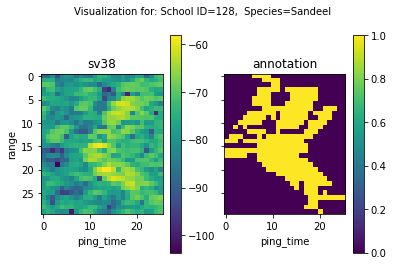

Species=Other; ID=129; N=193.0; m_sv38=1.3616826e-06; m_r18=8.65001; m_r70=1.0415803
Species=Other; ID=130; N=137.0; m_sv38=5.533286e-06; m_r18=8.994686; m_r70=3.4637203
Species=Other; ID=132; N=99.0; m_sv38=4.9655193e-07; m_r18=2.6050177; m_r70=7.5488486
Species=Other; ID=133; N=71.0; m_sv38=7.8329634e-08; m_r18=27.720638; m_r70=1.4958261
Species=Other; ID=134; N=279.0; m_sv38=7.809504e-08; m_r18=4.6994233; m_r70=8.415965
Species=Other; ID=137; N=2073.0; m_sv38=8.593791e-08; m_r18=8.898585; m_r70=18.43667
Species=Other; ID=138; N=188.0; m_sv38=1.2167136e-06; m_r18=37.942368; m_r70=2.8937755
Species=Other; ID=139; N=130.0; m_sv38=3.3140093e-06; m_r18=4.2146606; m_r70=1.728432
Species=Other; ID=140; N=127.0; m_sv38=5.095549e-07; m_r18=295.51495; m_r70=21.76402
Species=Other; ID=141; N=93.0; m_sv38=7.791627e-08; m_r18=6.667117; m_r70=2.9509032


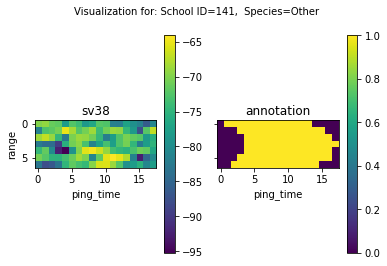

Species=Other; ID=142; N=83.0; m_sv38=8.043939e-08; m_r18=4.0555263; m_r70=1.9463205
Species=Other; ID=143; N=161.0; m_sv38=8.948848e-08; m_r18=4.1040506; m_r70=4.1401954
Species=Other; ID=144; N=191.0; m_sv38=1.1199387e-07; m_r18=17.199354; m_r70=9.671279
Species=Other; ID=145; N=127.0; m_sv38=1.3544471e-07; m_r18=3.3557997; m_r70=5.687174
Species=Other; ID=146; N=32.0; m_sv38=9.665174e-08; m_r18=5.541215; m_r70=1.105983
Species=Other; ID=147; N=63.0; m_sv38=3.3079004e-08; m_r18=15.465186; m_r70=10.716179
Species=Other; ID=148; N=350.0; m_sv38=1.4399295e-06; m_r18=38.3086; m_r70=13.84904
Species=Other; ID=149; N=537.0; m_sv38=5.062733e-07; m_r18=24.893436; m_r70=0.64412045
Species=Other; ID=150; N=208.0; m_sv38=1.1372503e-06; m_r18=10.866206; m_r70=15.47394
Species=Other; ID=151; N=402.0; m_sv38=1.0439345e-07; m_r18=19.427265; m_r70=4.076776


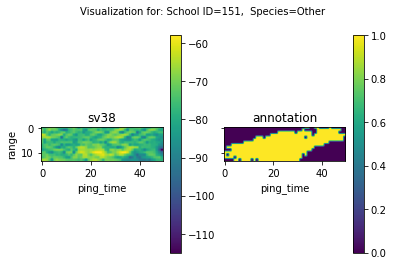

Species=Other; ID=152; N=160.0; m_sv38=2.789584e-07; m_r18=6.5865617; m_r70=2.383387
Species=Sandeel; ID=154; N=75.0; m_sv38=6.554547e-08; m_r18=2.8949163; m_r70=8.017557
Species=Sandeel; ID=155; N=117.0; m_sv38=8.19807e-08; m_r18=2.67378; m_r70=3.7569742
Species=Other; ID=157; N=35.0; m_sv38=2.1403447e-07; m_r18=4.4829; m_r70=14.776544
Species=Other; ID=158; N=136.0; m_sv38=9.132707e-06; m_r18=33.67405; m_r70=4.745638
Species=Other; ID=159; N=71.0; m_sv38=1.1436123e-06; m_r18=4.629364; m_r70=2.6831148
Species=Other; ID=160; N=155.0; m_sv38=1.4846538e-06; m_r18=57.697456; m_r70=17.342701
Species=Other; ID=161; N=166.0; m_sv38=9.349269e-07; m_r18=15.630618; m_r70=20.599064
Species=Other; ID=162; N=234.0; m_sv38=6.610318e-05; m_r18=29.031979; m_r70=7.724402
Species=Other; ID=163; N=88.0; m_sv38=8.168167e-07; m_r18=51.151608; m_r70=6.1211734


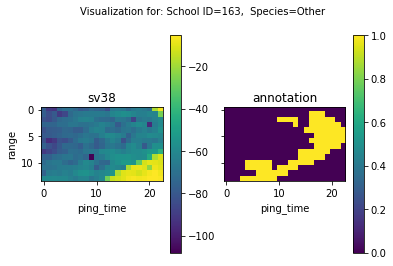

Species=Other; ID=164; N=171.0; m_sv38=2.0713796e-05; m_r18=4.586304; m_r70=2.8574464
Species=Other; ID=165; N=37.0; m_sv38=3.7883383e-06; m_r18=4.2351813; m_r70=2.4727921
Species=Other; ID=167; N=74.0; m_sv38=9.020992e-07; m_r18=31.3617; m_r70=20.560446
Species=Other; ID=168; N=146.0; m_sv38=4.4608143e-07; m_r18=28.9829; m_r70=7.6683264
Species=Other; ID=169; N=35.0; m_sv38=4.910105e-06; m_r18=3.0854497; m_r70=1.3650023
Species=Other; ID=170; N=111.0; m_sv38=1.6960368e-05; m_r18=10.385467; m_r70=2.0009778
Species=Other; ID=171; N=99.0; m_sv38=2.3975617e-05; m_r18=5.8720584; m_r70=6.5018964
Species=Other; ID=172; N=42.0; m_sv38=5.673829e-06; m_r18=0.49204913; m_r70=0.8095676
Species=Other; ID=173; N=74.0; m_sv38=2.6622129e-06; m_r18=6.9422774; m_r70=4.2084193
Species=Other; ID=176; N=401.0; m_sv38=1.0072086e-05; m_r18=57.46498; m_r70=5.4051895


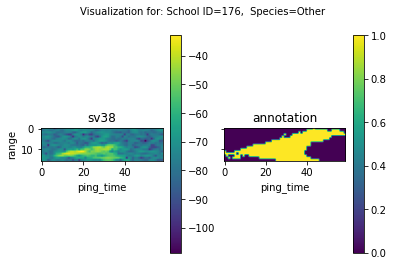

Species=Other; ID=177; N=175.0; m_sv38=5.5919384e-07; m_r18=23.047869; m_r70=9.859474
Species=Other; ID=178; N=181.0; m_sv38=1.5849422e-07; m_r18=7.1220894; m_r70=13.457152
Species=Other; ID=179; N=116.0; m_sv38=7.0586644e-08; m_r18=10.212889; m_r70=1.7916119
Species=Other; ID=180; N=349.0; m_sv38=1.0854952e-05; m_r18=15.001858; m_r70=3.6172338
Species=Other; ID=181; N=232.0; m_sv38=3.558749e-05; m_r18=5.607039; m_r70=3.1903212
Species=Other; ID=182; N=31.0; m_sv38=4.1856651e-07; m_r18=7.0027194; m_r70=1.3407134
Species=Other; ID=183; N=84.0; m_sv38=1.1354093e-05; m_r18=5.2735386; m_r70=1.6588748
Species=Other; ID=184; N=140.0; m_sv38=2.145344e-05; m_r18=53.711945; m_r70=52.519768
Species=Other; ID=185; N=86.0; m_sv38=1.9760222e-08; m_r18=11.628447; m_r70=75.98516
Species=Other; ID=186; N=85.0; m_sv38=5.4354945e-07; m_r18=18.025238; m_r70=3.249739


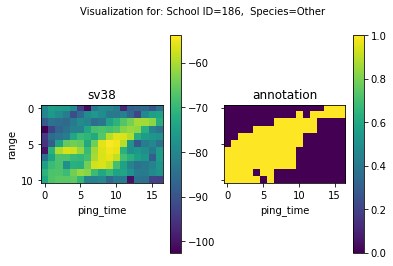

Species=Other; ID=187; N=136.0; m_sv38=1.17436805e-07; m_r18=16.507076; m_r70=3.833996
Species=Other; ID=188; N=51.0; m_sv38=1.1572481e-07; m_r18=15.796799; m_r70=4.4811335
Species=Other; ID=189; N=86.0; m_sv38=1.1371055e-07; m_r18=85.499054; m_r70=11.824409
Species=Sandeel; ID=190; N=22.0; m_sv38=1.987396e-06; m_r18=21.621946; m_r70=4.407602
Species=Other; ID=191; N=183.0; m_sv38=1.6279156e-06; m_r18=257.01593; m_r70=8.6597
Species=Sandeel; ID=192; N=14.0; m_sv38=2.3075088e-06; m_r18=29.320051; m_r70=3.2217915
Species=Other; ID=193; N=137.0; m_sv38=1.1602728e-07; m_r18=8.57703; m_r70=2.0688214
Species=Other; ID=194; N=60.0; m_sv38=5.8000246e-06; m_r18=61.983555; m_r70=4.102572
Species=Other; ID=195; N=75.0; m_sv38=6.1782384e-06; m_r18=102.19918; m_r70=7.022172
Species=Other; ID=196; N=412.0; m_sv38=4.3244774e-05; m_r18=39.7006; m_r70=5.2786107


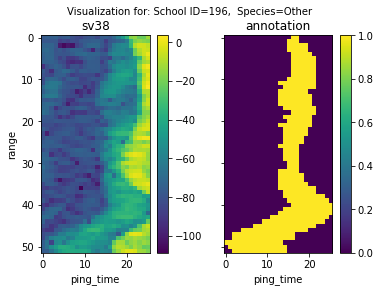

Species=Other; ID=197; N=65.0; m_sv38=1.3967282e-06; m_r18=332.37402; m_r70=2.8704093
Species=Other; ID=198; N=142.0; m_sv38=2.1655804e-07; m_r18=59.59725; m_r70=32.7286
Species=Sandeel; ID=199; N=170.0; m_sv38=2.9788268e-08; m_r18=6.861202; m_r70=11.322113
Species=Other; ID=201; N=73.0; m_sv38=1.6532672e-08; m_r18=38.27607; m_r70=8.096009
Species=Other; ID=202; N=200.0; m_sv38=2.769774e-05; m_r18=5.9222584; m_r70=3.9067264
Species=Other; ID=203; N=60.0; m_sv38=1.1273129e-07; m_r18=20.462694; m_r70=5.354592
Species=Sandeel; ID=204; N=64.0; m_sv38=2.7966458e-08; m_r18=2.7373924; m_r70=2.6099772
Species=Other; ID=205; N=155.0; m_sv38=2.512869e-07; m_r18=271.1162; m_r70=64.26532
Species=Other; ID=207; N=50.0; m_sv38=4.4394092e-08; m_r18=15.03747; m_r70=24.359837
Species=Other; ID=208; N=89.0; m_sv38=1.5507042e-07; m_r18=3.8899522; m_r70=3.8600512


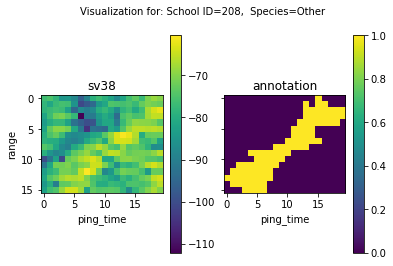

Species=Other; ID=209; N=416.0; m_sv38=2.6195206e-05; m_r18=13.566862; m_r70=2.4422305
Species=Other; ID=210; N=164.0; m_sv38=6.4498345e-05; m_r18=10.825226; m_r70=6.834913
Species=Other; ID=211; N=205.0; m_sv38=9.687885e-07; m_r18=13.388041; m_r70=3.0347867
Species=Other; ID=212; N=77.0; m_sv38=1.8255332e-07; m_r18=10.180551; m_r70=2.282687
Species=Other; ID=213; N=63.0; m_sv38=8.7206075e-07; m_r18=2.046353; m_r70=1.1158919
Species=Other; ID=216; N=269.0; m_sv38=2.0573371e-07; m_r18=7.8051877; m_r70=4.746389
Species=Other; ID=217; N=62.0; m_sv38=5.129056e-08; m_r18=5.765981; m_r70=2.5695868
Species=Other; ID=218; N=59.0; m_sv38=1.4955589e-08; m_r18=11.588316; m_r70=3.4570894
Species=Other; ID=219; N=438.0; m_sv38=1.3157644e-06; m_r18=35.63431; m_r70=3.3298852
Species=Other; ID=220; N=51.0; m_sv38=1.0692207e-07; m_r18=6.3833404; m_r70=0.5138337


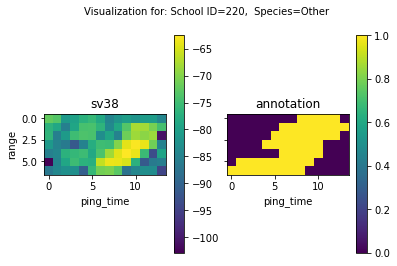

Species=Other; ID=221; N=113.0; m_sv38=1.3855072e-07; m_r18=232.99051; m_r70=2.3648355
Species=Sandeel; ID=222; N=60.0; m_sv38=1.6038885e-07; m_r18=37.924786; m_r70=31.706663
Species=Other; ID=223; N=116.0; m_sv38=1.3184572e-07; m_r18=4.912776; m_r70=2.0143404
Species=Sandeel; ID=225; N=47.0; m_sv38=1.3182532e-06; m_r18=0.6658221; m_r70=1.1334275
Species=Other; ID=226; N=309.0; m_sv38=7.982036e-08; m_r18=42.248646; m_r70=9.994671
Species=Other; ID=227; N=600.0; m_sv38=2.9248225e-05; m_r18=63.9561; m_r70=27.32852
Species=Other; ID=228; N=176.0; m_sv38=8.8418784e-07; m_r18=15.171201; m_r70=4.921097
Species=Other; ID=229; N=454.0; m_sv38=1.6754664e-05; m_r18=22.71916; m_r70=6.177367
Species=Other; ID=230; N=52.0; m_sv38=4.5329975e-07; m_r18=222.57155; m_r70=4.750415
Species=Other; ID=231; N=87.0; m_sv38=3.9367498e-07; m_r18=15.885974; m_r70=10.820688


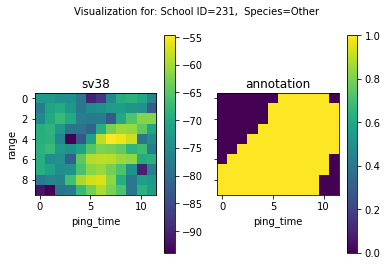

Species=Sandeel; ID=232; N=76.0; m_sv38=1.2833412e-05; m_r18=3.5689292; m_r70=8.050482
Species=Sandeel; ID=233; N=57.0; m_sv38=2.5910606e-06; m_r18=3.8592143; m_r70=3.2476435
Species=Sandeel; ID=234; N=208.0; m_sv38=1.7238095e-05; m_r18=41.187912; m_r70=4.425465
Species=Other; ID=235; N=92.0; m_sv38=3.8613738e-08; m_r18=99.09791; m_r70=3.624288
Species=Other; ID=236; N=52.0; m_sv38=3.569723e-08; m_r18=2.5615726; m_r70=1.3875872
Species=Other; ID=238; N=80.0; m_sv38=3.0004472e-05; m_r18=7.9563837; m_r70=8.6784115
Species=Other; ID=239; N=76.0; m_sv38=1.2542782e-07; m_r18=94.634445; m_r70=2.0097725
Species=Other; ID=240; N=64.0; m_sv38=4.3665925e-05; m_r18=13.903408; m_r70=6.0110345
Species=Other; ID=241; N=38.0; m_sv38=1.522078e-06; m_r18=56.2286; m_r70=50.934944
Species=Sandeel; ID=243; N=82.0; m_sv38=2.2127168e-05; m_r18=27.344046; m_r70=12.275331


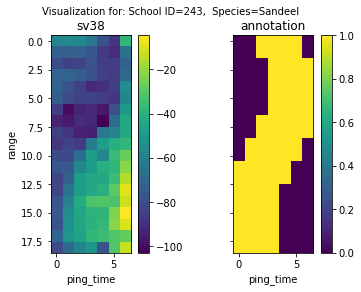

Species=Other; ID=244; N=32.0; m_sv38=1.3124506e-07; m_r18=142.65085; m_r70=82.69618
Species=Other; ID=245; N=242.0; m_sv38=1.8655134e-08; m_r18=18.12179; m_r70=12.772437
Species=Other; ID=246; N=98.0; m_sv38=5.6417033e-08; m_r18=29.207; m_r70=10.092461
Species=Other; ID=247; N=275.0; m_sv38=3.5535205e-08; m_r18=10.59197; m_r70=26.409218
Species=Other; ID=248; N=199.0; m_sv38=6.7955995e-08; m_r18=8.129815; m_r70=6.96999
Species=Other; ID=249; N=78.0; m_sv38=1.8536332e-08; m_r18=9.239695; m_r70=7.465216
Species=Other; ID=250; N=76.0; m_sv38=6.822038e-08; m_r18=16.9096; m_r70=2.1330333
Species=Other; ID=251; N=324.0; m_sv38=1.2019152e-06; m_r18=33.24802; m_r70=5.152502
Species=Other; ID=252; N=80.0; m_sv38=4.899092e-08; m_r18=6.8677354; m_r70=18.934795
Species=Sandeel; ID=254; N=44.0; m_sv38=3.408188e-07; m_r18=1.4980122; m_r70=0.825304


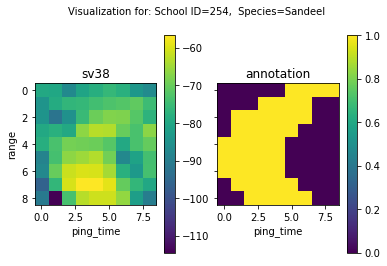

Species=Other; ID=255; N=89.0; m_sv38=9.314145e-06; m_r18=4.591445; m_r70=4.899104
Species=Sandeel; ID=256; N=42.0; m_sv38=1.5269206e-08; m_r18=1.7889175; m_r70=7.973848
Species=Other; ID=257; N=33.0; m_sv38=1.1897729e-08; m_r18=144.92448; m_r70=58.3266
Species=Other; ID=258; N=79.0; m_sv38=1.1521859e-07; m_r18=13.932594; m_r70=1.2442259
Species=Other; ID=259; N=158.0; m_sv38=4.3273534e-08; m_r18=12.451939; m_r70=3.3617547
Species=Other; ID=260; N=60.0; m_sv38=7.117976e-08; m_r18=4.523268; m_r70=10.372148
Species=Other; ID=261; N=55.0; m_sv38=4.3143546e-06; m_r18=4.8469048; m_r70=5.1553636
Species=Other; ID=262; N=109.0; m_sv38=5.7040136e-08; m_r18=2.3939588; m_r70=2.661632
Species=Other; ID=263; N=578.0; m_sv38=2.5263583e-07; m_r18=16.113495; m_r70=7.4706254
Species=Other; ID=264; N=417.0; m_sv38=2.8123402e-05; m_r18=136.98468; m_r70=3.6437066


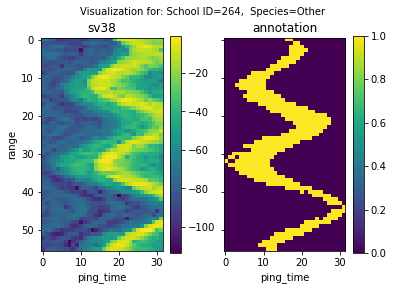

Species=Sandeel; ID=265; N=429.0; m_sv38=1.6535287e-05; m_r18=8.554209; m_r70=8.915417
Species=Other; ID=266; N=426.0; m_sv38=2.3496086e-06; m_r18=68.96703; m_r70=15.409284
Species=Other; ID=267; N=535.0; m_sv38=3.5670945e-07; m_r18=6.103242; m_r70=5.741787
Species=Sandeel; ID=268; N=182.0; m_sv38=6.597842e-08; m_r18=1.8824608; m_r70=5.1213045
Species=Other; ID=269; N=833.0; m_sv38=6.5211702e-06; m_r18=34.176422; m_r70=7.05368
Species=Sandeel; ID=270; N=1026.0; m_sv38=1.2795514e-06; m_r18=246.39742; m_r70=10.0951
Species=Sandeel; ID=271; N=424.0; m_sv38=2.2955905e-06; m_r18=104.056984; m_r70=52.433765
Species=Other; ID=272; N=405.0; m_sv38=3.4710174e-06; m_r18=21.726315; m_r70=8.045416
Species=Other; ID=273; N=172.0; m_sv38=9.4615494e-08; m_r18=9.820787; m_r70=3.546524
Species=Other; ID=274; N=318.0; m_sv38=2.890485e-07; m_r18=58.571075; m_r70=3.021723


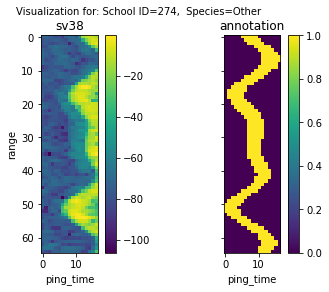

Species=Other; ID=275; N=558.0; m_sv38=1.1361111e-07; m_r18=50.048374; m_r70=4.370279
Species=Other; ID=278; N=484.0; m_sv38=3.464845e-08; m_r18=34.195274; m_r70=6.3081026
Species=Other; ID=279; N=532.0; m_sv38=7.580306e-06; m_r18=21.712576; m_r70=3.711562
Species=Other; ID=280; N=169.0; m_sv38=5.109107e-08; m_r18=56.560493; m_r70=5.799541
Species=Sandeel; ID=281; N=634.0; m_sv38=2.6013784e-06; m_r18=11.46474; m_r70=3.2037666
Species=Sandeel; ID=282; N=720.0; m_sv38=7.8924705e-07; m_r18=73.883835; m_r70=29.829376
Species=Other; ID=283; N=213.0; m_sv38=5.6563777e-06; m_r18=3.6318524; m_r70=3.8161547
Species=Other; ID=284; N=220.0; m_sv38=1.0950657e-05; m_r18=6.1684794; m_r70=1.6937554
Species=Other; ID=285; N=172.0; m_sv38=5.630827e-06; m_r18=2.3634279; m_r70=12.751064
Species=Other; ID=286; N=472.0; m_sv38=1.2148316e-05; m_r18=15.893877; m_r70=2.2524672


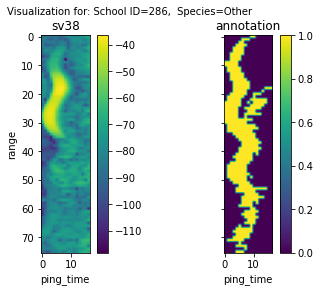

Species=Other; ID=287; N=306.0; m_sv38=1.0358353e-06; m_r18=11.945391; m_r70=2.1629922
Species=Other; ID=288; N=53.0; m_sv38=6.763128e-08; m_r18=57.786045; m_r70=1.0350682
Species=Sandeel; ID=289; N=250.0; m_sv38=1.514272e-07; m_r18=3.7719054; m_r70=11.601772
Species=Other; ID=290; N=157.0; m_sv38=7.4409336e-08; m_r18=144.62253; m_r70=0.74470925
Species=Other; ID=291; N=269.0; m_sv38=1.402708e-07; m_r18=4.812479; m_r70=4.260601
Species=Other; ID=292; N=332.0; m_sv38=3.99204e-07; m_r18=24.038307; m_r70=3.0719123
Species=Other; ID=293; N=461.0; m_sv38=2.6128621e-08; m_r18=26.154398; m_r70=5.743825
Species=Other; ID=294; N=792.0; m_sv38=2.7894774e-05; m_r18=5.3590045; m_r70=5.2737756
Species=Other; ID=295; N=110.0; m_sv38=4.503825e-06; m_r18=7.080052; m_r70=1.7860321
Species=Other; ID=296; N=72.0; m_sv38=1.4720307e-06; m_r18=10.139623; m_r70=8.619689


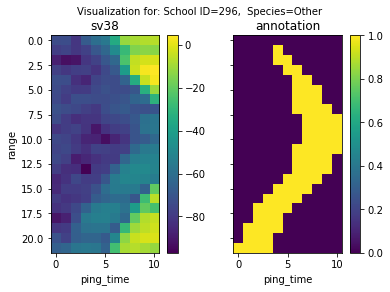

Species=Other; ID=297; N=93.0; m_sv38=1.2700197e-07; m_r18=5.5027714; m_r70=8.0606785
Species=Other; ID=298; N=146.0; m_sv38=1.0307372e-07; m_r18=10.427987; m_r70=3.3341575
Species=Other; ID=301; N=108.0; m_sv38=5.436491e-08; m_r18=12.501502; m_r70=5.886805
Species=Sandeel; ID=302; N=227.0; m_sv38=1.7173987e-07; m_r18=27.275393; m_r70=3.2165341
Species=Other; ID=303; N=220.0; m_sv38=1.8456083e-06; m_r18=41.960175; m_r70=2.9555318
Species=Other; ID=304; N=161.0; m_sv38=4.3499735e-08; m_r18=91.281235; m_r70=8.091747
Species=Other; ID=305; N=121.0; m_sv38=1.7864437e-07; m_r18=2.9645238; m_r70=9.447488
Species=Other; ID=306; N=88.0; m_sv38=2.8535783e-06; m_r18=6.1524687; m_r70=5.214203
Species=Other; ID=307; N=91.0; m_sv38=1.4266799e-06; m_r18=14.257786; m_r70=11.673534
Species=Other; ID=308; N=80.0; m_sv38=4.1403086e-07; m_r18=24.892681; m_r70=6.4547625


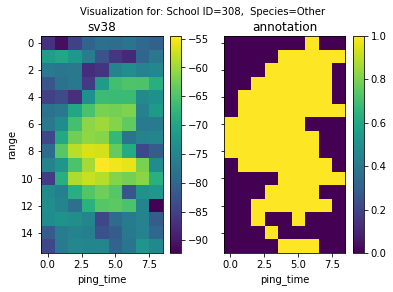

Species=Other; ID=309; N=88.0; m_sv38=3.8370104e-08; m_r18=12.14779; m_r70=7.808635
Species=Other; ID=310; N=197.0; m_sv38=5.0317544e-06; m_r18=27.26585; m_r70=16.984667
Species=Other; ID=311; N=80.0; m_sv38=1.1371849e-05; m_r18=8.024037; m_r70=3.2565262
Species=Other; ID=312; N=422.0; m_sv38=1.7591599e-06; m_r18=167.10631; m_r70=8.827926
Species=Sandeel; ID=313; N=74.0; m_sv38=1.9512431e-07; m_r18=21.949402; m_r70=18.48438
Species=Other; ID=314; N=78.0; m_sv38=9.79082e-07; m_r18=17.482996; m_r70=2.0839374
Species=Other; ID=315; N=41.0; m_sv38=1.0015297e-06; m_r18=2.8361952; m_r70=1.3201717
Species=Other; ID=316; N=56.0; m_sv38=1.7415074e-07; m_r18=8.099009; m_r70=1.7406652
Species=Other; ID=317; N=59.0; m_sv38=5.472809e-07; m_r18=9.858699; m_r70=1.6825985
Species=Other; ID=318; N=196.0; m_sv38=1.832044e-05; m_r18=13.999946; m_r70=4.791964


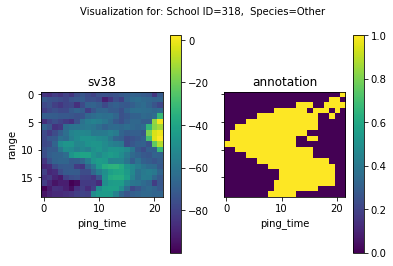

Species=Other; ID=319; N=28.0; m_sv38=4.526769e-06; m_r18=4.1326528; m_r70=5.7068133
Species=Other; ID=320; N=14.0; m_sv38=1.1360784e-06; m_r18=3.2413993; m_r70=2.2741442
Species=Other; ID=322; N=169.0; m_sv38=2.0102156e-05; m_r18=6.296527; m_r70=4.9319253
Species=Other; ID=323; N=34.0; m_sv38=6.008705e-07; m_r18=22.369719; m_r70=28.955162
Species=Other; ID=324; N=423.0; m_sv38=1.7712551e-05; m_r18=10.555154; m_r70=2.9841723
Species=Other; ID=326; N=282.0; m_sv38=1.2612311e-07; m_r18=521.9008; m_r70=2.0864012
Species=Other; ID=327; N=292.0; m_sv38=9.9286176e-08; m_r18=26.340204; m_r70=1.7741605
Species=Other; ID=328; N=209.0; m_sv38=1.2299255e-06; m_r18=9.7997; m_r70=0.82795197
Species=Other; ID=329; N=310.0; m_sv38=1.580748e-07; m_r18=13.996214; m_r70=1.163006
Species=Other; ID=330; N=119.0; m_sv38=6.195201e-08; m_r18=18.131504; m_r70=4.898935


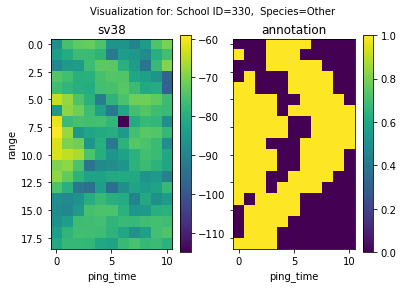

Species=Other; ID=331; N=34.0; m_sv38=3.9819565e-07; m_r18=1.9365044; m_r70=1.59159
Species=Other; ID=332; N=67.0; m_sv38=2.45973e-07; m_r18=6.459512; m_r70=0.84700257
Species=Other; ID=333; N=502.0; m_sv38=9.365759e-08; m_r18=20.779327; m_r70=2.9975796
Species=Other; ID=334; N=660.0; m_sv38=9.0675165e-08; m_r18=6.050921; m_r70=2.6398096
Species=Other; ID=335; N=99.0; m_sv38=3.897664e-07; m_r18=22.490732; m_r70=7.8126407
Species=Other; ID=336; N=144.0; m_sv38=3.3652577e-07; m_r18=5546.2324; m_r70=66.905785
Species=Other; ID=337; N=44.0; m_sv38=1.4910325e-08; m_r18=88.84354; m_r70=83.47694
Species=Other; ID=338; N=151.0; m_sv38=2.7898814e-08; m_r18=13.086024; m_r70=5.0782933
Species=Other; ID=339; N=146.0; m_sv38=9.590651e-07; m_r18=20.945936; m_r70=2.265872
Species=Other; ID=340; N=86.0; m_sv38=2.7890194e-06; m_r18=18.143826; m_r70=7.294891


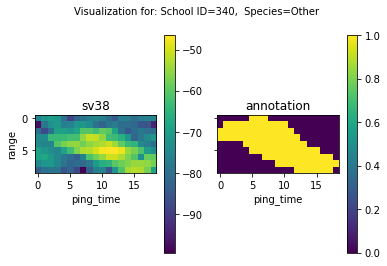

Species=Other; ID=341; N=86.0; m_sv38=6.491794e-08; m_r18=27.210585; m_r70=10.668555
Species=Other; ID=342; N=123.0; m_sv38=2.908272e-06; m_r18=7.009662; m_r70=0.8744982
Species=Other; ID=343; N=95.0; m_sv38=9.586148e-08; m_r18=9.66559; m_r70=4.477631
Species=Other; ID=344; N=96.0; m_sv38=1.530146e-05; m_r18=5.617233; m_r70=1.5779347
Species=Other; ID=345; N=537.0; m_sv38=2.8902146e-05; m_r18=26.318583; m_r70=9.9775715
Species=Other; ID=346; N=147.0; m_sv38=1.0712432e-05; m_r18=51.60917; m_r70=393.98175
Species=Other; ID=347; N=120.0; m_sv38=1.5587053e-06; m_r18=78.48546; m_r70=38.916676
Species=Other; ID=348; N=237.0; m_sv38=1.3975511e-05; m_r18=9.760219; m_r70=5.775105
Species=Other; ID=349; N=138.0; m_sv38=2.0363606e-05; m_r18=2.0954225; m_r70=13.553086
Species=Other; ID=350; N=392.0; m_sv38=1.4579746e-05; m_r18=14.921293; m_r70=7.8357506


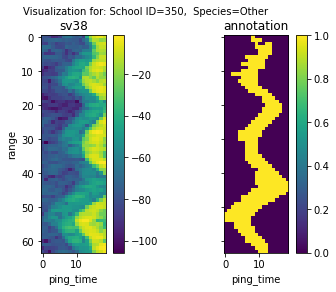

Species=Other; ID=351; N=92.0; m_sv38=5.0008526e-07; m_r18=110.61143; m_r70=21.060656
Species=Other; ID=352; N=72.0; m_sv38=4.064721e-08; m_r18=6.6956635; m_r70=13.736098
Species=Sandeel; ID=353; N=49.0; m_sv38=1.06861165e-07; m_r18=2.2024612; m_r70=2.8960273
Species=Sandeel; ID=355; N=52.0; m_sv38=1.4843116e-07; m_r18=24.960314; m_r70=8.98377
Species=Other; ID=356; N=182.0; m_sv38=1.9557203e-07; m_r18=4.431147; m_r70=3.8238156
Species=Other; ID=357; N=75.0; m_sv38=6.013537e-08; m_r18=11.051863; m_r70=2.5723174
Species=Other; ID=358; N=61.0; m_sv38=3.258156e-08; m_r18=95.00477; m_r70=5.023027
Species=Other; ID=360; N=127.0; m_sv38=1.6501264e-07; m_r18=3.1995022; m_r70=0.99422616
Species=Other; ID=361; N=78.0; m_sv38=4.8594437e-08; m_r18=15.117002; m_r70=5.1789894
Species=Other; ID=362; N=83.0; m_sv38=1.9047169e-06; m_r18=8.988115; m_r70=1.6395104


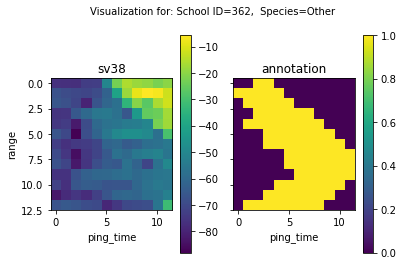

Species=Other; ID=363; N=250.0; m_sv38=2.2774119e-08; m_r18=8.741052; m_r70=37.656734
Species=Other; ID=364; N=177.0; m_sv38=6.778012e-08; m_r18=4.1770053; m_r70=2.4630814
Species=Other; ID=365; N=83.0; m_sv38=6.3879035e-08; m_r18=2.6506357; m_r70=2.3125076
Species=Other; ID=369; N=26.0; m_sv38=1.3663171e-07; m_r18=210.28165; m_r70=25.047783
Species=Other; ID=370; N=562.0; m_sv38=5.9874783e-05; m_r18=4.7188525; m_r70=6.522119
Species=Other; ID=371; N=679.0; m_sv38=1.552584e-05; m_r18=67.93723; m_r70=8.524015
Species=Other; ID=372; N=500.0; m_sv38=3.055099e-06; m_r18=13.567075; m_r70=7.0780783
Species=Other; ID=373; N=468.0; m_sv38=3.9099323e-05; m_r18=11.7448015; m_r70=9.074195
Species=Other; ID=374; N=40.0; m_sv38=1.13837e-06; m_r18=2.4585454; m_r70=1.9250456
Species=Sandeel; ID=375; N=247.0; m_sv38=1.89076e-08; m_r18=1.8243818; m_r70=34.27124


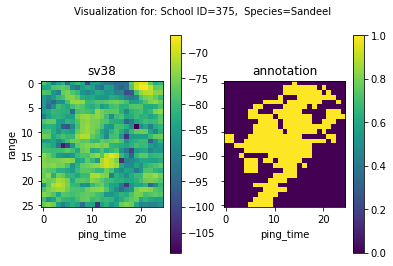

Species=Other; ID=376; N=88.0; m_sv38=4.3196135e-07; m_r18=85.184456; m_r70=3.755306
Species=Other; ID=377; N=339.0; m_sv38=9.494947e-06; m_r18=20.305243; m_r70=2.2229574
Species=Other; ID=378; N=60.0; m_sv38=6.8627025e-07; m_r18=14.755152; m_r70=6.009115
Species=Other; ID=379; N=87.0; m_sv38=2.928546e-06; m_r18=6.7981644; m_r70=0.55592424
Species=Other; ID=380; N=62.0; m_sv38=1.5286363e-05; m_r18=3.870083; m_r70=1.1493508
Species=Other; ID=381; N=239.0; m_sv38=3.266658e-08; m_r18=21.578518; m_r70=7.7723527
Species=Other; ID=382; N=68.0; m_sv38=1.4409087e-06; m_r18=18.629911; m_r70=7.6917205
Species=Other; ID=383; N=155.0; m_sv38=6.469009e-07; m_r18=18.683739; m_r70=1.254375
Species=Other; ID=384; N=94.0; m_sv38=8.456647e-07; m_r18=3.7573245; m_r70=4.7298975
Species=Other; ID=385; N=24.0; m_sv38=5.882743e-07; m_r18=1.5914451; m_r70=0.68102664


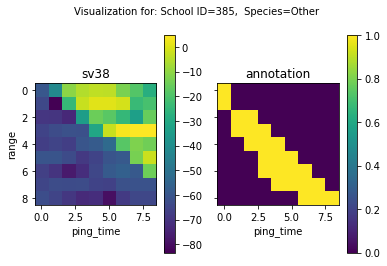

Species=Sandeel; ID=386; N=49.0; m_sv38=1.2285253e-06; m_r18=3.3749907; m_r70=1.5282068
Species=Sandeel; ID=387; N=23.0; m_sv38=4.835044e-07; m_r18=0.88434905; m_r70=1.0211769
Species=Sandeel; ID=389; N=116.0; m_sv38=1.9074024e-08; m_r18=2.8667517; m_r70=4.1351733
Species=Other; ID=390; N=65.0; m_sv38=2.3905203e-08; m_r18=30.75826; m_r70=16.994625
Species=Other; ID=391; N=35.0; m_sv38=3.8041595e-08; m_r18=1.8246905; m_r70=4.1153936
Species=Other; ID=395; N=119.0; m_sv38=7.878312e-08; m_r18=13.65629; m_r70=4.4938226
Species=Other; ID=396; N=53.0; m_sv38=2.8186508e-07; m_r18=35.58539; m_r70=0.7992976
Species=Other; ID=401; N=60.0; m_sv38=8.575553e-08; m_r18=1.3842871; m_r70=2.7743037
Species=Other; ID=402; N=151.0; m_sv38=6.2653726e-06; m_r18=18.507185; m_r70=7.849178
Species=Other; ID=403; N=190.0; m_sv38=5.285958e-06; m_r18=7.280028; m_r70=5.883887


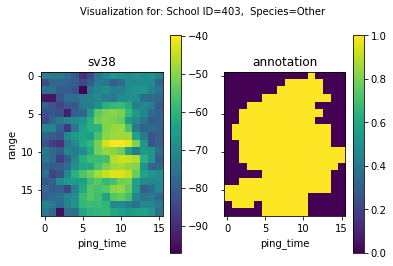

Species=Other; ID=404; N=641.0; m_sv38=3.119688e-07; m_r18=313.0396; m_r70=8.30342
Species=Other; ID=406; N=288.0; m_sv38=3.4984703e-05; m_r18=11.806479; m_r70=5.212652
Species=Other; ID=407; N=194.0; m_sv38=3.247825e-06; m_r18=92.275085; m_r70=13.301525
Species=Sandeel; ID=408; N=16.0; m_sv38=1.1099322e-07; m_r18=0.38983408; m_r70=1.2811723
Species=Other; ID=409; N=48.0; m_sv38=2.9337193e-07; m_r18=15.805248; m_r70=73.7076
Species=Other; ID=410; N=32.0; m_sv38=3.22622e-07; m_r18=2.8654394; m_r70=4.2498236
Species=Other; ID=411; N=39.0; m_sv38=2.4156468e-05; m_r18=5.994576; m_r70=2.759482
Species=Other; ID=412; N=300.0; m_sv38=3.299385e-07; m_r18=21.320677; m_r70=5.956719
Species=Other; ID=413; N=175.0; m_sv38=9.619216e-06; m_r18=5.0505557; m_r70=10.024107
Species=Other; ID=415; N=54.0; m_sv38=1.7593457e-07; m_r18=2.4081523; m_r70=1.580678


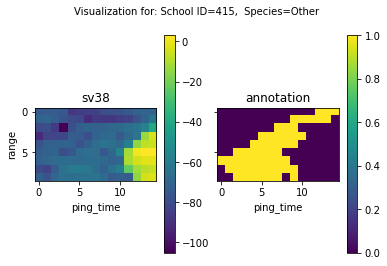

Species=Other; ID=416; N=29.0; m_sv38=5.1006276e-07; m_r18=59.39375; m_r70=0.5864469
Species=Other; ID=417; N=105.0; m_sv38=2.004923e-05; m_r18=13.094816; m_r70=2.8954253
Species=Other; ID=418; N=99.0; m_sv38=1.91633e-06; m_r18=16.008236; m_r70=3.119134
Species=Other; ID=420; N=175.0; m_sv38=7.3692854e-07; m_r18=4.1745615; m_r70=2.871346
Species=Other; ID=421; N=67.0; m_sv38=5.126316e-07; m_r18=6.7859387; m_r70=4.1385994
Species=Other; ID=422; N=149.0; m_sv38=1.1243644e-05; m_r18=31.308718; m_r70=18.17127
Species=Other; ID=423; N=36.0; m_sv38=7.4769537e-07; m_r18=7.6762075; m_r70=22.167824
Species=Other; ID=424; N=226.0; m_sv38=1.9571648e-06; m_r18=49.460926; m_r70=3.524117
Species=Other; ID=425; N=46.0; m_sv38=9.743328e-06; m_r18=1.845642; m_r70=3.5558975
Species=Other; ID=426; N=556.0; m_sv38=3.292108e-07; m_r18=11.600915; m_r70=6.33914


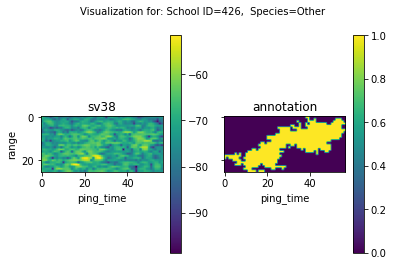

Species=Other; ID=427; N=301.0; m_sv38=1.15762845e-07; m_r18=16.927113; m_r70=8.703366
Species=Other; ID=428; N=168.0; m_sv38=4.6387733e-08; m_r18=12.352086; m_r70=10.898613
Species=Other; ID=429; N=374.0; m_sv38=3.0676267e-05; m_r18=13.875169; m_r70=9.912372
Species=Other; ID=430; N=225.0; m_sv38=6.555779e-08; m_r18=13.496682; m_r70=4.8896413
Species=Other; ID=431; N=351.0; m_sv38=1.6749671e-07; m_r18=12.860961; m_r70=3.4329188
Species=Other; ID=432; N=99.0; m_sv38=1.03898614e-07; m_r18=6.7882833; m_r70=15.955813
Species=Other; ID=433; N=323.0; m_sv38=4.9269907e-08; m_r18=26.989067; m_r70=22.207222
Species=Other; ID=434; N=556.0; m_sv38=4.8593397e-06; m_r18=98.89415; m_r70=21.138132
Species=Other; ID=435; N=50.0; m_sv38=9.801544e-07; m_r18=32.25794; m_r70=1.0713269
Species=Other; ID=436; N=184.0; m_sv38=3.0688665e-07; m_r18=156.49799; m_r70=24.40669


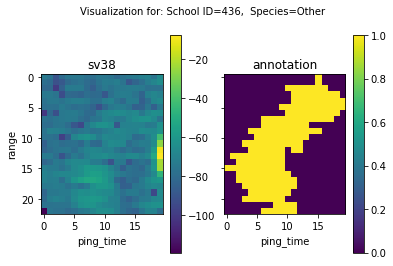

Species=Other; ID=437; N=652.0; m_sv38=6.901843e-08; m_r18=21.19798; m_r70=14.22778
Species=Other; ID=438; N=72.0; m_sv38=2.3882462e-06; m_r18=4.741888; m_r70=4.2291775
Species=Other; ID=439; N=121.0; m_sv38=4.0958864e-07; m_r18=3.4541512; m_r70=2.1646137
Species=Other; ID=440; N=71.0; m_sv38=7.764326e-08; m_r18=8.016108; m_r70=0.8427829
Species=Sandeel; ID=441; N=90.0; m_sv38=2.3209335e-08; m_r18=9.665951; m_r70=34.46521
Species=Other; ID=442; N=90.0; m_sv38=7.452233e-07; m_r18=2.7475288; m_r70=3.6044009
Species=Other; ID=443; N=49.0; m_sv38=1.8677946e-06; m_r18=3.1205845; m_r70=0.8805196
Species=Other; ID=444; N=90.0; m_sv38=5.3795436e-08; m_r18=30.153982; m_r70=4.673231
Species=Other; ID=445; N=129.0; m_sv38=2.3041247e-07; m_r18=4.0037174; m_r70=2.9211397
Species=Other; ID=446; N=283.0; m_sv38=1.4425298e-07; m_r18=19.087605; m_r70=3.4239197


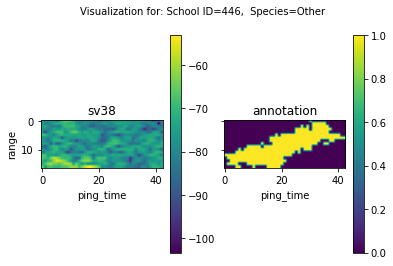

Species=Other; ID=447; N=181.0; m_sv38=1.9403564e-07; m_r18=11.076123; m_r70=3.5854533
Species=Other; ID=448; N=241.0; m_sv38=3.5537903e-07; m_r18=173.18384; m_r70=24.157885
Species=Other; ID=449; N=179.0; m_sv38=1.2506396e-07; m_r18=29.38736; m_r70=1.683356
Species=Other; ID=450; N=623.0; m_sv38=1.7849959e-07; m_r18=21.690134; m_r70=7.138959
Species=Other; ID=451; N=181.0; m_sv38=6.5935933e-07; m_r18=3.5271482; m_r70=1.9151118
Species=Other; ID=452; N=103.0; m_sv38=4.547129e-07; m_r18=7.7874827; m_r70=4.393077
Species=Other; ID=453; N=72.0; m_sv38=4.7464123e-08; m_r18=1.6782358; m_r70=2.4988136
Species=Other; ID=454; N=103.0; m_sv38=0.000100101715; m_r18=679.2928; m_r70=195.44266
Species=Other; ID=455; N=92.0; m_sv38=5.5069894e-08; m_r18=2.6773903; m_r70=11.853971
Species=Other; ID=456; N=175.0; m_sv38=3.1584796e-07; m_r18=6.8402233; m_r70=3.5894682


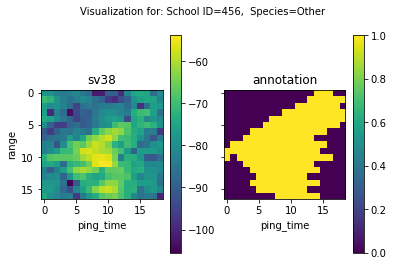

Species=Other; ID=457; N=88.0; m_sv38=1.7458507e-07; m_r18=7.8189683; m_r70=4.133087
Species=Sandeel; ID=461; N=20.0; m_sv38=1.6059523e-08; m_r18=4.4950395; m_r70=7.011068
Species=Other; ID=462; N=1093.0; m_sv38=6.04205e-05; m_r18=93.1541; m_r70=29.908718
Species=Other; ID=463; N=226.0; m_sv38=1.5752923e-05; m_r18=4.871204; m_r70=2.8404486
Species=Other; ID=464; N=192.0; m_sv38=2.1982994e-07; m_r18=2.8395684; m_r70=3.4572706
Species=Other; ID=465; N=41.0; m_sv38=1.3062141e-05; m_r18=1.012019; m_r70=3.317759
Species=Other; ID=466; N=301.0; m_sv38=7.868121e-06; m_r18=55.34227; m_r70=6.6912827
Species=Other; ID=468; N=197.0; m_sv38=2.7093181e-05; m_r18=4.643366; m_r70=3.0367453
Species=Other; ID=469; N=352.0; m_sv38=1.5755304e-05; m_r18=15.780936; m_r70=6.0940456
Species=Other; ID=470; N=232.0; m_sv38=3.823141e-05; m_r18=19.073046; m_r70=27.63983


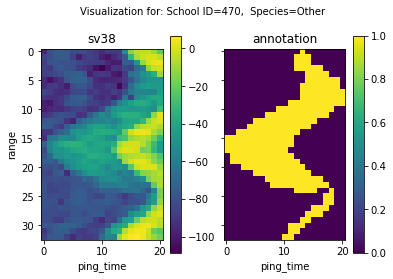

Species=Other; ID=471; N=258.0; m_sv38=7.436491e-06; m_r18=32.875217; m_r70=4.2726703
Species=Other; ID=472; N=156.0; m_sv38=1.548748e-05; m_r18=5.677855; m_r70=8.238465
Species=Other; ID=473; N=593.0; m_sv38=2.0150397e-05; m_r18=9.748677; m_r70=4.861372
Species=Other; ID=474; N=47.0; m_sv38=6.1797823e-06; m_r18=4.211176; m_r70=1.884349
Species=Sandeel; ID=475; N=25.0; m_sv38=7.8402053e-07; m_r18=0.29623112; m_r70=2.789367
Species=Other; ID=476; N=155.0; m_sv38=2.8551656e-05; m_r18=73.62657; m_r70=5.314242
Species=Other; ID=478; N=62.0; m_sv38=3.9531264e-07; m_r18=15.165799; m_r70=11.852187
Species=Other; ID=479; N=113.0; m_sv38=3.8834333e-08; m_r18=152.36896; m_r70=2.6131961
Species=Other; ID=480; N=79.0; m_sv38=7.821532e-06; m_r18=9.793952; m_r70=4.476979
Species=Other; ID=481; N=97.0; m_sv38=9.661317e-07; m_r18=35.70199; m_r70=3.3203256


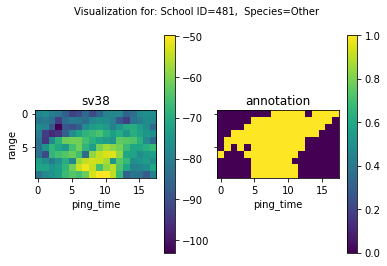

Species=Sandeel; ID=482; N=70.0; m_sv38=5.0307843e-08; m_r18=2.4974072; m_r70=9.82297
Species=Other; ID=483; N=34.0; m_sv38=1.5419037e-06; m_r18=7.5462523; m_r70=2.9121106
Species=Other; ID=484; N=45.0; m_sv38=1.4148979e-07; m_r18=22.674314; m_r70=20.375427
Species=Other; ID=485; N=61.0; m_sv38=5.2334127e-07; m_r18=2.6648185; m_r70=1.3255969
Species=Other; ID=487; N=36.0; m_sv38=2.1674431e-07; m_r18=11.536976; m_r70=2.9693246
Species=Sandeel; ID=488; N=24.0; m_sv38=5.58706e-07; m_r18=6.6159415; m_r70=6.8236637
Species=Other; ID=489; N=42.0; m_sv38=1.9602084e-07; m_r18=13.07147; m_r70=1.5615876
Species=Other; ID=490; N=46.0; m_sv38=3.0016955e-07; m_r18=1.4657991; m_r70=1.5509814
Species=Sandeel; ID=491; N=19.0; m_sv38=5.435275e-07; m_r18=2.9984224; m_r70=7.3590884
Species=Other; ID=492; N=12.0; m_sv38=4.0579256e-08; m_r18=2.5368066; m_r70=2.878555


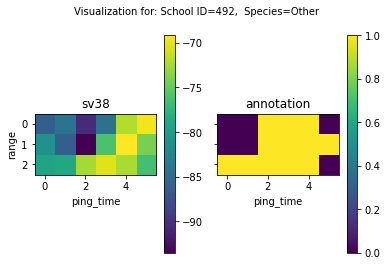

Species=Other; ID=493; N=47.0; m_sv38=4.041996e-06; m_r18=1.7706321; m_r70=7.3673906
Species=Other; ID=494; N=351.0; m_sv38=8.244092e-08; m_r18=83.42568; m_r70=20.709866
Species=Other; ID=495; N=40.0; m_sv38=8.110057e-07; m_r18=4.6756845; m_r70=0.81073856
Species=Other; ID=496; N=159.0; m_sv38=2.0200173e-07; m_r18=6.3154335; m_r70=13.120458
Species=Other; ID=497; N=15.0; m_sv38=1.2937425e-06; m_r18=1.8318437; m_r70=0.816035
Species=Sandeel; ID=498; N=48.0; m_sv38=1.3797927e-07; m_r18=0.95162183; m_r70=1.5809631
Species=Sandeel; ID=499; N=55.0; m_sv38=9.75572e-07; m_r18=3.9643896; m_r70=2.7530208
Species=Sandeel; ID=500; N=62.0; m_sv38=5.702871e-07; m_r18=1.3149198; m_r70=0.9376348
Species=Other; ID=501; N=92.0; m_sv38=9.165006e-07; m_r18=21.83842; m_r70=13.124871
Species=Other; ID=502; N=100.0; m_sv38=4.4265665e-08; m_r18=89.15953; m_r70=15.782816


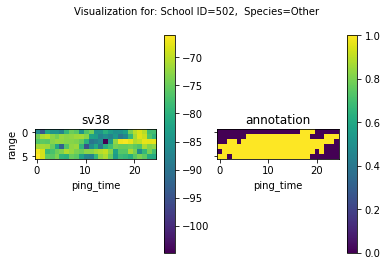

Species=Other; ID=503; N=75.0; m_sv38=1.3404607e-06; m_r18=10.358967; m_r70=0.6192464
Species=Other; ID=504; N=65.0; m_sv38=3.8817234e-08; m_r18=6.703212; m_r70=20.11971
Species=Sandeel; ID=506; N=31.0; m_sv38=9.252916e-08; m_r18=0.272197; m_r70=1.1414245
Species=Other; ID=507; N=33.0; m_sv38=2.1091759e-07; m_r18=24.361689; m_r70=145.0955
Species=Sandeel; ID=508; N=129.0; m_sv38=3.4798836e-06; m_r18=2.3399107; m_r70=3.356419
Species=Other; ID=509; N=36.0; m_sv38=7.151942e-08; m_r18=9.806448; m_r70=8.450031
Species=Other; ID=510; N=30.0; m_sv38=1.1215583e-06; m_r18=1.6186371; m_r70=2.0907993
Species=Other; ID=511; N=44.0; m_sv38=1.5015085e-07; m_r18=11.849478; m_r70=1.731544
Species=Other; ID=512; N=102.0; m_sv38=1.0660273e-06; m_r18=17.706917; m_r70=15.242618
Species=Other; ID=513; N=173.0; m_sv38=4.7486758e-08; m_r18=5.128642; m_r70=4.5326123


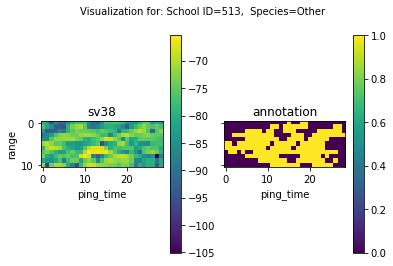

Species=Other; ID=514; N=77.0; m_sv38=6.976652e-07; m_r18=2.4737499; m_r70=1.3940052
Species=Other; ID=515; N=43.0; m_sv38=1.971201e-07; m_r18=32.307743; m_r70=1.2197093
Species=Other; ID=516; N=162.0; m_sv38=4.0643922e-08; m_r18=2.3921754; m_r70=1.5035286
Species=Other; ID=517; N=132.0; m_sv38=9.5449366e-08; m_r18=7.642504; m_r70=2.8651457
Species=Sandeel; ID=520; N=25.0; m_sv38=1.1198031e-07; m_r18=2.3593693; m_r70=3.158395
Species=Other; ID=521; N=85.0; m_sv38=5.1192217e-07; m_r18=6.2424955; m_r70=2.5763226
Species=Other; ID=522; N=132.0; m_sv38=3.1062208e-07; m_r18=92.175934; m_r70=0.7983119
Species=Other; ID=523; N=45.0; m_sv38=3.313411e-07; m_r18=3.666476; m_r70=4.7803445
Species=Sandeel; ID=524; N=17.0; m_sv38=3.9769128e-07; m_r18=8.803874; m_r70=8.227011
Species=Sandeel; ID=525; N=69.0; m_sv38=8.1564207e-07; m_r18=5.7962003; m_r70=3.7265449


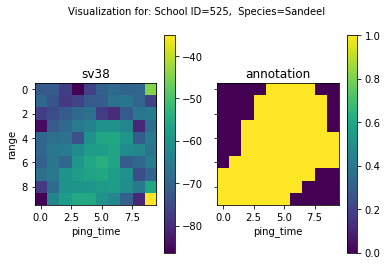

Species=Sandeel; ID=526; N=100.0; m_sv38=3.3582208e-07; m_r18=8.065324; m_r70=4.554603
Species=Sandeel; ID=527; N=82.0; m_sv38=7.1450523e-07; m_r18=5.084902; m_r70=6.896772
Species=Sandeel; ID=528; N=64.0; m_sv38=5.470216e-07; m_r18=2.1087174; m_r70=6.3207393
Species=Sandeel; ID=529; N=51.0; m_sv38=2.52567e-07; m_r18=2.4449213; m_r70=20.924023
Species=Other; ID=530; N=162.0; m_sv38=4.56204e-08; m_r18=44.03053; m_r70=7.0849776
Species=Other; ID=531; N=72.0; m_sv38=4.830408e-08; m_r18=3.2624617; m_r70=3.8335674
Species=Other; ID=532; N=110.0; m_sv38=8.732596e-07; m_r18=53.376007; m_r70=251.27817
Species=Other; ID=533; N=64.0; m_sv38=2.8577329e-08; m_r18=17.183722; m_r70=6.417915
Species=Other; ID=534; N=75.0; m_sv38=2.7492874e-07; m_r18=21.496805; m_r70=4.233844
Species=Other; ID=535; N=319.0; m_sv38=3.908695e-05; m_r18=24.630917; m_r70=21.162441


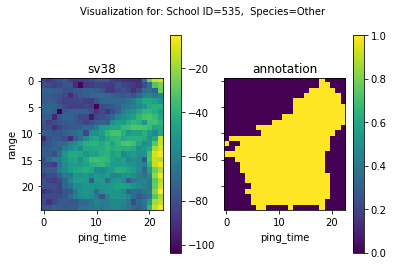

Species=Other; ID=536; N=43.0; m_sv38=3.5380614e-07; m_r18=17.706827; m_r70=10.624959
Species=Other; ID=537; N=131.0; m_sv38=7.899578e-07; m_r18=7.9846134; m_r70=1.4762771
Species=Other; ID=538; N=169.0; m_sv38=8.561153e-08; m_r18=13.011146; m_r70=5.1903524
Species=Sandeel; ID=539; N=138.0; m_sv38=3.6446067e-08; m_r18=20.917957; m_r70=22.149506
Species=Other; ID=540; N=136.0; m_sv38=3.693799e-06; m_r18=160.87732; m_r70=41.46889
Species=Other; ID=542; N=201.0; m_sv38=9.423517e-08; m_r18=66.27815; m_r70=11.310272
Species=Other; ID=543; N=261.0; m_sv38=7.668997e-05; m_r18=5.518265; m_r70=2.9582725
Species=Other; ID=545; N=54.0; m_sv38=1.366248e-08; m_r18=4.8499866; m_r70=12.586206
Species=Sandeel; ID=546; N=31.0; m_sv38=1.4255176e-07; m_r18=52.361584; m_r70=9.886984
Species=Other; ID=547; N=150.0; m_sv38=5.029227e-07; m_r18=6.9818277; m_r70=1.9403231


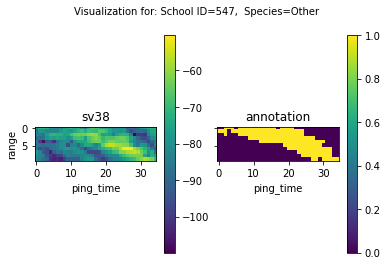

Species=Other; ID=548; N=57.0; m_sv38=3.475325e-07; m_r18=18.445326; m_r70=9.427266
Species=Other; ID=549; N=145.0; m_sv38=1.1533139e-07; m_r18=4.599538; m_r70=3.5865946
Species=Other; ID=550; N=57.0; m_sv38=1.4271231e-08; m_r18=38.649757; m_r70=29.296976
Species=Other; ID=551; N=132.0; m_sv38=2.166228e-05; m_r18=14.233064; m_r70=8.862157
Species=Other; ID=552; N=82.0; m_sv38=1.6566431e-06; m_r18=34.794052; m_r70=32.977097
Species=Other; ID=553; N=216.0; m_sv38=1.3417881e-05; m_r18=233.32236; m_r70=44.34515
Species=Other; ID=554; N=58.0; m_sv38=2.9833582e-06; m_r18=20.48641; m_r70=11.166192
Species=Sandeel; ID=555; N=54.0; m_sv38=1.04556634e-07; m_r18=5.4499207; m_r70=4.0978003
Species=Sandeel; ID=558; N=69.0; m_sv38=1.2402131e-07; m_r18=1.222045; m_r70=4.4769225
Species=Other; ID=560; N=69.0; m_sv38=8.3048906e-07; m_r18=10.476895; m_r70=2.8458152


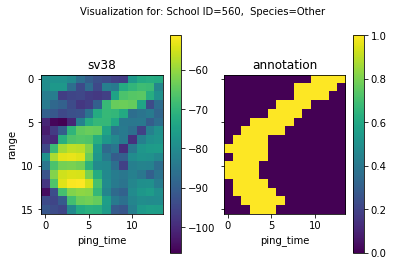

Species=Other; ID=561; N=169.0; m_sv38=6.4454184e-07; m_r18=9.8198395; m_r70=4.3547926
Species=Other; ID=562; N=598.0; m_sv38=3.1668222e-07; m_r18=8.306804; m_r70=2.9896495
Species=Other; ID=563; N=364.0; m_sv38=2.2144677e-07; m_r18=11.808548; m_r70=2.3928983
Species=Other; ID=564; N=32.0; m_sv38=2.5784416e-06; m_r18=21.120882; m_r70=4.0689964
Species=Sandeel; ID=565; N=82.0; m_sv38=9.479308e-08; m_r18=3.7716763; m_r70=18.593954
Species=Sandeel; ID=566; N=40.0; m_sv38=1.3046246e-06; m_r18=1.8326406; m_r70=1.0269614
Species=Other; ID=567; N=30.0; m_sv38=4.0325286e-08; m_r18=38.429646; m_r70=1.5249373
Species=Other; ID=568; N=22.0; m_sv38=3.3694223e-09; m_r18=61.544388; m_r70=25.199768
Species=Sandeel; ID=569; N=41.0; m_sv38=8.848269e-08; m_r18=3.3462074; m_r70=16.097937
Species=Other; ID=570; N=24.0; m_sv38=1.6899913e-08; m_r18=4.5835376; m_r70=3.322525


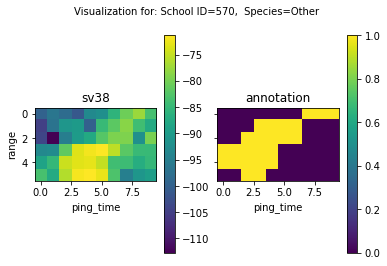

Species=Other; ID=571; N=22.0; m_sv38=3.7608405e-07; m_r18=7.842403; m_r70=11.863784
Species=Sandeel; ID=572; N=120.0; m_sv38=1.0104339e-07; m_r18=2.3454034; m_r70=4.0065784
Species=Other; ID=573; N=121.0; m_sv38=4.1183313e-08; m_r18=48.853233; m_r70=2.500002
Species=Other; ID=574; N=81.0; m_sv38=5.4930924e-06; m_r18=53.57745; m_r70=6.105576
Species=Other; ID=575; N=674.0; m_sv38=8.2574275e-07; m_r18=72.31964; m_r70=6.837302
Species=Other; ID=576; N=174.0; m_sv38=5.7614952e-06; m_r18=39.87304; m_r70=7.588884
Species=Other; ID=577; N=176.0; m_sv38=4.083356e-06; m_r18=11.714721; m_r70=2.6481411
Species=Sandeel; ID=578; N=78.0; m_sv38=3.309803e-07; m_r18=17.60172; m_r70=11.609107
Species=Sandeel; ID=579; N=54.0; m_sv38=3.436598e-05; m_r18=2.0986314; m_r70=5.42951
Species=Sandeel; ID=580; N=32.0; m_sv38=1.5838033e-06; m_r18=5.8158026; m_r70=11.1769285


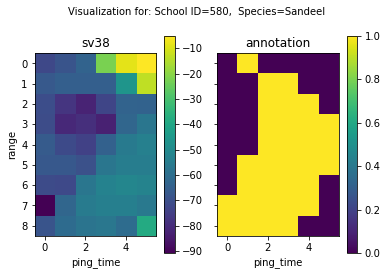

Species=Other; ID=581; N=205.0; m_sv38=4.7484446e-07; m_r18=8.271115; m_r70=3.2525165
Species=Other; ID=583; N=103.0; m_sv38=5.961326e-08; m_r18=10.496954; m_r70=1.6177083
Species=Other; ID=585; N=19.0; m_sv38=4.654857e-07; m_r18=6.7064166; m_r70=13.0975895
Species=Other; ID=586; N=73.0; m_sv38=1.4944104e-07; m_r18=20.82688; m_r70=4.81814
Species=Other; ID=587; N=194.0; m_sv38=1.2765375e-07; m_r18=13.1416445; m_r70=3.9536586
Species=Other; ID=588; N=70.0; m_sv38=1.2339355e-07; m_r18=47.302536; m_r70=15.304907
Species=Other; ID=589; N=94.0; m_sv38=2.8298248e-06; m_r18=3.157318; m_r70=0.9227847
Species=Other; ID=590; N=177.0; m_sv38=8.46796e-07; m_r18=29.813688; m_r70=9.251597
Species=Other; ID=591; N=26.0; m_sv38=3.0985888e-07; m_r18=1255.6683; m_r70=39.813194
Species=Other; ID=592; N=22.0; m_sv38=4.034628e-07; m_r18=60.075684; m_r70=11.9842415


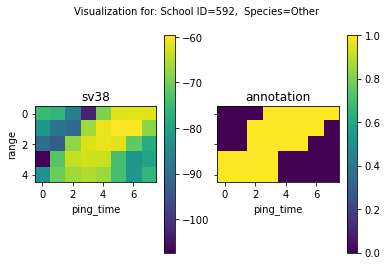

Species=Other; ID=593; N=126.0; m_sv38=7.000816e-07; m_r18=3.6922238; m_r70=13.150159
Species=Other; ID=594; N=177.0; m_sv38=2.9623584e-08; m_r18=54.136883; m_r70=5.6706486
Species=Other; ID=596; N=46.0; m_sv38=2.3549875e-08; m_r18=2.81391; m_r70=5.962657
Species=Other; ID=597; N=87.0; m_sv38=3.6216096e-07; m_r18=7.906926; m_r70=4.6142387
Species=Other; ID=598; N=28.0; m_sv38=8.546463e-08; m_r18=42.15751; m_r70=26.133974
Species=Other; ID=599; N=27.0; m_sv38=1.00812855e-07; m_r18=72.58227; m_r70=46.837795
Species=Sandeel; ID=600; N=75.0; m_sv38=9.996446e-07; m_r18=6.8530517; m_r70=6.7264466
Species=Other; ID=603; N=31.0; m_sv38=1.7891027e-08; m_r18=3.1757514; m_r70=2.1549625
Species=Other; ID=604; N=36.0; m_sv38=5.2758865e-06; m_r18=6.0445676; m_r70=21.338524
Species=Other; ID=605; N=127.0; m_sv38=3.9151884e-05; m_r18=17.694513; m_r70=40.18928


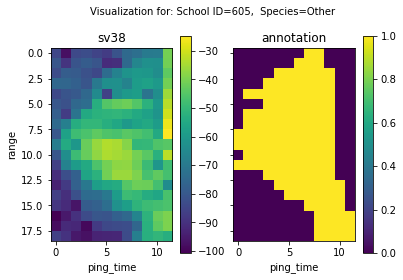

Species=Other; ID=606; N=62.0; m_sv38=2.3583928e-07; m_r18=14.218062; m_r70=3.649268
Species=Other; ID=607; N=50.0; m_sv38=4.3372775e-06; m_r18=7.3024397; m_r70=3.6547296
Species=Other; ID=609; N=46.0; m_sv38=5.33558e-07; m_r18=200.91829; m_r70=1.3505801
Species=Other; ID=610; N=155.0; m_sv38=3.059499e-06; m_r18=13.01618; m_r70=5.8654356
Species=Other; ID=615; N=80.0; m_sv38=4.193897e-06; m_r18=12.690476; m_r70=4.3924494
Species=Other; ID=616; N=12.0; m_sv38=1.3855332e-07; m_r18=9.300269; m_r70=2.5082865
Species=Other; ID=617; N=46.0; m_sv38=1.0989379e-07; m_r18=15.956535; m_r70=14.521333
Species=Other; ID=618; N=191.0; m_sv38=3.2699397e-06; m_r18=126.23925; m_r70=4.7318654
Species=Other; ID=619; N=77.0; m_sv38=7.6829934e-08; m_r18=4.4098196; m_r70=6.9217744
Species=Sandeel; ID=620; N=134.0; m_sv38=6.0973804e-08; m_r18=3.6584613; m_r70=3.162623


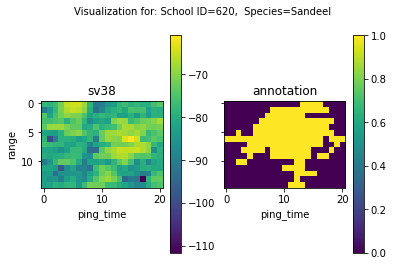

Species=Other; ID=622; N=30.0; m_sv38=6.913986e-08; m_r18=14.046932; m_r70=3.3479664
Species=Other; ID=623; N=90.0; m_sv38=9.814152e-07; m_r18=31.28937; m_r70=2.380537
Species=Other; ID=624; N=37.0; m_sv38=1.0808597e-08; m_r18=5.2621813; m_r70=125.79089
Species=Other; ID=625; N=76.0; m_sv38=5.44581e-06; m_r18=5.4315886; m_r70=2.2948334
Species=Other; ID=626; N=44.0; m_sv38=1.5508952e-07; m_r18=39.5499; m_r70=14.638515
Species=Other; ID=627; N=98.0; m_sv38=1.1990496e-06; m_r18=33.432648; m_r70=7.4923835
Species=Other; ID=628; N=13.0; m_sv38=7.734283e-08; m_r18=2.5472112; m_r70=2.4626474
Species=Other; ID=629; N=63.0; m_sv38=3.378799e-06; m_r18=12.814321; m_r70=5.363643
Species=Other; ID=630; N=256.0; m_sv38=3.423798e-07; m_r18=9.757091; m_r70=4.6089444
Species=Other; ID=631; N=98.0; m_sv38=1.9068224e-07; m_r18=19.562904; m_r70=4.400682


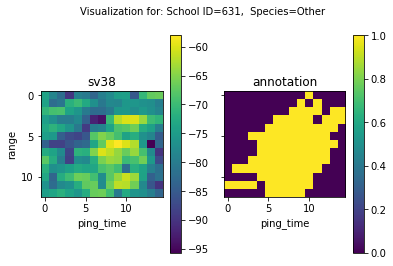

Species=Sandeel; ID=632; N=67.0; m_sv38=2.1729772e-07; m_r18=4.144697; m_r70=76.8126
Species=Sandeel; ID=633; N=38.0; m_sv38=3.49745e-07; m_r18=4.4254055; m_r70=2.0530334
Species=Other; ID=635; N=20.0; m_sv38=6.9312506e-07; m_r18=7.0517564; m_r70=5.993481
Species=Other; ID=636; N=35.0; m_sv38=1.6890222e-07; m_r18=14.127168; m_r70=10.026866
Species=Other; ID=638; N=52.0; m_sv38=4.040056e-07; m_r18=18.048098; m_r70=9.198598
Species=Other; ID=639; N=127.0; m_sv38=3.3468072e-07; m_r18=3.5051188; m_r70=2.9316823
Species=Other; ID=640; N=214.0; m_sv38=6.178447e-08; m_r18=19.093517; m_r70=6.2043943
Species=Other; ID=641; N=56.0; m_sv38=4.3705473e-08; m_r18=207.19017; m_r70=367.43555
Species=Other; ID=642; N=57.0; m_sv38=2.1799746e-08; m_r18=32.00143; m_r70=25.249376
Species=Other; ID=643; N=100.0; m_sv38=1.9041512e-06; m_r18=6.1412115; m_r70=1.8923906


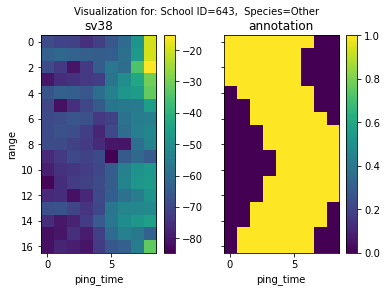

Species=Other; ID=644; N=75.0; m_sv38=1.3816829e-07; m_r18=3.4091852; m_r70=3.7269833
Species=Other; ID=645; N=24.0; m_sv38=8.539265e-08; m_r18=19.960354; m_r70=2.1438358
Species=Other; ID=646; N=61.0; m_sv38=2.1966747e-08; m_r18=2.567671; m_r70=3.4041913
Species=Other; ID=647; N=52.0; m_sv38=5.369365e-08; m_r18=9.049801; m_r70=2.7649634
Species=Other; ID=648; N=25.0; m_sv38=8.4138826e-08; m_r18=10.514227; m_r70=12.3146925
Species=Other; ID=649; N=154.0; m_sv38=5.957421e-07; m_r18=188.87701; m_r70=11.127727
Species=Other; ID=651; N=122.0; m_sv38=3.6511787e-07; m_r18=13.469929; m_r70=2.2764397
Species=Sandeel; ID=652; N=52.0; m_sv38=6.8015666e-08; m_r18=28.140123; m_r70=25.065535
Species=Other; ID=653; N=199.0; m_sv38=1.08516225e-07; m_r18=55.982067; m_r70=6.053514
Species=Other; ID=654; N=95.0; m_sv38=2.2259396e-08; m_r18=17.12645; m_r70=32.65467


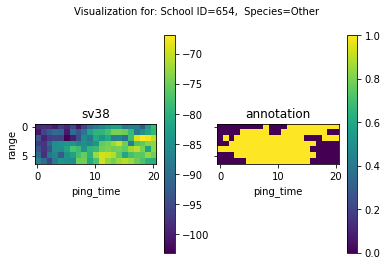

Species=Other; ID=655; N=24.0; m_sv38=3.3130039e-09; m_r18=24.433954; m_r70=6.2278876
Species=Other; ID=656; N=330.0; m_sv38=3.8232893e-06; m_r18=283.8591; m_r70=4.9986777
Species=Other; ID=657; N=85.0; m_sv38=1.397905e-08; m_r18=49.059185; m_r70=2.6637132
Species=Other; ID=658; N=69.0; m_sv38=1.93372e-08; m_r18=81.81245; m_r70=11.167863
Species=Sandeel; ID=659; N=33.0; m_sv38=5.995279e-08; m_r18=0.8622343; m_r70=6.91804
Species=Other; ID=660; N=36.0; m_sv38=1.3723683e-08; m_r18=2.1147292; m_r70=11.744737
Species=Sandeel; ID=661; N=64.0; m_sv38=7.2046966e-08; m_r18=6.238652; m_r70=21.018002
Species=Sandeel; ID=662; N=54.0; m_sv38=1.4146705e-06; m_r18=6.6646175; m_r70=5.3408303
Species=Other; ID=663; N=49.0; m_sv38=3.972983e-06; m_r18=22.67206; m_r70=31.012867
Species=Sandeel; ID=664; N=71.0; m_sv38=2.41318e-07; m_r18=1.8537918; m_r70=1.7240882


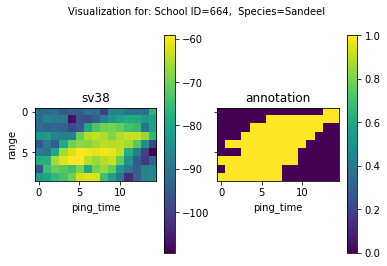

Species=Other; ID=665; N=35.0; m_sv38=1.108042e-08; m_r18=14.969282; m_r70=19.193146
Species=Other; ID=666; N=16.0; m_sv38=3.976997e-07; m_r18=4.0717316; m_r70=19.231218
Species=Other; ID=667; N=212.0; m_sv38=5.569915e-06; m_r18=25.062786; m_r70=16.008718
Species=Other; ID=668; N=51.0; m_sv38=2.0311491e-07; m_r18=37.575138; m_r70=3.5528839
Species=Other; ID=669; N=63.0; m_sv38=2.3519078e-07; m_r18=12.1801605; m_r70=3.8782237
Species=Other; ID=670; N=51.0; m_sv38=2.890954e-08; m_r18=17.144909; m_r70=0.5940925
Species=Other; ID=671; N=47.0; m_sv38=1.15395004e-07; m_r18=30.661903; m_r70=4.0021725
Species=Other; ID=672; N=26.0; m_sv38=1.5332601e-08; m_r18=75.887436; m_r70=0.46678802
Species=Other; ID=673; N=34.0; m_sv38=6.514644e-08; m_r18=4.998519; m_r70=0.40027395
Species=Other; ID=674; N=98.0; m_sv38=4.0868886e-07; m_r18=20.121313; m_r70=0.84138346


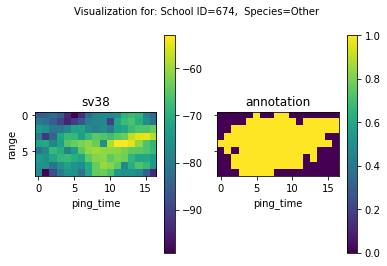

Species=Other; ID=675; N=135.0; m_sv38=1.2247083e-05; m_r18=22.743826; m_r70=5.048522
Species=Other; ID=676; N=61.0; m_sv38=2.516469e-07; m_r18=33.250294; m_r70=3.6215138
Species=Other; ID=677; N=1065.0; m_sv38=3.330949e-05; m_r18=11.231808; m_r70=5.0527325
Species=Other; ID=678; N=112.0; m_sv38=3.317584e-06; m_r18=16.763231; m_r70=2.755068
Species=Other; ID=679; N=96.0; m_sv38=1.2585343e-07; m_r18=63.222443; m_r70=9.590243
Species=Other; ID=680; N=101.0; m_sv38=4.7586038e-08; m_r18=38.100998; m_r70=2.3306453
Species=Other; ID=681; N=22.0; m_sv38=5.6821546e-07; m_r18=3.019921; m_r70=3.8087022
Species=Other; ID=682; N=143.0; m_sv38=1.759676e-05; m_r18=10.867929; m_r70=13.246684
Species=Other; ID=683; N=46.0; m_sv38=1.238022e-06; m_r18=4.811495; m_r70=3.5829432
Species=Other; ID=684; N=32.0; m_sv38=3.4248308e-07; m_r18=3.9364188; m_r70=0.50751406


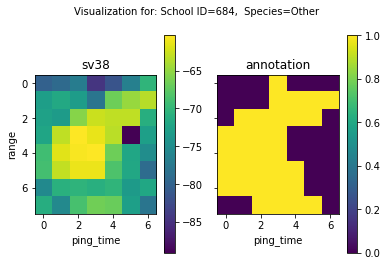

Species=Other; ID=685; N=104.0; m_sv38=5.351456e-07; m_r18=9.483262; m_r70=1.5729951
Species=Other; ID=686; N=69.0; m_sv38=2.7061606e-07; m_r18=22.143494; m_r70=12.065814
Species=Other; ID=687; N=57.0; m_sv38=7.053021e-08; m_r18=5.842028; m_r70=4.0028224
Species=Other; ID=690; N=21.0; m_sv38=1.9799157e-07; m_r18=2.306327; m_r70=3.8241007
Species=Other; ID=691; N=58.0; m_sv38=1.7650858e-07; m_r18=4.1239657; m_r70=1.2684547
Species=Other; ID=692; N=77.0; m_sv38=2.5760738e-07; m_r18=12.804798; m_r70=10.965856
Species=Other; ID=693; N=71.0; m_sv38=3.8775394e-07; m_r18=12.865647; m_r70=16.068045
Species=Other; ID=695; N=80.0; m_sv38=8.850677e-06; m_r18=2.5310242; m_r70=1.7216387
Species=Sandeel; ID=697; N=73.0; m_sv38=4.9161474e-07; m_r18=2.3287897; m_r70=3.0402994
Species=Other; ID=698; N=74.0; m_sv38=1.0010999e-05; m_r18=3.713511; m_r70=2.8975732


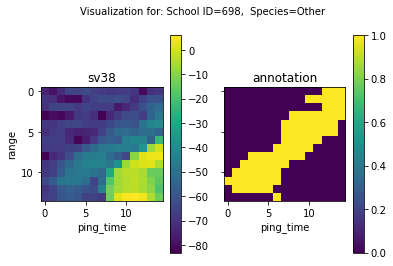

Species=Other; ID=699; N=77.0; m_sv38=2.6992197e-07; m_r18=4.7186756; m_r70=2.1443932
Species=Other; ID=700; N=56.0; m_sv38=2.1635993e-05; m_r18=7.5386314; m_r70=1.5718939
Species=Other; ID=702; N=66.0; m_sv38=1.9348415e-07; m_r18=15.193379; m_r70=2.0810866
Species=Other; ID=703; N=60.0; m_sv38=2.046864e-07; m_r18=28.846458; m_r70=4.4968557
Species=Other; ID=704; N=55.0; m_sv38=8.5290594e-07; m_r18=34.94227; m_r70=5.222016
Species=Other; ID=705; N=247.0; m_sv38=5.406549e-06; m_r18=63.2497; m_r70=6.7866025
Species=Other; ID=706; N=93.0; m_sv38=1.5860611e-06; m_r18=16.018576; m_r70=12.657834
Species=Sandeel; ID=707; N=41.0; m_sv38=1.790721e-06; m_r18=1.9327197; m_r70=8.230212
Species=Other; ID=708; N=55.0; m_sv38=4.2405844e-07; m_r18=26.949156; m_r70=1.6257689
Species=Other; ID=709; N=32.0; m_sv38=4.228909e-06; m_r18=1.0436747; m_r70=1.3644083


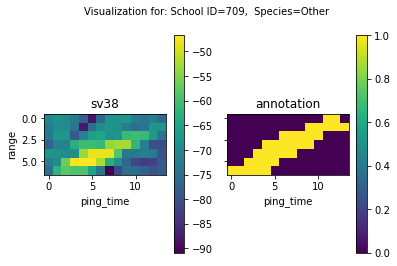

Species=Sandeel; ID=710; N=35.0; m_sv38=2.2080003e-06; m_r18=6.4097466; m_r70=3.8692284
Species=Other; ID=711; N=89.0; m_sv38=5.525218e-08; m_r18=15.225542; m_r70=5.283934
Species=Other; ID=712; N=29.0; m_sv38=5.466416e-08; m_r18=14.588367; m_r70=14.994426
Species=Other; ID=713; N=59.0; m_sv38=4.945585e-07; m_r18=3.2578087; m_r70=2.5346172
Species=Other; ID=714; N=121.0; m_sv38=6.968806e-08; m_r18=20.50543; m_r70=4.7330246
Species=Other; ID=715; N=35.0; m_sv38=1.0061671e-07; m_r18=8.141032; m_r70=4.6343102
Species=Other; ID=716; N=57.0; m_sv38=2.9396767e-06; m_r18=2.9381704; m_r70=0.49630335
Species=Other; ID=717; N=218.0; m_sv38=8.58768e-07; m_r18=17.068771; m_r70=7.981818
Species=Other; ID=718; N=58.0; m_sv38=9.5004026e-08; m_r18=3.7470453; m_r70=3.235649
Species=Other; ID=719; N=39.0; m_sv38=3.0078633e-07; m_r18=9.260656; m_r70=2.636912


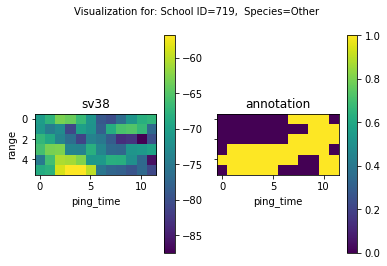

Species=Other; ID=720; N=70.0; m_sv38=1.4961483e-08; m_r18=15.983686; m_r70=8.981238
Species=Other; ID=723; N=771.0; m_sv38=0.00013131087; m_r18=13.544497; m_r70=6.570857
Species=Other; ID=724; N=40.0; m_sv38=6.7997696e-08; m_r18=3.89962; m_r70=3.0856838
Species=Other; ID=725; N=94.0; m_sv38=1.0193917e-07; m_r18=17.454428; m_r70=7.4238176
Species=Other; ID=726; N=51.0; m_sv38=2.0625662e-07; m_r18=118.04653; m_r70=0.7008496
Species=Sandeel; ID=727; N=33.0; m_sv38=7.9740985e-08; m_r18=4.383658; m_r70=7.277283
Species=Other; ID=728; N=48.0; m_sv38=2.232901e-07; m_r18=1.3895043; m_r70=0.68876404
Species=Other; ID=729; N=314.0; m_sv38=1.6722462e-06; m_r18=24.105215; m_r70=5.351187
Species=Sandeel; ID=730; N=69.0; m_sv38=1.74101e-07; m_r18=0.43675226; m_r70=2.6201081
Species=Other; ID=731; N=47.0; m_sv38=1.3836386e-06; m_r18=14.035325; m_r70=1.2696116


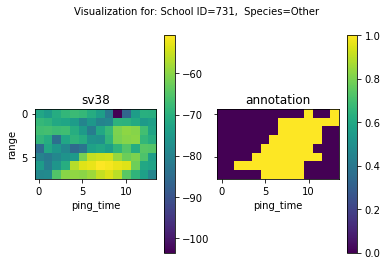

Species=Other; ID=732; N=51.0; m_sv38=1.06218735e-07; m_r18=25.420029; m_r70=11.527845
Species=Other; ID=733; N=46.0; m_sv38=8.56869e-08; m_r18=6.233968; m_r70=1.3081449
Species=Sandeel; ID=734; N=230.0; m_sv38=6.3795267e-07; m_r18=2.4023058; m_r70=3.8692653
Species=Other; ID=735; N=223.0; m_sv38=2.6673629e-06; m_r18=206.82898; m_r70=2.3087213
Species=Other; ID=736; N=169.0; m_sv38=1.6500102e-06; m_r18=110.358925; m_r70=35.89635
Species=Other; ID=737; N=186.0; m_sv38=3.890354e-06; m_r18=67.744095; m_r70=7.065041
Species=Other; ID=739; N=242.0; m_sv38=1.9822575e-05; m_r18=111.502525; m_r70=3.535308
Species=Other; ID=740; N=89.0; m_sv38=2.8913167e-08; m_r18=116.147194; m_r70=12.226184
Species=Other; ID=741; N=137.0; m_sv38=2.6299096e-08; m_r18=8.547835; m_r70=4.778927
Species=Sandeel; ID=742; N=40.0; m_sv38=2.8833963e-07; m_r18=0.21797486; m_r70=0.43750173


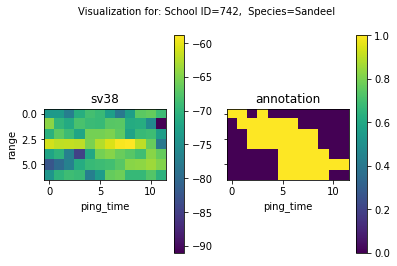

Species=Other; ID=743; N=627.0; m_sv38=4.3522603e-05; m_r18=10.120014; m_r70=6.802871
Species=Other; ID=747; N=161.0; m_sv38=6.0550214e-08; m_r18=40.25846; m_r70=8.209945
Species=Other; ID=748; N=107.0; m_sv38=1.459358e-07; m_r18=60.608326; m_r70=580.1961
Species=Other; ID=749; N=138.0; m_sv38=1.4170828e-07; m_r18=40.328365; m_r70=4.7953987
Species=Other; ID=750; N=407.0; m_sv38=8.163573e-08; m_r18=59.87107; m_r70=7.291986
Species=Other; ID=751; N=96.0; m_sv38=4.3154832e-06; m_r18=22.608404; m_r70=2.0831044
Species=Other; ID=752; N=168.0; m_sv38=1.16291936e-07; m_r18=32.46832; m_r70=11.826937
Species=Other; ID=754; N=67.0; m_sv38=4.2563244e-08; m_r18=16.074135; m_r70=16.613129
Species=Other; ID=755; N=486.0; m_sv38=3.2112948e-07; m_r18=120.14036; m_r70=10.526947
Species=Other; ID=757; N=156.0; m_sv38=8.2477794e-07; m_r18=30.99623; m_r70=3.9321423


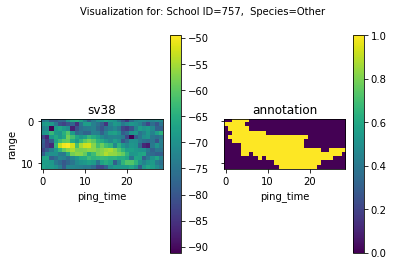

Species=Other; ID=758; N=124.0; m_sv38=8.0665096e-08; m_r18=7.1031275; m_r70=4.533133
Species=Other; ID=759; N=60.0; m_sv38=4.259255e-08; m_r18=6.1636496; m_r70=15.524191
Species=Other; ID=760; N=27.0; m_sv38=8.3604945e-08; m_r18=8.10327; m_r70=2.2015226
Species=Other; ID=761; N=448.0; m_sv38=2.9400013e-07; m_r18=5.3071885; m_r70=4.516571
Species=Other; ID=762; N=426.0; m_sv38=3.270914e-07; m_r18=6.943741; m_r70=3.1165648
Species=Other; ID=763; N=232.0; m_sv38=2.8541555e-07; m_r18=16.818874; m_r70=2.6329162
Species=Other; ID=764; N=591.0; m_sv38=2.5681572e-07; m_r18=19.068438; m_r70=3.3777082
Species=Other; ID=765; N=69.0; m_sv38=8.006799e-07; m_r18=16.306204; m_r70=9.357015
Species=Other; ID=766; N=746.0; m_sv38=4.2184747e-05; m_r18=66.41379; m_r70=7.4104843
Species=Other; ID=767; N=58.0; m_sv38=7.0956037e-07; m_r18=14.669507; m_r70=10.763156


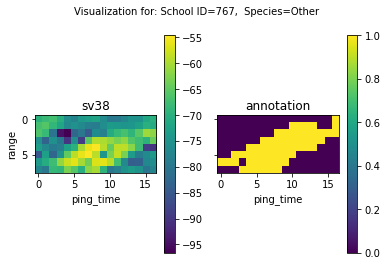

Species=Other; ID=769; N=361.0; m_sv38=1.5584254e-07; m_r18=12.008437; m_r70=8.240033
Species=Other; ID=770; N=158.0; m_sv38=6.817816e-08; m_r18=27.516842; m_r70=20.528389
Species=Other; ID=771; N=280.0; m_sv38=6.314682e-08; m_r18=601.5622; m_r70=35.17897
Species=Other; ID=772; N=261.0; m_sv38=1.4691737e-07; m_r18=63.363655; m_r70=13.4574375
Species=Other; ID=773; N=46.0; m_sv38=1.9767065e-06; m_r18=17.348532; m_r70=45.528004
Species=Other; ID=774; N=78.0; m_sv38=1.3088609e-06; m_r18=73.987274; m_r70=8.259408
Species=Other; ID=775; N=150.0; m_sv38=1.7804237e-05; m_r18=8.599293; m_r70=7.6576986
Species=Other; ID=776; N=388.0; m_sv38=2.7777858e-05; m_r18=11.514779; m_r70=5.8559337
Species=Other; ID=777; N=55.0; m_sv38=4.400839e-06; m_r18=9.349497; m_r70=2.8930056
Species=Other; ID=781; N=309.0; m_sv38=1.0807282e-06; m_r18=69.94519; m_r70=17.264036


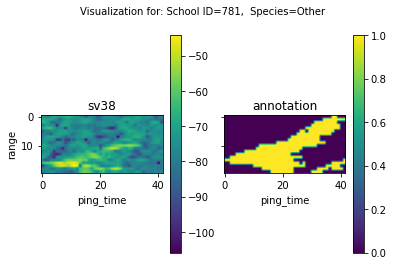

Species=Other; ID=782; N=26.0; m_sv38=1.4187091e-08; m_r18=18.434114; m_r70=90.7357
Species=Other; ID=783; N=109.0; m_sv38=7.2175686e-07; m_r18=139.37468; m_r70=16.644566
Species=Other; ID=784; N=73.0; m_sv38=1.7318395e-07; m_r18=32.848484; m_r70=11.71062
Species=Other; ID=785; N=65.0; m_sv38=1.3940194e-06; m_r18=76.25766; m_r70=12.089346
Species=Other; ID=787; N=30.0; m_sv38=8.0595316e-07; m_r18=2.258478; m_r70=4.8065696
Species=Sandeel; ID=788; N=34.0; m_sv38=1.0431696e-06; m_r18=6.6731415; m_r70=4.920139
Species=Other; ID=789; N=425.0; m_sv38=2.6924132e-05; m_r18=34.67906; m_r70=25.073467
Species=Other; ID=790; N=166.0; m_sv38=2.0971468e-06; m_r18=40.067856; m_r70=4.1122684
Species=Sandeel; ID=791; N=48.0; m_sv38=1.2788854e-07; m_r18=0.6073712; m_r70=2.2118857
Species=Other; ID=792; N=55.0; m_sv38=9.80034e-07; m_r18=32.34535; m_r70=2.609489


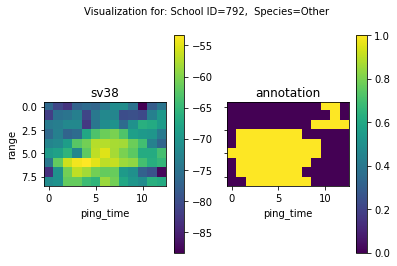

Species=Other; ID=793; N=94.0; m_sv38=8.609548e-06; m_r18=28.323107; m_r70=8.650036
Species=Other; ID=795; N=75.0; m_sv38=4.9232053e-06; m_r18=3.3279567; m_r70=1.8817087
Species=Other; ID=796; N=322.0; m_sv38=6.121353e-08; m_r18=52.98576; m_r70=14.526125
Species=Other; ID=797; N=251.0; m_sv38=3.8470603e-06; m_r18=32.252766; m_r70=4.4986672
Species=Other; ID=798; N=43.0; m_sv38=2.3731106e-08; m_r18=5.6008472; m_r70=12.86476
Species=Other; ID=799; N=245.0; m_sv38=2.9939815e-06; m_r18=46.989204; m_r70=1.004596
Species=Other; ID=800; N=27.0; m_sv38=1.3200116e-08; m_r18=60.14482; m_r70=6.540708
Species=Other; ID=801; N=106.0; m_sv38=3.8305316e-07; m_r18=28.236296; m_r70=1.1469531
Species=Other; ID=802; N=124.0; m_sv38=2.9794275e-08; m_r18=17.880554; m_r70=6.9179606
Species=Other; ID=803; N=121.0; m_sv38=4.678383e-08; m_r18=12.815366; m_r70=12.847211


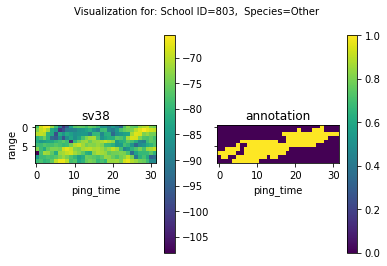

Species=Other; ID=804; N=92.0; m_sv38=3.0937116e-08; m_r18=16.6384; m_r70=3.2235775
Species=Other; ID=805; N=41.0; m_sv38=1.38250185e-08; m_r18=8.227138; m_r70=9.319536
Species=Other; ID=806; N=318.0; m_sv38=6.9365697e-06; m_r18=19.779104; m_r70=1.4656316
Species=Other; ID=807; N=87.0; m_sv38=1.911108e-08; m_r18=5.049964; m_r70=8.082115
Species=Other; ID=808; N=474.0; m_sv38=1.3026705e-07; m_r18=18.308159; m_r70=8.183787
Species=Other; ID=809; N=594.0; m_sv38=2.6643258e-07; m_r18=14.418429; m_r70=3.9778554
Species=Other; ID=810; N=13.0; m_sv38=5.261337e-07; m_r18=2.2908838; m_r70=1.0727547
Species=Other; ID=812; N=29.0; m_sv38=6.249178e-08; m_r18=5.6728125; m_r70=11.55088
Species=Other; ID=813; N=32.0; m_sv38=6.224893e-08; m_r18=1.3729784; m_r70=0.7851927
Species=Other; ID=814; N=27.0; m_sv38=1.5129045e-07; m_r18=1.1639451; m_r70=2.3067627


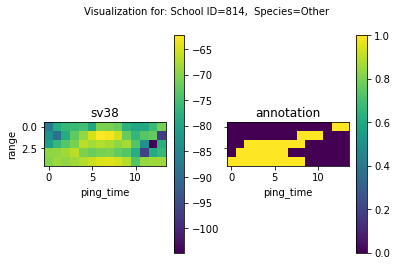

Species=Other; ID=817; N=132.0; m_sv38=8.80436e-06; m_r18=17.851114; m_r70=2.3133488
Species=Other; ID=818; N=42.0; m_sv38=1.4872594e-05; m_r18=21.150719; m_r70=13.527072
Species=Sandeel; ID=819; N=13.0; m_sv38=3.6871793e-07; m_r18=8.062519; m_r70=4.883685
Species=Other; ID=820; N=578.0; m_sv38=3.8009686e-05; m_r18=11.785785; m_r70=9.596242
Species=Sandeel; ID=821; N=102.0; m_sv38=2.4465922e-05; m_r18=2.6000335; m_r70=2.829162
Species=Other; ID=822; N=661.0; m_sv38=2.3086666e-05; m_r18=33.00627; m_r70=9.029515
Species=Other; ID=823; N=25.0; m_sv38=9.5093776e-07; m_r18=14.421747; m_r70=0.538365
Species=Other; ID=825; N=311.0; m_sv38=5.1849573e-05; m_r18=7.8409185; m_r70=8.82113
Species=Other; ID=826; N=321.0; m_sv38=1.5607258e-06; m_r18=1.5444752; m_r70=1.1040884
Species=Other; ID=827; N=378.0; m_sv38=3.824642e-05; m_r18=12.705293; m_r70=7.378272


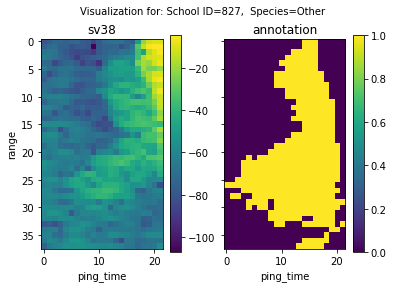

Species=Other; ID=828; N=49.0; m_sv38=1.3390848e-05; m_r18=2.6051667; m_r70=30.141634
Species=Other; ID=829; N=373.0; m_sv38=1.0986571e-06; m_r18=105.934166; m_r70=5.5450606
Species=Other; ID=830; N=521.0; m_sv38=2.1368903e-06; m_r18=29.050152; m_r70=1.6668544
Species=Sandeel; ID=831; N=190.0; m_sv38=5.9025257e-07; m_r18=0.7194165; m_r70=3.1228228
Species=Other; ID=832; N=1321.0; m_sv38=1.0195717e-05; m_r18=151.42082; m_r70=3.6688943
Species=Other; ID=833; N=138.0; m_sv38=8.1225147e-07; m_r18=781.1849; m_r70=7.3075852
Species=Other; ID=836; N=5043.0; m_sv38=5.843418e-05; m_r18=105.39874; m_r70=8.337655
Species=Other; ID=837; N=87.0; m_sv38=1.07177775e-05; m_r18=6.6405077; m_r70=6.7784944
Species=Other; ID=838; N=213.0; m_sv38=1.8969398e-06; m_r18=37.163914; m_r70=1.8617052
Species=Other; ID=839; N=82.0; m_sv38=9.188693e-07; m_r18=12.75286; m_r70=6.1663027


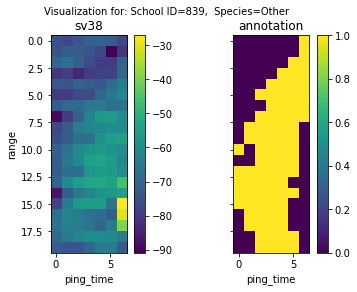

Species=Other; ID=840; N=379.0; m_sv38=1.7098828e-05; m_r18=4.040445; m_r70=5.543653
Species=Other; ID=844; N=4859.0; m_sv38=2.5740657e-05; m_r18=78.28824; m_r70=4.9478564
Species=Other; ID=845; N=2187.0; m_sv38=2.5870457e-05; m_r18=97.0189; m_r70=5.7489214
Species=Other; ID=846; N=91.0; m_sv38=7.676353e-06; m_r18=3.035766; m_r70=2.519026
Species=Sandeel; ID=847; N=34.0; m_sv38=1.1441331e-06; m_r18=3.043207; m_r70=4.9745674
Species=Other; ID=849; N=191.0; m_sv38=1.0085648e-05; m_r18=11.03661; m_r70=7.6562204
Species=Other; ID=850; N=248.0; m_sv38=3.5440435e-06; m_r18=102.17562; m_r70=2.4368513
Species=Other; ID=851; N=466.0; m_sv38=2.872068e-05; m_r18=87.767586; m_r70=5.562884
Species=Other; ID=852; N=15.0; m_sv38=1.853166e-07; m_r18=1.8874007; m_r70=1.523194
Species=Other; ID=853; N=20.0; m_sv38=3.73932e-07; m_r18=78.03017; m_r70=128.78049


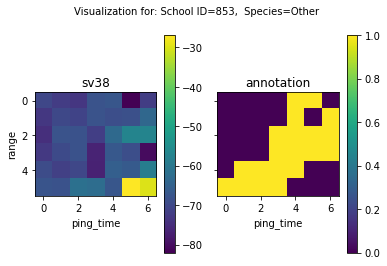

Species=Other; ID=854; N=82.0; m_sv38=4.277423e-06; m_r18=24.043987; m_r70=1.7054579
Species=Other; ID=855; N=17.0; m_sv38=8.897528e-08; m_r18=8.007714; m_r70=1.5532463
Species=Other; ID=856; N=81.0; m_sv38=2.1611123e-07; m_r18=2.4857602; m_r70=0.917621
Species=Other; ID=857; N=61.0; m_sv38=4.8302898e-08; m_r18=8.091783; m_r70=4.7450724
Species=Other; ID=859; N=35.0; m_sv38=3.8920092e-08; m_r18=3.3947241; m_r70=14.60168
Species=Other; ID=860; N=66.0; m_sv38=3.264531e-07; m_r18=6.940374; m_r70=8.870756
Species=Other; ID=861; N=233.0; m_sv38=4.4968253e-08; m_r18=31.605429; m_r70=8.250628
Species=Other; ID=862; N=103.0; m_sv38=3.040593e-07; m_r18=2.9078805; m_r70=2.2714727
Species=Other; ID=864; N=178.0; m_sv38=1.6516506e-07; m_r18=53.06901; m_r70=5.52641
Species=Other; ID=865; N=291.0; m_sv38=1.6253529e-07; m_r18=5.071788; m_r70=11.726438


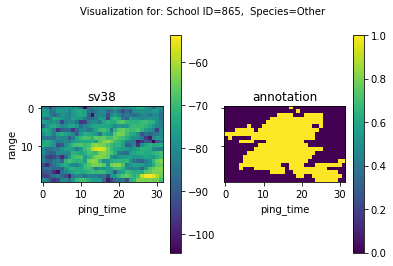

Species=Other; ID=866; N=60.0; m_sv38=1.6536071e-06; m_r18=16.699272; m_r70=4.9927063
Species=Other; ID=867; N=38.0; m_sv38=9.506608e-06; m_r18=6.083462; m_r70=7.23449
Species=Other; ID=868; N=26.0; m_sv38=1.05987326e-07; m_r18=2.921097; m_r70=1.8039289
Species=Other; ID=870; N=379.0; m_sv38=8.634451e-06; m_r18=9.530693; m_r70=4.9694653
Species=Other; ID=871; N=107.0; m_sv38=4.374306e-06; m_r18=3.478675; m_r70=24.095001
Species=Other; ID=872; N=64.0; m_sv38=8.5501206e-08; m_r18=33.136887; m_r70=8.382176
Species=Other; ID=873; N=48.0; m_sv38=2.5801234e-07; m_r18=65.54896; m_r70=29.20723
Species=Sandeel; ID=874; N=30.0; m_sv38=1.5179779e-07; m_r18=0.45241317; m_r70=1.0849451
Species=Other; ID=875; N=81.0; m_sv38=3.2610114e-08; m_r18=3.9616032; m_r70=15.4366255
Species=Other; ID=876; N=39.0; m_sv38=2.119359e-06; m_r18=14.89469; m_r70=19.35473


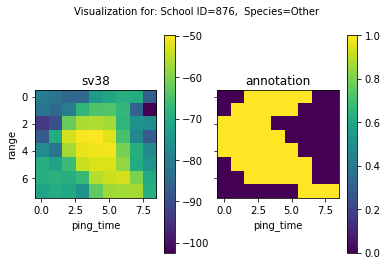

Species=Sandeel; ID=878; N=22.0; m_sv38=8.918235e-08; m_r18=3.1627815; m_r70=7.639079
Species=Other; ID=880; N=133.0; m_sv38=1.9924641e-07; m_r18=9.213346; m_r70=13.17777
Species=Other; ID=881; N=169.0; m_sv38=8.353681e-06; m_r18=6.103962; m_r70=1.8685209
Species=Sandeel; ID=882; N=21.0; m_sv38=6.423632e-08; m_r18=1.7059194; m_r70=2.2682967
Species=Other; ID=883; N=30.0; m_sv38=3.9481927e-07; m_r18=1.7808532; m_r70=1.7240987
Species=Other; ID=884; N=40.0; m_sv38=4.0138917e-07; m_r18=1.0093222; m_r70=1.5811989
Species=Other; ID=885; N=331.0; m_sv38=2.428658e-05; m_r18=3.761381; m_r70=2.5643835
Species=Other; ID=886; N=39.0; m_sv38=1.7621093e-07; m_r18=3.4012227; m_r70=13.255403
Species=Other; ID=887; N=82.0; m_sv38=1.2225223e-07; m_r18=38.087288; m_r70=18.53746
Species=Other; ID=888; N=44.0; m_sv38=8.561612e-07; m_r18=4.18525; m_r70=3.273485


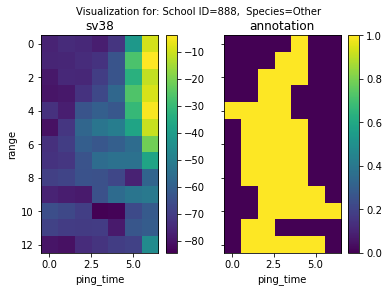

Species=Other; ID=889; N=317.0; m_sv38=6.4436404e-06; m_r18=14.177048; m_r70=1.6587453
Species=Other; ID=890; N=61.0; m_sv38=2.0732955e-06; m_r18=5.781366; m_r70=0.6498125
Species=Other; ID=891; N=94.0; m_sv38=2.9004782e-06; m_r18=10.35669; m_r70=27.340765
Species=Other; ID=894; N=83.0; m_sv38=4.376694e-07; m_r18=25.089615; m_r70=3.3215473
Species=Other; ID=895; N=532.0; m_sv38=4.4346583e-05; m_r18=9.964256; m_r70=5.266014
Species=Other; ID=896; N=71.0; m_sv38=1.1235469e-06; m_r18=7.870007; m_r70=0.97257406
Species=Other; ID=897; N=521.0; m_sv38=3.1243668e-05; m_r18=5.1783314; m_r70=3.6634164
Species=Sandeel; ID=898; N=131.0; m_sv38=2.161997e-07; m_r18=3.312523; m_r70=5.1725626
Species=Other; ID=899; N=77.0; m_sv38=1.3520479e-07; m_r18=4.745422; m_r70=18.734173
Species=Other; ID=900; N=107.0; m_sv38=1.9697829e-07; m_r18=3.5272043; m_r70=4.9756966


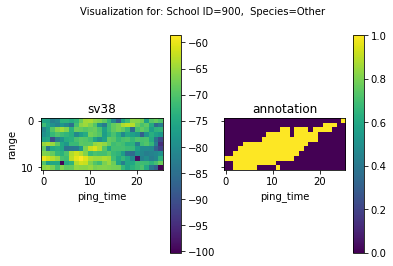

Species=Other; ID=901; N=380.0; m_sv38=4.355681e-05; m_r18=3.9648983; m_r70=6.513374
Species=Other; ID=902; N=355.0; m_sv38=1.7670793e-07; m_r18=62.129765; m_r70=6.0924363
Species=Other; ID=903; N=318.0; m_sv38=1.8923109e-07; m_r18=20.531008; m_r70=8.661264
Species=Other; ID=906; N=101.0; m_sv38=4.4000583e-07; m_r18=1.901473; m_r70=9.002688
Species=Other; ID=908; N=133.0; m_sv38=6.3308605e-08; m_r18=46.36385; m_r70=11.879155
Species=Other; ID=909; N=69.0; m_sv38=9.6512174e-08; m_r18=2.1074715; m_r70=4.2595153
Species=Other; ID=911; N=111.0; m_sv38=5.115683e-08; m_r18=8.496128; m_r70=3.0877376
Species=Sandeel; ID=912; N=62.0; m_sv38=8.583335e-08; m_r18=5.534482; m_r70=4.744635
Species=Other; ID=913; N=144.0; m_sv38=1.0504792e-07; m_r18=8.431778; m_r70=2.7962034
Species=Other; ID=914; N=640.0; m_sv38=2.329285e-07; m_r18=86.347435; m_r70=15.329364


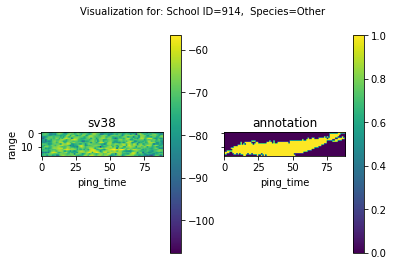

Species=Other; ID=915; N=54.0; m_sv38=1.0202213e-07; m_r18=9.956611; m_r70=6.658904
Species=Sandeel; ID=916; N=229.0; m_sv38=1.9818634e-07; m_r18=1.0526261; m_r70=1.2491388
Species=Other; ID=917; N=118.0; m_sv38=1.407989e-06; m_r18=3.4394417; m_r70=7.4007754
Species=Other; ID=918; N=81.0; m_sv38=8.221151e-06; m_r18=3.634222; m_r70=0.7850323
Species=Other; ID=919; N=180.0; m_sv38=5.1678126e-07; m_r18=2.8747408; m_r70=2.3506076
Species=Sandeel; ID=920; N=48.0; m_sv38=7.616334e-07; m_r18=0.7080326; m_r70=19.289278
Species=Other; ID=922; N=173.0; m_sv38=2.7499547e-07; m_r18=10.903072; m_r70=4.985802
Species=Other; ID=923; N=233.0; m_sv38=2.2711619e-07; m_r18=6.694637; m_r70=7.6909246
Species=Other; ID=924; N=67.0; m_sv38=5.079154e-07; m_r18=31.833292; m_r70=1.6686198
Species=Other; ID=925; N=67.0; m_sv38=2.6504375e-07; m_r18=10.664211; m_r70=2.4347064


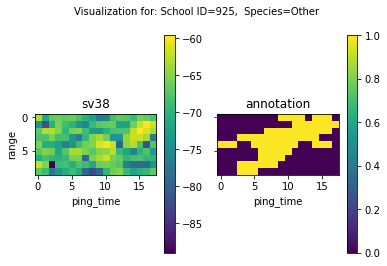

Species=Other; ID=929; N=55.0; m_sv38=9.97918e-08; m_r18=8.477837; m_r70=2.1217487
Species=Other; ID=930; N=181.0; m_sv38=2.992993e-06; m_r18=10.723384; m_r70=11.700078
Species=Other; ID=931; N=684.0; m_sv38=2.0010324e-07; m_r18=0.7225812; m_r70=1.694034
Species=Other; ID=932; N=93.0; m_sv38=1.4964598e-07; m_r18=7.7590756; m_r70=5.501257
Species=Other; ID=935; N=14.0; m_sv38=6.015053e-08; m_r18=1.3285981; m_r70=1.1950823
Species=Sandeel; ID=936; N=79.0; m_sv38=3.1890937e-07; m_r18=0.43046615; m_r70=0.87416375
Species=Other; ID=937; N=67.0; m_sv38=9.4883256e-07; m_r18=5.286333; m_r70=3.1867192
Species=Sandeel; ID=938; N=161.0; m_sv38=2.9655953e-07; m_r18=2.7175152; m_r70=4.404022
Species=Other; ID=939; N=182.0; m_sv38=1.8874412e-07; m_r18=2.9188712; m_r70=3.6680446
Species=Other; ID=940; N=487.0; m_sv38=1.9082267e-07; m_r18=8.173832; m_r70=2.9399214


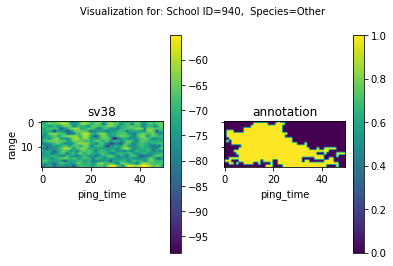

Species=Other; ID=941; N=77.0; m_sv38=7.6186564e-07; m_r18=66.22918; m_r70=35.122295
Species=Other; ID=942; N=32.0; m_sv38=2.2680948e-07; m_r18=0.55723643; m_r70=5.501404
Species=Other; ID=943; N=79.0; m_sv38=4.3174427e-07; m_r18=1.176274; m_r70=1.4427475
Species=Other; ID=944; N=93.0; m_sv38=7.044228e-08; m_r18=5.3312087; m_r70=6.8670683
Species=Other; ID=945; N=82.0; m_sv38=6.9886234e-08; m_r18=2.8646307; m_r70=3.086611
Species=Sandeel; ID=946; N=34.0; m_sv38=2.2573947e-07; m_r18=3.1268542; m_r70=4.5186467
Species=Other; ID=947; N=61.0; m_sv38=7.0450945e-08; m_r18=6.6651964; m_r70=1.2847626
Species=Other; ID=948; N=89.0; m_sv38=1.9107055e-07; m_r18=7.8217106; m_r70=9.061453
Species=Other; ID=949; N=172.0; m_sv38=1.14062544e-07; m_r18=4.4793377; m_r70=7.2764525
Species=Other; ID=950; N=134.0; m_sv38=1.8366426e-07; m_r18=4.695267; m_r70=2.5813193


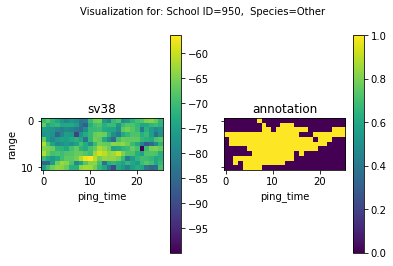

Species=Sandeel; ID=955; N=40.0; m_sv38=1.1335153e-06; m_r18=1.1145606; m_r70=11.806835
Species=Other; ID=956; N=38.0; m_sv38=1.7205446e-07; m_r18=10.390922; m_r70=35.435596
Species=Other; ID=957; N=57.0; m_sv38=7.244753e-07; m_r18=4.327987; m_r70=4.8829403
Species=Sandeel; ID=958; N=47.0; m_sv38=1.07269905e-07; m_r18=0.59503025; m_r70=6.459078
Species=Sandeel; ID=962; N=54.0; m_sv38=1.8655307e-07; m_r18=0.93330646; m_r70=1.374838
Species=Sandeel; ID=964; N=49.0; m_sv38=2.4292672e-07; m_r18=1.6217366; m_r70=0.91843575
Species=Sandeel; ID=965; N=53.0; m_sv38=3.6333333e-07; m_r18=2.4436815; m_r70=1.2888066
Species=Other; ID=966; N=59.0; m_sv38=7.2503404e-08; m_r18=14.321651; m_r70=3.292831
Species=Other; ID=967; N=125.0; m_sv38=1.7150057e-07; m_r18=11.898118; m_r70=2.7241924
Species=Sandeel; ID=968; N=95.0; m_sv38=7.540812e-08; m_r18=0.4308173; m_r70=5.6397996


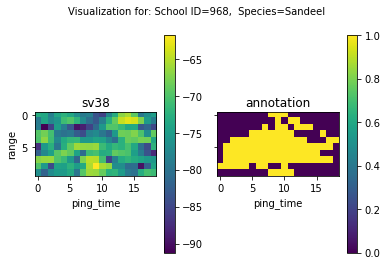

Species=Sandeel; ID=969; N=54.0; m_sv38=3.9532276e-07; m_r18=1.89741; m_r70=0.9552846
Species=Sandeel; ID=970; N=58.0; m_sv38=3.3858432e-06; m_r18=6.737478; m_r70=8.057948
Species=Other; ID=971; N=108.0; m_sv38=1.4784972e-07; m_r18=10.612727; m_r70=10.166639
Species=Other; ID=972; N=316.0; m_sv38=1.880166e-05; m_r18=6.030183; m_r70=5.289497
Species=Other; ID=975; N=159.0; m_sv38=5.523061e-06; m_r18=28.269203; m_r70=10.893188
Species=Other; ID=976; N=18.0; m_sv38=2.771546e-07; m_r18=2.7438443; m_r70=1.5540386
Species=Other; ID=977; N=130.0; m_sv38=1.2723482e-05; m_r18=5.1349664; m_r70=1.6571547
Species=Other; ID=978; N=545.0; m_sv38=1.3305772e-07; m_r18=112.506325; m_r70=13.390627
Species=Other; ID=979; N=134.0; m_sv38=7.6984556e-08; m_r18=6.458047; m_r70=3.4599574
Species=Other; ID=980; N=57.0; m_sv38=3.2746036e-06; m_r18=7.7761073; m_r70=1.4538175


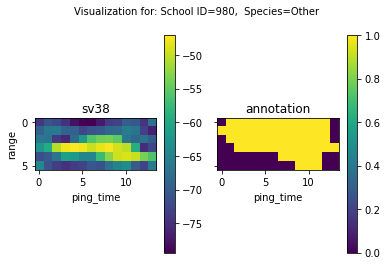

Species=Other; ID=981; N=258.0; m_sv38=7.65034e-08; m_r18=148.523; m_r70=37.481106
Species=Other; ID=982; N=536.0; m_sv38=8.5189996e-08; m_r18=21.419973; m_r70=5.6276035
Species=Sandeel; ID=984; N=22.0; m_sv38=2.4971598e-07; m_r18=0.27767235; m_r70=2.0852814
Species=Other; ID=985; N=36.0; m_sv38=6.93137e-08; m_r18=0.8764636; m_r70=20.655067
Species=Other; ID=986; N=98.0; m_sv38=3.8476963e-07; m_r18=13.710608; m_r70=6.3079205
Species=Other; ID=987; N=39.0; m_sv38=8.858011e-06; m_r18=3.3808665; m_r70=12.589565
Species=Other; ID=991; N=36.0; m_sv38=5.5356886e-06; m_r18=1.28233; m_r70=1.9846153
Species=Other; ID=992; N=87.0; m_sv38=1.5346497e-07; m_r18=10.448476; m_r70=11.697234
Species=Other; ID=994; N=78.0; m_sv38=4.1291823e-06; m_r18=2.880575; m_r70=0.77955604
Species=Other; ID=995; N=130.0; m_sv38=5.7465223e-07; m_r18=5.5548806; m_r70=3.010485


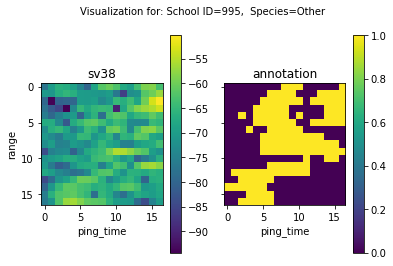

Species=Sandeel; ID=997; N=80.0; m_sv38=1.7655198e-07; m_r18=2.402301; m_r70=10.160754
Species=Other; ID=998; N=43.0; m_sv38=6.167601e-08; m_r18=1.9562396; m_r70=18.89797
Species=Other; ID=999; N=54.0; m_sv38=6.849674e-08; m_r18=7.1053677; m_r70=2.305304
Species=Other; ID=1000; N=28.0; m_sv38=3.3492773e-07; m_r18=5.1481934; m_r70=2.5356584
Species=Sandeel; ID=1001; N=50.0; m_sv38=1.0561921e-07; m_r18=1.164253; m_r70=2.6106884
Species=Other; ID=1002; N=132.0; m_sv38=1.682251e-05; m_r18=12.97161; m_r70=35.74501
Species=Other; ID=1004; N=20.0; m_sv38=1.2394928e-06; m_r18=3.7635581; m_r70=1.6513445
Species=Other; ID=1005; N=147.0; m_sv38=8.962137e-06; m_r18=3.0638518; m_r70=2.9673305
Species=Other; ID=1006; N=1409.0; m_sv38=0.00021883263; m_r18=79.59172; m_r70=15.186961
Species=Other; ID=1007; N=202.0; m_sv38=4.5715766e-05; m_r18=3.9241896; m_r70=2.4686189


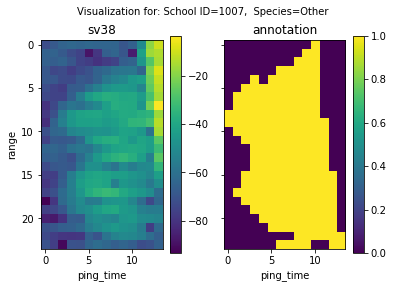

Species=Sandeel; ID=1008; N=67.0; m_sv38=7.041214e-07; m_r18=1.7280111; m_r70=1.6311421
Species=Other; ID=1009; N=73.0; m_sv38=1.1974165e-05; m_r18=2.1466322; m_r70=2.359596
Species=Sandeel; ID=1010; N=47.0; m_sv38=2.1856073e-07; m_r18=0.1284884; m_r70=0.79773885
Species=Other; ID=1011; N=37.0; m_sv38=3.3365276e-07; m_r18=2.6751058; m_r70=2.5006268
Species=Other; ID=1012; N=18.0; m_sv38=1.3348833e-06; m_r18=5.2532425; m_r70=11.3054085
Species=Other; ID=1013; N=179.0; m_sv38=9.455182e-08; m_r18=26.74449; m_r70=9.211655
Species=Other; ID=1014; N=898.0; m_sv38=2.0952757e-06; m_r18=192.42178; m_r70=9.745105
Species=Other; ID=1015; N=116.0; m_sv38=1.3278815e-06; m_r18=23.244453; m_r70=5.753759
Species=Other; ID=1016; N=406.0; m_sv38=2.0686262e-07; m_r18=3.7414794; m_r70=1.4686698
Species=Other; ID=1017; N=123.0; m_sv38=5.4571615e-08; m_r18=10.213875; m_r70=5.0596404


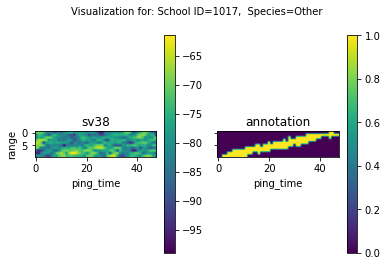

Species=Other; ID=1018; N=128.0; m_sv38=3.2528164e-06; m_r18=8.834546; m_r70=6.1588798
Species=Other; ID=1019; N=28.0; m_sv38=1.3426835e-06; m_r18=4.3671284; m_r70=2.2591171
Species=Other; ID=1020; N=33.0; m_sv38=1.3998658e-07; m_r18=2.7298973; m_r70=1.3007665
Species=Other; ID=1021; N=164.0; m_sv38=2.5229603e-05; m_r18=6.5418997; m_r70=22.409101
Species=Other; ID=1022; N=158.0; m_sv38=5.146593e-06; m_r18=5.5766387; m_r70=3.9659212
Species=Other; ID=1023; N=389.0; m_sv38=2.3328957e-05; m_r18=7.3572316; m_r70=4.3598948
Species=Other; ID=1024; N=108.0; m_sv38=3.0710346e-06; m_r18=2.902797; m_r70=2.5232584
Species=Other; ID=1025; N=28.0; m_sv38=6.2213684e-07; m_r18=3.2723212; m_r70=2.2422957
Species=Other; ID=1027; N=184.0; m_sv38=1.2472289e-07; m_r18=6.323971; m_r70=2.3353624
Species=Other; ID=1028; N=70.0; m_sv38=6.763715e-07; m_r18=29.79847; m_r70=20.139145


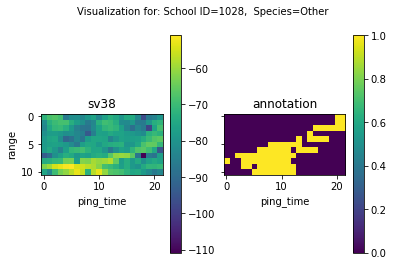

Species=Other; ID=1029; N=152.0; m_sv38=3.1392776e-06; m_r18=122.506874; m_r70=16.340605
Species=Other; ID=1031; N=169.0; m_sv38=1.4232938e-07; m_r18=12.72104; m_r70=4.5816345
Species=Other; ID=1032; N=53.0; m_sv38=1.9691718e-06; m_r18=15.595175; m_r70=2.364233
Species=Other; ID=1033; N=202.0; m_sv38=1.7336442e-05; m_r18=71.60801; m_r70=6.10851
Species=Other; ID=1034; N=104.0; m_sv38=3.086591e-06; m_r18=3.357277; m_r70=4.319021
Species=Other; ID=1035; N=27.0; m_sv38=9.313471e-07; m_r18=15.78065; m_r70=6.628346
Species=Other; ID=1036; N=43.0; m_sv38=4.7959287e-07; m_r18=3.9224665; m_r70=1.8997833
Species=Other; ID=1037; N=116.0; m_sv38=1.0855377e-05; m_r18=37.04586; m_r70=3.8213043
Species=Other; ID=1038; N=512.0; m_sv38=1.3942787e-05; m_r18=15.025863; m_r70=9.389476
Species=Other; ID=1039; N=16.0; m_sv38=1.9597411e-07; m_r18=6.3154244; m_r70=1.4644597


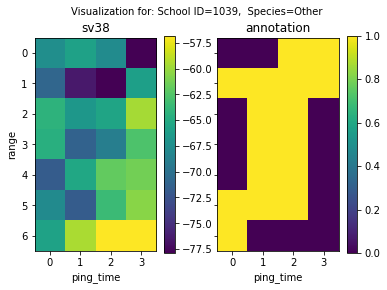

Species=Other; ID=1040; N=7.0; m_sv38=4.248162e-07; m_r18=13.602447; m_r70=23.220993
Species=Other; ID=1041; N=876.0; m_sv38=1.33654685e-05; m_r18=7.980192; m_r70=5.018995
Species=Other; ID=1042; N=53.0; m_sv38=5.8492844e-07; m_r18=4.2237773; m_r70=1.8332505
Species=Other; ID=1043; N=139.0; m_sv38=4.4711078e-07; m_r18=3.0911005; m_r70=1.856649
Species=Other; ID=1045; N=34.0; m_sv38=1.7722059e-06; m_r18=6.1159234; m_r70=5.6125865
Species=Other; ID=1046; N=31.0; m_sv38=5.0062127e-08; m_r18=2.0144556; m_r70=1.8919603
Species=Sandeel; ID=1047; N=363.0; m_sv38=1.240178e-07; m_r18=3.1140015; m_r70=2.0382464
Species=Other; ID=1048; N=45.0; m_sv38=1.2543816e-06; m_r18=3.928963; m_r70=8.832016
Species=Other; ID=1049; N=375.0; m_sv38=1.7019383e-07; m_r18=9.383907; m_r70=8.53701
Species=Other; ID=1050; N=157.0; m_sv38=1.5997699e-07; m_r18=12.950063; m_r70=2.9085796


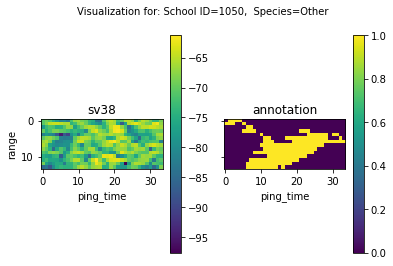

Species=Other; ID=1051; N=67.0; m_sv38=2.431409e-06; m_r18=74.33695; m_r70=27.879059
Species=Sandeel; ID=1052; N=37.0; m_sv38=9.3985807e-07; m_r18=0.6310167; m_r70=2.775493
Species=Other; ID=1054; N=2494.0; m_sv38=1.678147e-05; m_r18=165.93912; m_r70=4.1715455
Species=Other; ID=1055; N=231.0; m_sv38=1.49406715e-05; m_r18=77.31227; m_r70=309.16275
Species=Other; ID=1057; N=128.0; m_sv38=6.209073e-08; m_r18=4.0758305; m_r70=2.596624
Species=Other; ID=1059; N=531.0; m_sv38=6.3692237e-06; m_r18=16.571482; m_r70=7.8184733
Species=Other; ID=1060; N=381.0; m_sv38=1.14897475e-05; m_r18=15.633839; m_r70=9.958172
Species=Other; ID=1061; N=258.0; m_sv38=2.3754637e-06; m_r18=8.940365; m_r70=3.6523812
Species=Other; ID=1062; N=500.0; m_sv38=7.259629e-08; m_r18=100.318634; m_r70=16.228144
Species=Sandeel; ID=1063; N=136.0; m_sv38=4.7089657e-08; m_r18=2.0991242; m_r70=23.597977


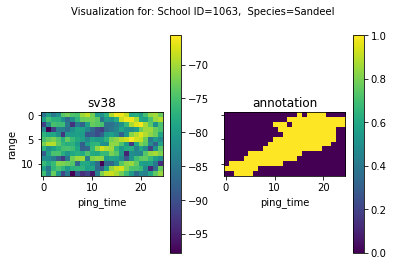

Species=Other; ID=1064; N=85.0; m_sv38=2.2441538e-08; m_r18=4.3044457; m_r70=3.7761798
Species=Other; ID=1065; N=355.0; m_sv38=9.503848e-06; m_r18=8.367047; m_r70=9.126101
Species=Other; ID=1066; N=172.0; m_sv38=5.991348e-08; m_r18=13.604262; m_r70=7.9454713
Species=Other; ID=1067; N=736.0; m_sv38=8.173191e-08; m_r18=16.811737; m_r70=6.8971953
Species=Other; ID=1069; N=69.0; m_sv38=5.861326e-07; m_r18=4.9911027; m_r70=6.0557137
Species=Other; ID=1070; N=198.0; m_sv38=1.2663635e-07; m_r18=19.01838; m_r70=3.8490055
Species=Other; ID=1075; N=413.0; m_sv38=9.839719e-06; m_r18=4.0656266; m_r70=5.3504004
Species=Other; ID=1076; N=270.0; m_sv38=6.6536486e-06; m_r18=5108.622; m_r70=617.55475
Species=Other; ID=1077; N=474.0; m_sv38=5.1517967e-05; m_r18=20.647837; m_r70=4.4180403
Species=Other; ID=1078; N=132.0; m_sv38=4.231824e-06; m_r18=76.887695; m_r70=19.12658


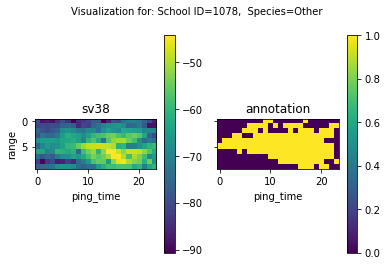

Species=Other; ID=1079; N=105.0; m_sv38=3.731052e-05; m_r18=61.251354; m_r70=29.550985
Species=Other; ID=1080; N=145.0; m_sv38=5.366741e-07; m_r18=36.126873; m_r70=4.129033
Species=Other; ID=1081; N=245.0; m_sv38=1.363775e-07; m_r18=8.741784; m_r70=4.0719404
Species=Other; ID=1082; N=151.0; m_sv38=1.0468582e-07; m_r18=15.38514; m_r70=4.1410995
Species=Other; ID=1083; N=116.0; m_sv38=8.053808e-08; m_r18=12.707022; m_r70=5.7309275
Species=Other; ID=1084; N=265.0; m_sv38=3.5928322e-06; m_r18=3.4881947; m_r70=2.6399965
Species=Other; ID=1085; N=54.0; m_sv38=1.1358079e-05; m_r18=5.608079; m_r70=0.81660813
Species=Other; ID=1086; N=495.0; m_sv38=1.7438403e-07; m_r18=30.240358; m_r70=4.319317
Species=Other; ID=1087; N=277.0; m_sv38=7.098118e-08; m_r18=8.711454; m_r70=21.125002
Species=Other; ID=1088; N=260.0; m_sv38=3.7261935e-07; m_r18=5.7971454; m_r70=1.7815132


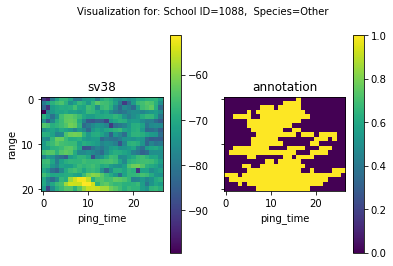

Species=Other; ID=1089; N=64.0; m_sv38=1.1231175e-07; m_r18=5.6403074; m_r70=1.9665781
Species=Other; ID=1090; N=22.0; m_sv38=1.3599508e-07; m_r18=0.3213724; m_r70=0.6971559
Species=Sandeel; ID=1091; N=44.0; m_sv38=1.1941864e-07; m_r18=1.6953597; m_r70=4.334829
Species=Other; ID=1092; N=44.0; m_sv38=1.5442188e-07; m_r18=33.318577; m_r70=5.5460696
Species=Other; ID=1093; N=126.0; m_sv38=1.3850347e-06; m_r18=16.627281; m_r70=1.2637463
Species=Other; ID=1094; N=115.0; m_sv38=3.879487e-06; m_r18=0.91959023; m_r70=2.3487236
Species=Other; ID=1095; N=39.0; m_sv38=2.3009586e-07; m_r18=39.702396; m_r70=1.1332899
Species=Other; ID=1096; N=95.0; m_sv38=1.5982342e-06; m_r18=13.595513; m_r70=11.734686
Species=Other; ID=1097; N=422.0; m_sv38=5.3988883e-06; m_r18=68.29439; m_r70=12.126228
Species=Other; ID=1098; N=54.0; m_sv38=2.8019456e-06; m_r18=9.731249; m_r70=2.0326571


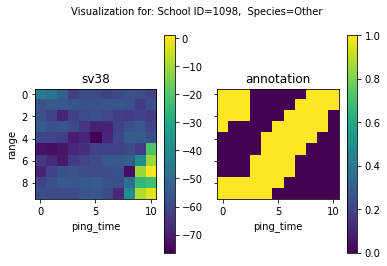

Species=Other; ID=1099; N=30.0; m_sv38=5.201638e-07; m_r18=3.1476605; m_r70=6.9357963
Species=Other; ID=1100; N=113.0; m_sv38=1.2558172e-07; m_r18=2.3372293; m_r70=1.4042207
Species=Other; ID=1101; N=115.0; m_sv38=1.2835298e-07; m_r18=8.267454; m_r70=1.0503806
Species=Sandeel; ID=1103; N=36.0; m_sv38=1.425e-06; m_r18=1.5612719; m_r70=2.12218
Species=Other; ID=1104; N=50.0; m_sv38=3.849214e-07; m_r18=34.985313; m_r70=3.628236
Species=Other; ID=1105; N=74.0; m_sv38=3.2599604e-07; m_r18=8.828949; m_r70=1.0612293
Species=Other; ID=1106; N=74.0; m_sv38=1.4472207e-06; m_r18=0.5240672; m_r70=1.1150539
Species=Other; ID=1107; N=86.0; m_sv38=1.2878844e-07; m_r18=30.637287; m_r70=3.2354975
Species=Other; ID=1108; N=50.0; m_sv38=9.567703e-08; m_r18=10.713288; m_r70=4.679954
Species=Other; ID=1109; N=96.0; m_sv38=2.6287896e-07; m_r18=13.468891; m_r70=5.231851


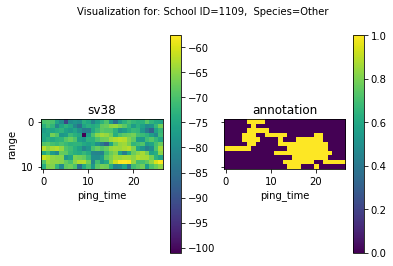

Species=Other; ID=1111; N=28.0; m_sv38=8.809032e-08; m_r18=2.1440012; m_r70=1.3860505
Species=Other; ID=1112; N=52.0; m_sv38=1.03558854e-07; m_r18=1.148164; m_r70=3.6362538
Species=Other; ID=1113; N=92.0; m_sv38=8.7658535e-08; m_r18=5.5835347; m_r70=2.4603248
Species=Other; ID=1114; N=114.0; m_sv38=1.3363979e-07; m_r18=7.0276976; m_r70=1.2841648
Species=Other; ID=1115; N=160.0; m_sv38=2.1875732e-07; m_r18=5.5052896; m_r70=3.4900825
Species=Other; ID=1116; N=154.0; m_sv38=2.3507442e-07; m_r18=2.7464187; m_r70=3.2117233
Species=Other; ID=1117; N=2911.0; m_sv38=6.86842e-05; m_r18=95.75696; m_r70=11.285828
Species=Other; ID=1118; N=185.0; m_sv38=1.7961329e-05; m_r18=19.394142; m_r70=1.9559377
Species=Other; ID=1119; N=252.0; m_sv38=3.28614e-05; m_r18=26.181063; m_r70=12.899866
Species=Other; ID=1120; N=993.0; m_sv38=2.8584129e-05; m_r18=17.820934; m_r70=6.137598


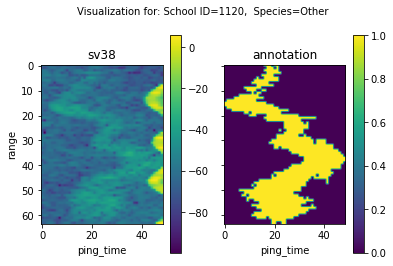

Species=Other; ID=1121; N=54.0; m_sv38=5.6415647e-06; m_r18=2.5314887; m_r70=10.575535
Species=Other; ID=1122; N=329.0; m_sv38=1.2337615e-05; m_r18=32.90477; m_r70=3.9144201
Species=Other; ID=1124; N=3.0; m_sv38=6.9247227e-07; m_r18=1.420319; m_r70=0.1125102
Species=Other; ID=1125; N=26.0; m_sv38=1.9923082e-06; m_r18=6.634345; m_r70=2.7794816
Species=Other; ID=1126; N=26.0; m_sv38=1.5955504e-06; m_r18=7.750203; m_r70=1.5384066
Species=Other; ID=1127; N=235.0; m_sv38=5.71216e-06; m_r18=74.541985; m_r70=5.3289146
Species=Sandeel; ID=1128; N=48.0; m_sv38=2.0095056e-06; m_r18=1.6169019; m_r70=0.73316413
Species=Other; ID=1133; N=218.0; m_sv38=2.5712056e-05; m_r18=23.946554; m_r70=13.4355545
Species=Other; ID=1138; N=117.0; m_sv38=6.1638553e-07; m_r18=42.244884; m_r70=1.9454032
Species=Other; ID=1139; N=24.0; m_sv38=2.3062748e-06; m_r18=17.54626; m_r70=1.240205


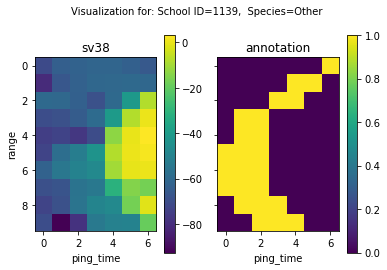

Species=Other; ID=1141; N=142.0; m_sv38=5.5173386e-06; m_r18=29.468166; m_r70=2.4038162
Species=Other; ID=1142; N=179.0; m_sv38=1.0233894e-05; m_r18=29.114334; m_r70=8.01507
Species=Other; ID=1143; N=171.0; m_sv38=5.2594382e-06; m_r18=21.464159; m_r70=2.1491144
Species=Other; ID=1144; N=376.0; m_sv38=6.5325744e-06; m_r18=10.536681; m_r70=4.313024
Species=Other; ID=1145; N=266.0; m_sv38=8.194075e-06; m_r18=6.5049477; m_r70=2.768056
Species=Other; ID=1146; N=162.0; m_sv38=3.0969514e-07; m_r18=15.346355; m_r70=5.2572665
Species=Other; ID=1147; N=171.0; m_sv38=1.5649925e-07; m_r18=18.73216; m_r70=12.086078
Species=Other; ID=1148; N=92.0; m_sv38=8.887882e-08; m_r18=11.002935; m_r70=4.5209007
Species=Other; ID=1149; N=157.0; m_sv38=1.3173643e-07; m_r18=5.855281; m_r70=4.75661
Species=Other; ID=1150; N=111.0; m_sv38=1.4629508e-07; m_r18=3.3194907; m_r70=2.0934281


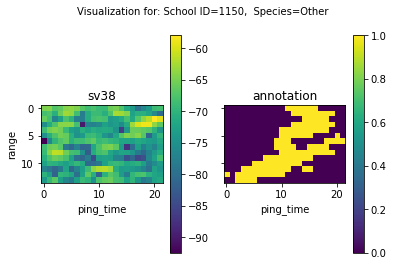

Species=Sandeel; ID=1151; N=54.0; m_sv38=6.509904e-08; m_r18=2.9185085; m_r70=3.265118
Species=Other; ID=1152; N=787.0; m_sv38=1.2466493e-06; m_r18=58.56617; m_r70=2.5717366
Species=Other; ID=1153; N=114.0; m_sv38=1.4633677e-07; m_r18=2.961872; m_r70=2.0260172
Species=Other; ID=1154; N=59.0; m_sv38=8.342096e-08; m_r18=2.8720624; m_r70=2.4816856
Species=Other; ID=1155; N=190.0; m_sv38=1.12145635e-07; m_r18=3.7579088; m_r70=3.1320403
Species=Other; ID=1156; N=573.0; m_sv38=1.9491297e-07; m_r18=9.784922; m_r70=2.5844998
Species=Other; ID=1157; N=287.0; m_sv38=8.4583365e-07; m_r18=128.69336; m_r70=6.5787377
Species=Other; ID=1158; N=175.0; m_sv38=2.9359916e-07; m_r18=11.183492; m_r70=1.759373
Species=Other; ID=1159; N=202.0; m_sv38=6.384069e-06; m_r18=53.38196; m_r70=1.5012234
Species=Other; ID=1160; N=44.0; m_sv38=1.2319036e-06; m_r18=5.7341027; m_r70=0.6787751


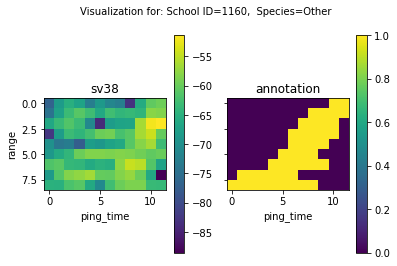

Species=Other; ID=1161; N=415.0; m_sv38=7.9036016e-07; m_r18=12.429127; m_r70=1.6922493
Species=Other; ID=1162; N=648.0; m_sv38=8.9327905e-06; m_r18=15.32707; m_r70=3.8592978
Species=Other; ID=1163; N=428.0; m_sv38=1.5983975e-06; m_r18=130.9733; m_r70=67.1687
Species=Other; ID=1164; N=117.0; m_sv38=0.00017477195; m_r18=114.58213; m_r70=20.828236
Species=Other; ID=1165; N=325.0; m_sv38=5.1983316e-06; m_r18=9.005926; m_r70=1.9778993
Species=Other; ID=1166; N=178.0; m_sv38=3.2517526e-06; m_r18=17.075203; m_r70=2.6689088
Species=Other; ID=1167; N=338.0; m_sv38=7.258036e-05; m_r18=477.89386; m_r70=18.828081
Species=Other; ID=1168; N=1602.0; m_sv38=3.525571e-06; m_r18=81.45333; m_r70=6.977166
Species=Other; ID=1169; N=83.0; m_sv38=1.7003307e-05; m_r18=267.3958; m_r70=34.204956
Species=Other; ID=1170; N=49.0; m_sv38=0.0004102734; m_r18=35.218006; m_r70=28.53267


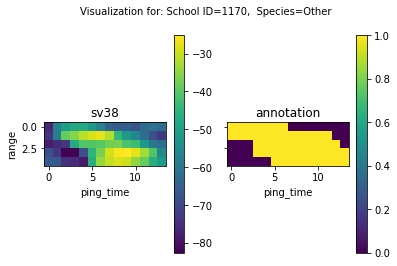

Species=Other; ID=1171; N=79.0; m_sv38=2.8132907e-05; m_r18=39.670963; m_r70=8.074831
Species=Other; ID=1172; N=898.0; m_sv38=2.5568464e-05; m_r18=107.429245; m_r70=7.7829638
Species=Other; ID=1173; N=390.0; m_sv38=3.4391218e-05; m_r18=129.50838; m_r70=6.7429442
Species=Other; ID=1174; N=53.0; m_sv38=3.551214e-05; m_r18=275.5569; m_r70=6.234116
Species=Other; ID=1175; N=59.0; m_sv38=3.3551942e-06; m_r18=7.1112933; m_r70=0.61633605
Species=Other; ID=1176; N=1498.0; m_sv38=7.811618e-06; m_r18=15.402703; m_r70=3.535062
Species=Other; ID=1179; N=21.0; m_sv38=2.3370806e-06; m_r18=3.3939493; m_r70=4.1817455
Species=Other; ID=1180; N=91.0; m_sv38=1.1390881e-05; m_r18=16.188251; m_r70=3.6489325
Species=Other; ID=1181; N=153.0; m_sv38=4.3809064e-06; m_r18=7.4110236; m_r70=2.0861912
Species=Other; ID=1182; N=2945.0; m_sv38=2.3401266e-05; m_r18=24.463741; m_r70=8.643576


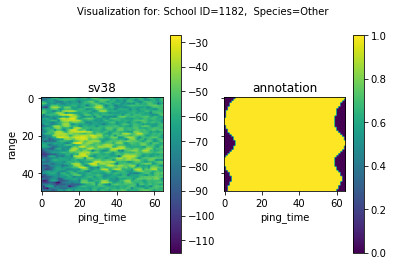

Species=Other; ID=1183; N=334.0; m_sv38=9.805139e-06; m_r18=12.881581; m_r70=2.7172194
Species=Other; ID=1184; N=124.0; m_sv38=3.4154184e-06; m_r18=10.702838; m_r70=2.8379486
Species=Sandeel; ID=1185; N=57.0; m_sv38=4.1604376e-06; m_r18=2.8382103; m_r70=3.8528721
Species=Other; ID=1186; N=86.0; m_sv38=2.9224007e-06; m_r18=4.689394; m_r70=2.9712493
Species=Other; ID=1188; N=61.0; m_sv38=2.4243054e-05; m_r18=5.133224; m_r70=1.4757588
Species=Other; ID=1189; N=37.0; m_sv38=7.1815964e-07; m_r18=4.780687; m_r70=7.0352116
Species=Other; ID=1190; N=31.0; m_sv38=1.041094e-06; m_r18=3.269547; m_r70=6.308623
Species=Other; ID=1191; N=18.0; m_sv38=1.1052927e-06; m_r18=1019.55835; m_r70=13.09354
Species=Other; ID=1192; N=57.0; m_sv38=0.00013438547; m_r18=1087.4482; m_r70=40.611683
Species=Other; ID=1193; N=94.0; m_sv38=5.183355e-06; m_r18=100.231064; m_r70=3.2712233


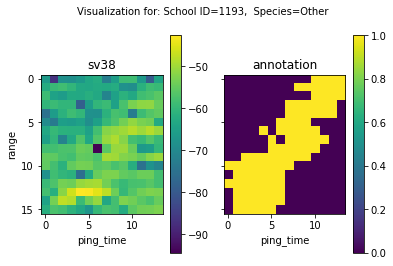

Species=Other; ID=1194; N=59.0; m_sv38=1.6810087e-06; m_r18=24.520712; m_r70=0.6954021
Species=Other; ID=1195; N=45.0; m_sv38=9.608265e-07; m_r18=2.6726596; m_r70=6.0591917
Species=Other; ID=1197; N=224.0; m_sv38=2.1409157e-06; m_r18=8.4490595; m_r70=3.4497027
Species=Other; ID=1198; N=9.0; m_sv38=6.019084e-07; m_r18=8.551865; m_r70=3.329538
Species=Sandeel; ID=1199; N=36.0; m_sv38=9.4158105e-07; m_r18=3.1124673; m_r70=5.068846
Species=Other; ID=1200; N=1149.0; m_sv38=5.2730822e-05; m_r18=104.29966; m_r70=6.6449537
Species=Other; ID=1201; N=35.0; m_sv38=1.4081611e-06; m_r18=5.601253; m_r70=11.492589
Species=Sandeel; ID=1202; N=94.0; m_sv38=1.1805674e-06; m_r18=2.9655826; m_r70=3.4479425
Species=Other; ID=1203; N=27.0; m_sv38=7.4983535e-07; m_r18=9.690522; m_r70=8.46069


In [849]:
import numpy as np
import xarray as xr
import pandas as pd
import pdb

# Data  files
dd = '/data/2019/S2019847_0511/ACOUSTIC/GRIDDED/S2019847_0511'
#dd = '/data/2011/S2011206/ACOUSTIC/GRIDDED/S2011206'

sv_fname = dd+'_sv.zarr'
annotations_fname = dd+'_labels.zarr'
schools_fname = dd+'_labels.parquet.csv'

# Open the files
zarr_grid = xr.open_zarr(sv_fname)
zarr_pred = xr.open_zarr(annotations_fname)
df = pd.read_csv(schools_fname, header=None)

# Loop over schools and extract data
i=0
j=0
schools=[]

for dfi in df[0][1:]:
    ID = int(dfi.split("__",1)[0])
    # Do only school boxes
    if (dfi.split("__",1)[1].split("-")[0]=='School'):
        # Extract data from this school box
        t0 = pd.to_datetime(df[5][i], format='%Y-%m-%d %H:%M:%S').to_numpy()
        t1 = pd.to_datetime(df[6][i], format='%Y-%m-%d %H:%M:%S').to_numpy()
        t_ind = np.where((zarr_grid["ping_time"]>=t0) & (zarr_grid["ping_time"]<=t1))
        if len(t_ind[0])>0:  # Not empty
            r0 = t_ind[0][0]
            r1 = t_ind[0][-1]
            # Get sv data for subset
            sub_sv = zarr_grid["sv"][:,r0:r1,round(float(df[11][i])):round(float(df[12][i]))]
            
            # Get annotations (all classes) for subset
            sub_annot = zarr_pred["annotation"][:,r0:r1,round(float(df[11][i])):round(float(df[12][i]))]
            
            # There is a bug in the object class, so this is a hack to set category
            se_ind = sub_annot.category==27
            other_ind = sub_annot.category==1
            if df[3][i] == '27': #np.sum(sub_annot[se_ind].values)>0:
                C = 'Sandeel'
                annot = sub_annot[se_ind,:]
            elif df[3][i] == '1': #np.sum(sub_annot[other_ind].values)>0:
                C = 'Other'
                annot = sub_annot[other_ind,:]
            else:
                C = 'None'
            if C!='None': #  We only care about the sand eel and other class
                # Mask the sv data with the annotation and threshold the data
                thr = 0  # (TODO: Use threshold from Brautaset paper)
                sv = sub_sv * (annot==1) * (sub_sv>thr)
                # Calculate metrics on sv
                #TODO
                
                # Use the number of pixels for a school as proxy for size (can you find a better
                # metric?)
                N = np.sum(annot.values)
                m_sv38 = np.mean(sv[0,:,:].values[sv[0,:,:].values!=0])
                r18 = ((sub_sv[1,:,:]/sub_sv[0,:,:]) * (annot==1))[:,:,0].values
                r70 = ((sub_sv[2,:,:]/sub_sv[0,:,:]) * (annot==1))[:,:,0].values
                r120 = ((sub_sv[3,:,:]/sub_sv[0,:,:]) * (annot==1))[:,:,0].values
                r200 = ((sub_sv[4,:,:]/sub_sv[0,:,:]) * (annot==1))[:,:,0].values
                r333 = ((sub_sv[5,:,:]/sub_sv[0,:,:]) * (annot==1))[:,:,0].values
                m_r18 =np.mean(r18[r18!=0])
                m_r70 =np.mean(r70[r70!=0])
                m_r120 =np.mean(r120[r120!=0])
                m_r200 =np.mean(r200[r200!=0])
                m_r333 =np.mean(r333[r333!=0])
                
                # Calculate the other stats to add to the data frame (TODO)
                # area of school, relative responses, etc
                print('Species='+C+'; ID='+str(ID)+'; N='+str(N)+'; m_sv38='+str(m_sv38)+
                     '; m_r18='+str(m_r18)+'; m_r70='+str(m_r70))
                schools.append([ID, C, N, m_sv38, m_r18, m_r70, m_r120, m_r200, m_r333])  # Add more school features here
                #
                if j%10 ==0: # Plot and work with an arbitrary school
                    fig, ax = plt.subplots(1, 2, squeeze=False, sharey = True)
                    plt.suptitle('Visualization for: School ID='+str(ID)+',  Species='+C,fontsize=10)
                    ax[0][0].imshow(10*np.log10(sub_sv[0,:,:].values))
                    ax[0][0].set_xlabel('ping_time')
                    ax[0][0].set_ylabel('range')
                    ax[0][0].set_title('sv38')
                    ax[0][1].imshow(annot[0,:,:].values)
                    ax[0][1].set_xlabel('ping_time')
                    ax[0][1].set_title('annotation')
                    plt.colorbar(ax[0][0].imshow(10*np.log10(sub_sv[0,:,:].values)),ax=ax[0][0])
                    plt.colorbar(ax[0][1].imshow(annot[0,:,:].values),ax=ax[0][1])
                    plt.show()
                    
                # Next school
                j=j+1
            
    # Next school or layer
    i=i+1

# Save data frame with data added (TODO)
#save 'schools' to disk
# read the file and do stats on it

In [889]:
pd_schools = pd.DataFrame(np.array(schools), columns=['ID', 'C', 'N', 'm_sv38'
                                                      , 'm_r18', 'm_r70', 'm_r120'
                                                      , 'm_r200', 'm_r333'])
pd_schools = pd_schools[pd_schools != 'nan']
pd_schools = pd_schools.dropna()
pd_schools[['N', 'm_sv38', 'm_r18', 'm_r70', 'm_r120', 'm_r200', 'm_r333']] = pd_schools[['N', 'm_sv38', 'm_r18', 
           'm_r70', 'm_r120', 'm_r200', 'm_r333']].apply(pd.to_numeric, errors='coerce')

In [14]:
# Saving and Loading Created School Data

#pd_schools.to_pickle('pd_schools.pkl')
#pd_schools = pd.read_pickle('pd_schools.pkl')
print(pd_schools.shape)
pd_schools.head()


(1006, 9)


,ID,C,N,m_sv38,m_r18,m_r70,m_r120,m_r200,m_r333
4,25,Other,41.0,2.809137e-07,11.151987,1.174997,1.495168,2.151629,1.920033
5,26,Other,35.0,3.304231e-06,4.451708,2.039347,2.349940,2.003435,1.183700
6,27,Other,197.0,1.219529e-05,5.499165,1.863634,2.335035,1.301454,1.172861
7,28,Other,104.0,4.041521e-06,7.870353,7.215746,35.882076,25.257648,17.755842
8,29,Other,103.0,4.291370e-08,11.824016,3.729390,13.818685,16.050951,8.819009


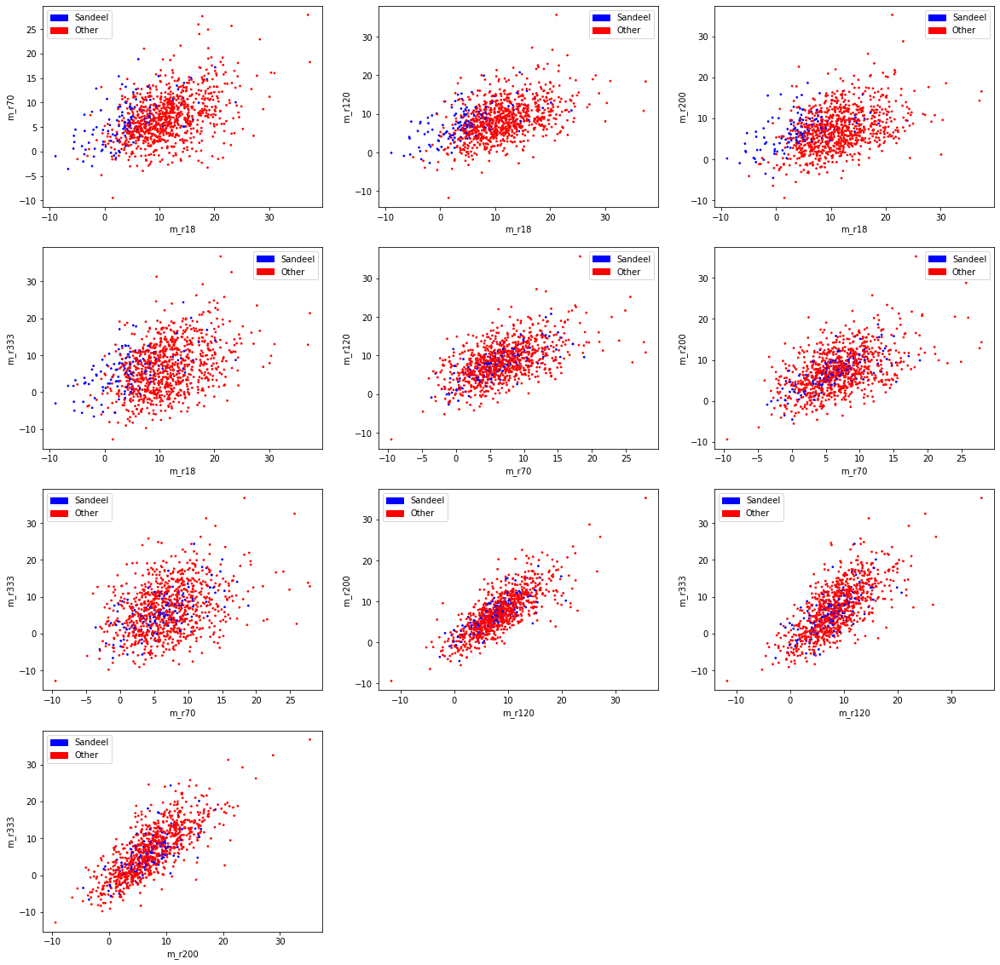

In [7]:
colors = {'Sandeel':'blue', 'Other':'red'}
import matplotlib.patches as mpatches

fig = plt.figure(figsize = (20,20))
plt.subplot(4, 3, 1)
plt.scatter(pd_schools['m_r18'].apply(lambda x: 10*np.log10(x)), 
            pd_schools['m_r70'].apply(lambda x: 10*np.log10(x)),
            c = pd_schools['C'].map(colors), s =3)
plt.xlabel('m_r18')
plt.ylabel('m_r70')
#plt.title('r(Sv)')
red_patch = mpatches.Patch(color='blue', label='Sandeel')
blue_patch = mpatches.Patch(color='red', label='Other')
plt.legend(handles=[red_patch, blue_patch])

plt.subplot(4, 3, 2)
plt.scatter(pd_schools['m_r18'].apply(lambda x: 10*np.log10(x)), 
            pd_schools['m_r120'].apply(lambda x: 10*np.log10(x)),
            c = pd_schools['C'].map(colors), s =3)
plt.xlabel('m_r18')
plt.ylabel('m_r120')
red_patch = mpatches.Patch(color='blue', label='Sandeel')
blue_patch = mpatches.Patch(color='red', label='Other')
plt.legend(handles=[red_patch, blue_patch])

plt.subplot(4, 3, 3)
plt.scatter(pd_schools['m_r18'].apply(lambda x: 10*np.log10(x)), 
            pd_schools['m_r200'].apply(lambda x: 10*np.log10(x)),
            c = pd_schools['C'].map(colors), s =3)
plt.xlabel('m_r18')
plt.ylabel('m_r200')
red_patch = mpatches.Patch(color='blue', label='Sandeel')
blue_patch = mpatches.Patch(color='red', label='Other')
plt.legend(handles=[red_patch, blue_patch])

plt.subplot(4, 3, 4)
plt.scatter(pd_schools['m_r18'].apply(lambda x: 10*np.log10(x)), 
            pd_schools['m_r333'].apply(lambda x: 10*np.log10(x)),
            c = pd_schools['C'].map(colors), s =3)
plt.xlabel('m_r18')
plt.ylabel('m_r333')
red_patch = mpatches.Patch(color='blue', label='Sandeel')
blue_patch = mpatches.Patch(color='red', label='Other')
plt.legend(handles=[red_patch, blue_patch])

plt.subplot(4, 3, 5)
plt.scatter(pd_schools['m_r70'].apply(lambda x: 10*np.log10(x)), 
            pd_schools['m_r120'].apply(lambda x: 10*np.log10(x)),
            c = pd_schools['C'].map(colors), s =3)
plt.xlabel('m_r70')
plt.ylabel('m_r120')
red_patch = mpatches.Patch(color='blue', label='Sandeel')
blue_patch = mpatches.Patch(color='red', label='Other')
plt.legend(handles=[red_patch, blue_patch])

plt.subplot(4, 3, 6)
plt.scatter(pd_schools['m_r70'].apply(lambda x: 10*np.log10(x)), 
            pd_schools['m_r200'].apply(lambda x: 10*np.log10(x)),
            c = pd_schools['C'].map(colors), s =3)
plt.xlabel('m_r70')
plt.ylabel('m_r200')
red_patch = mpatches.Patch(color='blue', label='Sandeel')
blue_patch = mpatches.Patch(color='red', label='Other')
plt.legend(handles=[red_patch, blue_patch])

plt.subplot(4, 3, 7)
plt.scatter(pd_schools['m_r70'].apply(lambda x: 10*np.log10(x)), 
            pd_schools['m_r333'].apply(lambda x: 10*np.log10(x)),
            c = pd_schools['C'].map(colors), s =3)
plt.xlabel('m_r70')
plt.ylabel('m_r333')
red_patch = mpatches.Patch(color='blue', label='Sandeel')
blue_patch = mpatches.Patch(color='red', label='Other')
plt.legend(handles=[red_patch, blue_patch])

plt.subplot(4, 3, 8)
plt.scatter(pd_schools['m_r120'].apply(lambda x: 10*np.log10(x)), 
            pd_schools['m_r200'].apply(lambda x: 10*np.log10(x)),
            c = pd_schools['C'].map(colors), s =3)
plt.xlabel('m_r120')
plt.ylabel('m_r200')
red_patch = mpatches.Patch(color='blue', label='Sandeel')
blue_patch = mpatches.Patch(color='red', label='Other')
plt.legend(handles=[red_patch, blue_patch])

plt.subplot(4, 3, 9)
plt.scatter(pd_schools['m_r120'].apply(lambda x: 10*np.log10(x)), 
            pd_schools['m_r333'].apply(lambda x: 10*np.log10(x)),
            c = pd_schools['C'].map(colors), s =3)
plt.xlabel('m_r120')
plt.ylabel('m_r333')
red_patch = mpatches.Patch(color='blue', label='Sandeel')
blue_patch = mpatches.Patch(color='red', label='Other')
plt.legend(handles=[red_patch, blue_patch])

plt.subplot(4, 3, 10)
plt.scatter(pd_schools['m_r200'].apply(lambda x: 10*np.log10(x)), 
            pd_schools['m_r333'].apply(lambda x: 10*np.log10(x)),
            c = pd_schools['C'].map(colors), s =3)
plt.xlabel('m_r200')
plt.ylabel('m_r333')
red_patch = mpatches.Patch(color='blue', label='Sandeel')
blue_patch = mpatches.Patch(color='red', label='Other')
plt.legend(handles=[red_patch, blue_patch])

plt.show()

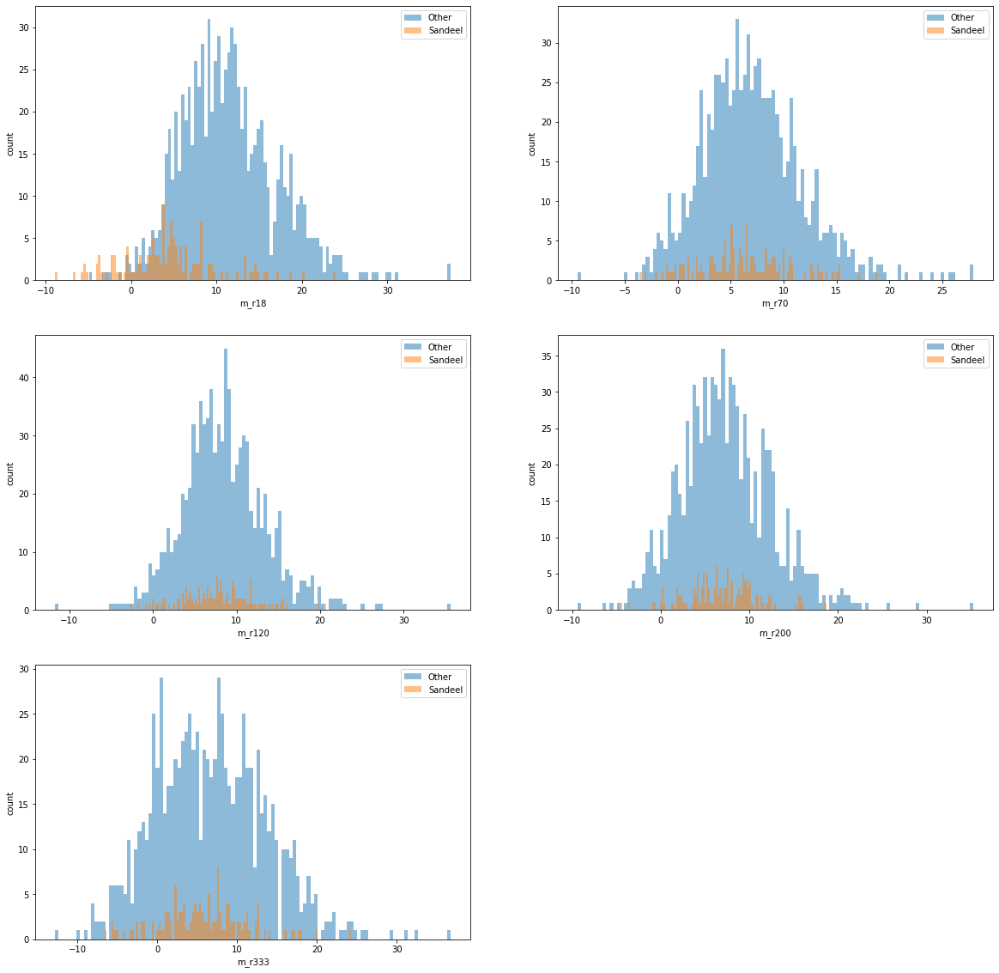

In [8]:
pd_ot = pd_schools[pd_schools['C']=='Other']
pd_se = pd_schools[pd_schools['C']=='Sandeel']

#Calculating r(Sv)
pd_ot = pd_ot[['m_r18','m_r70','m_r120','m_r200','m_r333']].apply(lambda x: 10*np.log10(x))
pd_se = pd_se[['m_r18','m_r70','m_r120','m_r200','m_r333']].apply(lambda x: 10*np.log10(x))
                                                          


plt.figure(figsize =(20,20))

plt.subplot(3, 2, 1)
#bins = np.linspace(-100, 200, 200)
bins = 110
plt.hist(pd_ot['m_r18'], bins, alpha=0.5, label='Other')
plt.hist(pd_se['m_r18'], bins, alpha=0.5, label='Sandeel')
plt.xlabel('m_r18')
plt.ylabel('count')
plt.legend()

plt.subplot(3, 2, 2)
plt.hist(pd_ot['m_r70'], bins, alpha=0.5, label='Other')
plt.hist(pd_se['m_r70'], bins, alpha=0.5, label='Sandeel')
plt.xlabel('m_r70')
plt.ylabel('count')
plt.legend()

plt.subplot(3, 2, 3)
plt.hist(pd_ot['m_r120'], bins, alpha=0.5, label='Other')
plt.hist(pd_se['m_r120'], bins, alpha=0.5, label='Sandeel')
plt.xlabel('m_r120')
plt.ylabel('count')
plt.legend()

plt.subplot(3, 2, 4)
plt.hist(pd_ot['m_r200'], bins, alpha=0.5, label='Other')
plt.hist(pd_se['m_r200'], bins, alpha=0.5, label='Sandeel')
plt.xlabel('m_r200')
plt.ylabel('count')
plt.legend()

plt.subplot(3, 2, 5)
plt.hist(pd_ot['m_r333'], bins, alpha=0.5, label='Other')
plt.hist(pd_se['m_r333'], bins, alpha=0.5, label='Sandeel')
plt.xlabel('m_r333')
plt.ylabel('count')
plt.legend()



plt.show()

C
Other      873
Sandeel    133
dtype: int64


/home/a39083/.local/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


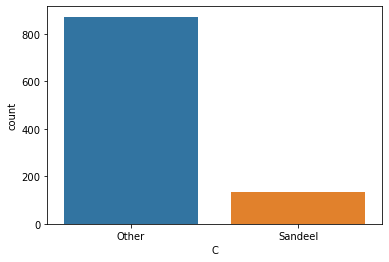

In [26]:
# School Dataframe Inspection

%matplotlib inline
pd_schools_L = pd_schools.copy()
pd_schools_L[['m_sv38','m_r18','m_r70','m_r120','m_r200','m_r333']] = pd_schools_L[['m_sv38','m_r18','m_r70','m_r120','m_r200','m_r333']].apply(lambda x: 10*np.log10(x))
print(pd_schools_L.groupby('C').size()) # Number of Schools
sns.countplot(pd_schools_L['C'],label="Count")
plt.show()

/opt/conda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/tools.py:400: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():


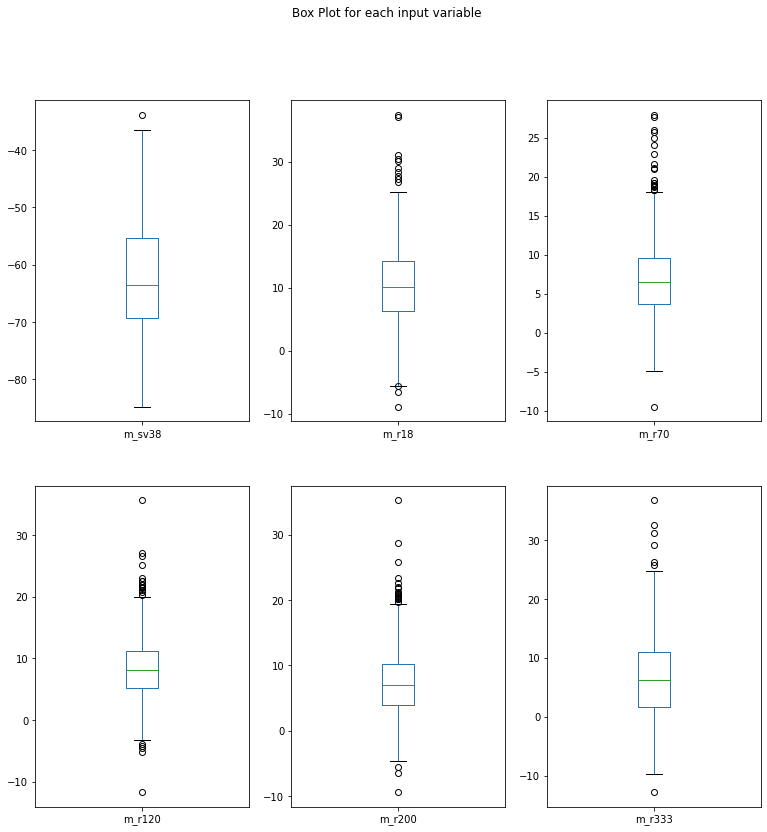

In [29]:
pd_schools_L.drop(['ID','C','N'], axis=1).plot(kind='box', subplots=True, 
                                               layout=(2,3), sharex=False, sharey=False, figsize=(13,13), 
                                        title='Box Plot for each input variable')
plt.show()

Text(0.5, 0.98, 'Scatter-matrix for each input variable')

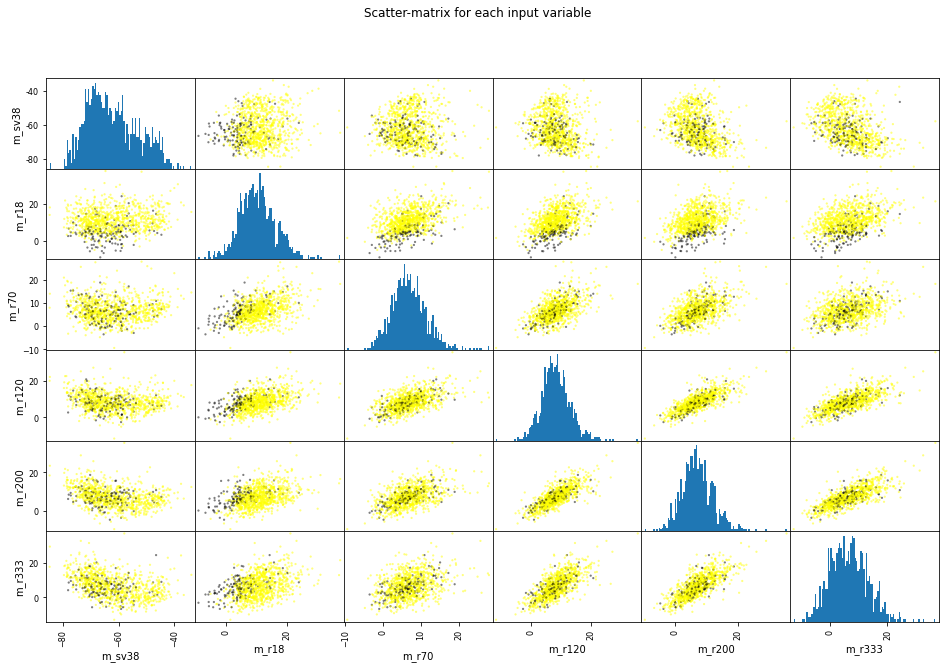

In [49]:
from pandas.plotting import scatter_matrix
from matplotlib import cm
feature_names = ['m_sv38','m_r18','m_r70','m_r120','m_r200','m_r333']
X = pd_schools_L[feature_names]
y = pd_schools_L['C']

f = (lambda x: 1 if x == 'Other' else 0)
y_num = np.fromiter(map(f,y),dtype=np.int)


cmap = cm.get_cmap('gnuplot')
scatter = scatter_matrix(X, c = y_num, marker = 'o', s = 5, hist_kwds={'bins':100}, figsize=(16,10), cmap = cmap)
plt.suptitle('Scatter-matrix for each input variable')

In [94]:
# Train & Test Splits
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [95]:
# Logistic Regression
from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression()
logreg.fit(X_train, y_train)
print('Accuracy of Logistic regression classifier on training set: {:.2f}'
     .format(logreg.score(X_train, y_train)))
print('Accuracy of Logistic regression classifier on test set: {:.2f}'
     .format(logreg.score(X_test, y_test)))

Accuracy of Logistic regression classifier on training set: 0.87
Accuracy of Logistic regression classifier on test set: 0.86


In [96]:
# Decision Tree
from sklearn.tree import DecisionTreeClassifier
clf = DecisionTreeClassifier().fit(X_train, y_train)
print('Accuracy of Decision Tree classifier on training set: {:.2f}'
     .format(clf.score(X_train, y_train)))
print('Accuracy of Decision Tree classifier on test set: {:.2f}'
     .format(clf.score(X_test, y_test)))

Accuracy of Decision Tree classifier on training set: 1.00
Accuracy of Decision Tree classifier on test set: 0.86


In [97]:
# K Nearest Neighbors
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier()
knn.fit(X_train, y_train)
print('Accuracy of K-NN classifier on training set: {:.2f}'
     .format(knn.score(X_train, y_train)))
print('Accuracy of K-NN classifier on test set: {:.2f}'
     .format(knn.score(X_test, y_test)))

Accuracy of K-NN classifier on training set: 0.91
Accuracy of K-NN classifier on test set: 0.88


In [98]:
# Linear Discriminant Analysis
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
lda = LinearDiscriminantAnalysis()
lda.fit(X_train, y_train)
print('Accuracy of LDA classifier on training set: {:.2f}'
     .format(lda.score(X_train, y_train)))
print('Accuracy of LDA classifier on test set: {:.2f}'
     .format(lda.score(X_test, y_test)))

Accuracy of LDA classifier on training set: 0.88
Accuracy of LDA classifier on test set: 0.88


In [99]:
# Gaussian Naive Bayes
from sklearn.naive_bayes import GaussianNB
gnb = GaussianNB()
gnb.fit(X_train, y_train)
print('Accuracy of GNB classifier on training set: {:.2f}'
     .format(gnb.score(X_train, y_train)))
print('Accuracy of GNB classifier on test set: {:.2f}'
     .format(gnb.score(X_test, y_test)))

Accuracy of GNB classifier on training set: 0.90
Accuracy of GNB classifier on test set: 0.87


In [100]:
# Support Vector Machine
from sklearn.svm import SVC
svm = SVC()
svm.fit(X_train, y_train)
print('Accuracy of SVM classifier on training set: {:.2f}'
     .format(svm.score(X_train, y_train)))
print('Accuracy of SVM classifier on test set: {:.2f}'
     .format(svm.score(X_test, y_test)))

Accuracy of SVM classifier on training set: 0.90
Accuracy of SVM classifier on test set: 0.88


In [107]:
# KNN Performance Metrics
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
pred = knn.predict(X_test)
print(confusion_matrix(y_test, pred))
print(classification_report(y_test, pred))

[[211   6]
 [ 25  10]]
              precision    recall  f1-score   support

       Other       0.89      0.97      0.93       217
     Sandeel       0.62      0.29      0.39        35

    accuracy                           0.88       252
   macro avg       0.76      0.63      0.66       252
weighted avg       0.86      0.88      0.86       252



In [108]:
# Expectation Maximization on the Dataset

from sklearn import mixture

from sklearn import metrics
def purity_score(y_true, y_pred):
    # compute contingency matrix (also called confusion matrix)
    contingency_matrix = metrics.cluster.contingency_matrix(y_true, y_pred)
    # return purity
    return np.sum(np.amax(contingency_matrix, axis=0)) / np.sum(contingency_matrix) 


X = pd_schools[['m_sv38','m_r18','m_r70','m_r120','m_r200','m_r333']].apply(lambda x: 10*np.log10(x)).values
#X = pd_schools[['m_r18']].apply(lambda x: 10*np.log10(x)).values
y = pd_schools['C'].values.reshape(len(pd_schools['C'].values),1)
f = (lambda x: 1 if x == 'Other' else 0)
y = np.fromiter(map(f,y),dtype=np.int)

In [114]:
gmm = mixture.GaussianMixture(n_components = 2, covariance_type='full',max_iter=100,init_params='kmeans',
                             random_state=111111)
gmm.fit(X)
yclust=gmm.predict(X)

f = (lambda x: 'Other' if x == 1 else 'Sandeel')
y_ = np.fromiter(map(f,y),dtype=np.int)
yclust_ = np.fromiter(map(f,y_clust),dtype=np.int)

print(confusion_matrix(y, yclust))
print(classification_report(y, yclust))

ValueError: invalid literal for int() with base 10: 'Other'

In [1229]:
np.sum(abs(y - yclust))
len(y)

1006

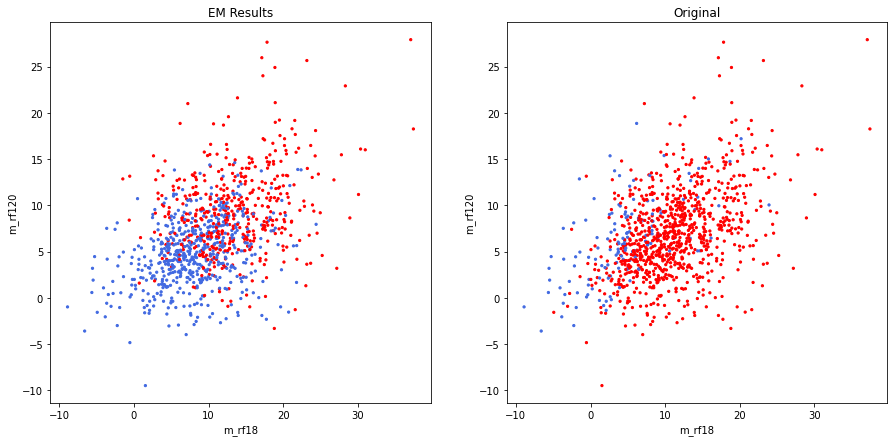

In [1230]:
colors = ['royalblue','red','deeppink', 
          'maroon', 'mediumorchid', 'tan', 'forestgreen', 'olive', 'goldenrod', 'lightcyan', 'navy']
vectorizer = np.vectorize(lambda x: colors[x % len(colors)])

plt.figure(figsize = (15,7))
plt.subplot(1,2,1)
plt.scatter(X[:,1], X[:,2], c = vectorizer(yclust), s = 5)
plt.xlabel('m_rf18')
plt.ylabel('m_rf120')
plt.title('EM Results')

plt.subplot(1,2,2)
plt.scatter(X[:,1], X[:,2], c = vectorizer(y), s = 5)
plt.xlabel('m_rf18')
plt.ylabel('m_rf120')
plt.title('Original')
plt.show()

No handles with labels found to put in legend.


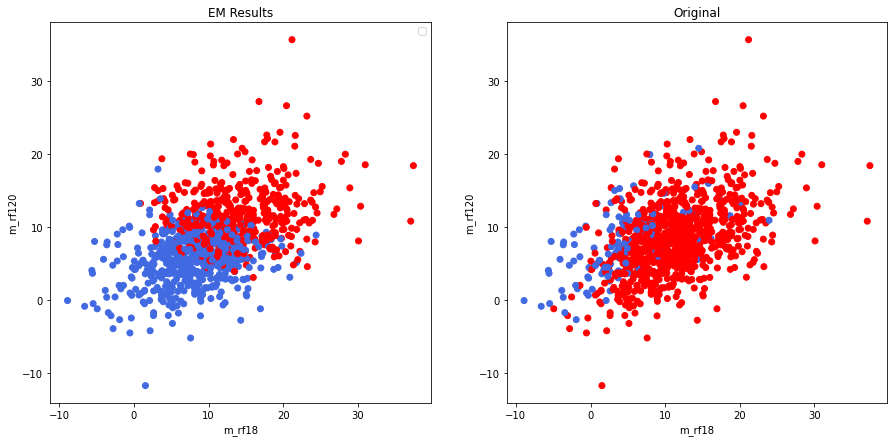

In [1143]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters = 2, init = 'random', max_iter = 300, n_init = 100, random_state = 0)
yclust = kmeans.fit_predict(X)
lab.append('kmeans')
purity_score(y,yclust)

plt.figure(figsize = (15,7))
plt.subplot(1,2,1)
plt.scatter(X[:,0], X[:,2], c = vectorizer(yclust))
plt.xlabel('m_rf18')
plt.ylabel('m_rf120')
plt.title('EM Results')
plt.legend()

plt.subplot(1,2,2)
plt.scatter(X[:,0], X[:,2], c = vectorizer(y))
plt.xlabel('m_rf18')
plt.ylabel('m_rf120')
plt.title('Original')
plt.show()

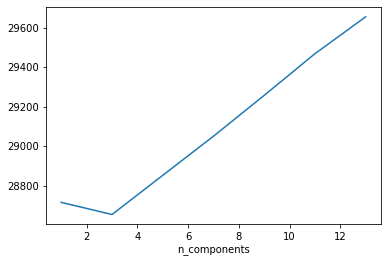

In [1088]:
n_components = np.arange(1, 15,2)
models = [mixture.GaussianMixture(n, covariance_type='full', random_state=0).fit(X)
          for n in n_components]
plt.plot(n_components, [m.bic(X) for m in models], label='BIC')
plt.xlabel('n_components');

In [1200]:
# SVM on fish SChools Data

# Import train_test_split function
from sklearn.model_selection import train_test_split

# Split dataset into training set and test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3,random_state=109) # 70% training and 30% test

In [1201]:
#Import svm model
from sklearn import svm

#Create a svm Classifier
clf = svm.SVC(kernel='linear') # Linear Kernel

#Train the model using the training sets
clf.fit(X_train, y_train)

#Predict the response for test dataset
y_pred = clf.predict(X_test)

In [1202]:
#Import scikit-learn metrics module for accuracy calculation
from sklearn import metrics

# Model Accuracy: how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

Accuracy: 0.8675496688741722


In [1203]:
y_pred.mean()

1.0

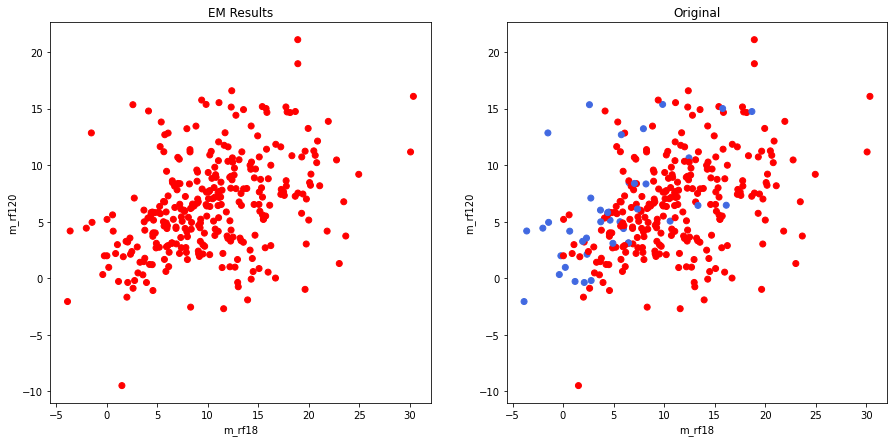

In [1204]:
plt.figure(figsize = (15,7))
plt.subplot(1,2,1)
plt.scatter(X_test[:,1], X_test[:,2], c = vectorizer(y_pred))
plt.xlabel('m_rf18')
plt.ylabel('m_rf120')
plt.title('EM Results')

plt.subplot(1,2,2)
plt.scatter(X_test[:,1], X_test[:,2], c = vectorizer(y_test))
plt.xlabel('m_rf18')
plt.ylabel('m_rf120')
plt.title('Original')
plt.show()

In [430]:
dd = '/data/2019/S2019847_0511/ACOUSTIC/GRIDDED/S2019847_0511'

sv_fname = dd+'_sv.zarr'
annotations_fname = dd+'_labels.zarr'
schools_fname = dd+'_labels.parquet.csv'

zarr_grid = xr.open_zarr(sv_fname)
zarr_pred = xr.open_zarr(annotations_fname)
df = pd.read_csv(schools_fname, header=None)

df

,0,1,2,3,4,5,6,7,8,9,10,11,12
0,ID,object,type,category,proportion,startping,endping,startpingindex,endpingindex,upperdept,lowerdept,upperdeptindex,lowerdeptindex
1,1__Layer-None,1,Layer-None,-1,1,2019-05-11 00:27:05.798000,2019-05-11 04:25:31.313000,0,40599,10.0,122.70765,0,809
2,2__School-6705,2,School-6705,-1,1,2019-05-11 04:41:50.157000,2019-05-11 04:41:55.438000,43384,43399,115.1564,115.726265,551,577
3,3__School-6706,3,School-6706,-1,1,2019-05-11 04:41:57.188000,2019-05-11 04:42:05.626000,43404,43428,118.598854,118.90366,552,589
4,4__Layer-None,4,Layer-None,-1,1,2019-05-11 04:25:31.673000,2019-05-11 04:55:51.470000,40600,45778,10.0,123.06684,0,618
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1201,1201__School-7892,1201,School-7892,27,1,2019-05-11 19:38:04.673000,2019-05-11 19:38:12.407000,196307,196329,102.78707,103.356926,495,506
1202,1202__School-7893,1202,School-7893,1,1,2019-05-11 19:38:07.485000,2019-05-11 19:38:10.298000,196315,196323,100.88105,101.071,488,494
1203,1203__School-7894,1203,School-7894,27,1,2019-05-11 19:38:12.766000,2019-05-11 19:38:17.688000,196330,196344,102.8559,103.42576,500,505
1204,1204__Layer-6772,1204,Layer-6772,-1,1,2019-05-11 19:13:54.079000,2019-05-11 19:41:13.766000,192181,196845,10.0,99.503876,5,529


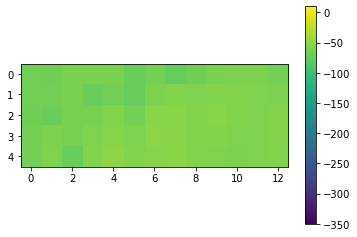

In [599]:
dd = 1203
t0 = pd.to_datetime(df[5][dd], format='%Y-%m-%d %H:%M:%S').to_numpy()
t1 = pd.to_datetime(df[6][dd], format='%Y-%m-%d %H:%M:%S').to_numpy()
t_ind = np.where((zarr_grid["ping_time"]>=t0) & (zarr_grid["ping_time"]<=t1))

len(t_ind[0])
r0 = t_ind[0][0]
r1 = t_ind[0][-1]

d0 = round(float(df[11][dd]))
d1 = round(float(df[12][dd]))

sub_sv = zarr_grid["sv"][:,r0:r1,d0:d1]
plt.imshow(10*np.log10(sub_sv[0,:,:].T.astype(float)), vmin = -350, vmax = 10)
#plt.imshow(sub_sv[0,:,:].T, cmap='viridis')
plt.colorbar()
plt.show()

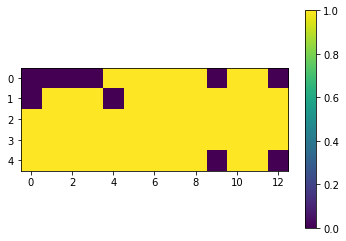

In [600]:
sub_annot = zarr_pred.annotation[:,r0:r1,d0:d1]
plt.imshow(sub_annot[3,:,:].T)
plt.colorbar()
plt.show()

In [559]:
sub_annot[sub_annot.category == 27,:,:].values[0]

array([[0., 0., 1., 1., 1.],
       [0., 1., 1., 1., 1.],
       [0., 1., 1., 1., 1.],
       [0., 1., 1., 1., 1.],
       [1., 0., 1., 1., 1.],
       [1., 1., 1., 1., 1.],
       [1., 1., 1., 1., 1.],
       [1., 1., 1., 1., 1.],
       [1., 1., 1., 1., 1.],
       [0., 1., 1., 1., 0.],
       [1., 1., 1., 1., 1.],
       [1., 1., 1., 1., 1.],
       [0., 1., 1., 1., 0.]], dtype=float32)

In [603]:
se_ind = np.where(sub_annot.category.values==27)[0][0]
other_ind = np.where(sub_annot.category.values==1)[0][0]
annot = sub_annot[se_ind,:,:]

In [639]:
(sub_sv[0,:,:].values)[(annot.values==1) & (sub_sv[0,:,:].values>thr)].mean()

1.413806e-06

In [647]:
a = sub_sv * (annot==1) * (sub_sv>3.0211788e-07)


In [650]:
sub_sv[1,:,:].values

array([[2.16821093e-07, 1.89358840e-08, 3.57363845e-08, 1.88190270e-07,
        5.17447404e-07],
       [1.75067697e-07, 8.55580709e-08, 1.31081762e-07, 1.84157813e-07,
        3.61948821e-07],
       [1.16003029e-07, 4.92467507e-08, 3.42756749e-07, 7.48696380e-07,
        1.23738812e-06],
       [4.87732699e-08, 8.86231035e-08, 3.62810226e-07, 9.24754204e-07,
        1.25086217e-06],
       [1.36835567e-07, 2.10212960e-07, 3.62810226e-07, 3.37746741e-07,
        1.63722717e-07],
       [1.27188912e-07, 1.28771958e-07, 4.77454734e-08, 1.56120521e-07,
        3.07675833e-07],
       [1.43441827e-08, 5.51779422e-08, 2.69358537e-07, 7.11154598e-07,
        8.70240115e-07],
       [3.80188503e-08, 2.54769816e-07, 4.48126428e-07, 7.60959381e-07,
        1.26791133e-06],
       [9.26551067e-08, 1.58193870e-07, 2.22250264e-07, 2.08020055e-07,
        3.31011165e-07],
       [7.57473344e-07, 7.87948295e-07, 1.06294715e-06, 2.00058707e-06,
        1.68940619e-06],
       [3.73643388e-07, 1.0482

In [666]:
np.mean(a[1,:,:].values[a[1,:,:].values>0]) # For each frequency

8.278854e-07

In [ ]:
import numpy as np
import xarray as xr
import pandas as pd
import pdb

# Data  files
#dd = '/data/2019/S2019847/ACOUSTIC/GRIDDED/S2019847'
dd = '/data/2011/S2011206/ACOUSTIC/GRIDDED/S2011206'

sv_fname = dd+'_sv.zarr'
annotations_fname = dd+'_labels.zarr'
schools_fname = dd+'_labels.parquet.csv'

# Open the files
zarr_grid = xr.open_zarr(sv_fname)
zarr_pred = xr.open_zarr(annotations_fname)
df = pd.read_csv(schools_fname, header=None)

# Loop over schools and extract data
i=0
j=0
schools=[]

for dfi in df[0]:
    ID = int(dfi.split("__",1)[0])
    # Do only school boxes
    if (dfi.split("__",1)[1].split("-")[0]=='School'):
        # Extract data from this school box
        t0 = pd.to_datetime(df[2][i], format='%Y-%m-%d %H:%M:%S').to_numpy()
        t1 = pd.to_datetime(df[3][i], format='%Y-%m-%d %H:%M:%S').to_numpy()
        t_ind = np.where((zarr_grid["ping_time"]>=t0) & (zarr_grid["ping_time"]<=t1))
        if len(t_ind[0])>0:  # Not empty
            r0 = t_ind[0][0]
            r1 = t_ind[0][-1]
            # Get sv data for subset
            sub_sv = zarr_grid["sv"][:,r0:r1,df[4][i]:df[5][i]]
            
            # Get annotations (all classes) for subset
            sub_annot = zarr_pred["annotation"][:,r0:r1,df[4][i]:df[5][i]]
            
            # There is a bug in the object class, so this is a hack to set category
            se_ind = sub_annot.category==27
            other_ind = sub_annot.category==1
            if np.sum(sub_annot[se_ind].values)>0:
                C = 'Sandeel'
                annot = sub_annot[se_ind,:]
            elif np.sum(sub_annot[other_ind].values)>0:
                C = 'Other'
                annot = sub_annot[other_ind,:]
            else:
                C = 'None'
            
            
            annot_ot = sub_annot[other_ind,:]
            annot_se = sub_annot[se_ind,:]
            if C!='None': #  We only care about the sand eel and other class
                # Mask the sv data with the annotation and threshold the data
                thr = 0  # (TODO: Use threshold from Brautaset paper)
                sv = sub_sv * (annot==1) * (sub_sv>thr)
                # Calculate metrics on sv
                #TODO
                
                # Use the number of pixels for a school as proxy for size (can you find a better
                # metric?)
                Parq_Class = df[1][i]
                N = np.sum(annot.values)
                N_ot = np.sum(annot_ot.values)
                N_se = np.sum(annot_se.values)
                
                
                # Calculate the other stats to add to the data frame (TODO)
                # area of school, relative responses, etc
                print('Species='+C+'; Parq Class='+str(Parq_Class)+'; ID='+str(ID)+'; N='+str(N)+'; N_other='+str(N_ot)
                     +'; N_sandeel='+str(N_se))
                schools.append([ID, C, Parq_Class, N, N_ot, N_se])  # Add more school features here
                #
                if j==10: # Plot and work with an arbitrary school
                    
                    # Next school
                    j=j+1
            
    # Next school or layer
    i=i+1

# Save data frame with data added (TODO)
#save 'schools' to disk
# read the file and do stats on it

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:16: RuntimeWarning: Failed to open Zarr store with consolidated metadata, falling back to try reading non-consolidated metadata. This is typically much slower for opening a dataset. To silence this warning, consider:
1. Consolidating metadata in this existing store with zarr.consolidate_metadata().
2. Explicitly setting consolidated=False, to avoid trying to read consolidate metadata, or
3. Explicitly setting consolidated=True, to raise an error in this case instead of falling back to try reading non-consolidated metadata.
  app.launch_new_instance()


Species=Other; Parq Class=1.0; ID=8; N=320.0; N_other=320.0; N_sandeel=0.0
Species=Other; Parq Class=1.0; ID=10; N=2345.0; N_other=2345.0; N_sandeel=0.0
Species=Other; Parq Class=1.0; ID=11; N=893.0; N_other=893.0; N_sandeel=0.0
Species=Other; Parq Class=1.0; ID=12; N=807.0; N_other=807.0; N_sandeel=0.0
Species=Other; Parq Class=1.0; ID=14; N=982.0; N_other=982.0; N_sandeel=0.0
Species=Other; Parq Class=1.0; ID=15; N=80.0; N_other=80.0; N_sandeel=0.0
Species=Sandeel; Parq Class=27.0; ID=16; N=48.0; N_other=0.0; N_sandeel=48.0
Species=Sandeel; Parq Class=27.0; ID=18; N=3669.0; N_other=0.0; N_sandeel=3669.0
Species=Sandeel; Parq Class=27.0; ID=19; N=912.0; N_other=0.0; N_sandeel=912.0
Species=Sandeel; Parq Class=27.0; ID=20; N=362.0; N_other=0.0; N_sandeel=362.0
Species=Other; Parq Class=1.0; ID=21; N=200.0; N_other=200.0; N_sandeel=0.0
Species=Other; Parq Class=1.0; ID=22; N=923.0; N_other=923.0; N_sandeel=0.0
Species=Sandeel; Parq Class=27.0; ID=23; N=202.0; N_other=0.0; N_sandeel=202.

In [229]:
sch = pd.DataFrame(schools)
sch.columns = ['ID', 'C', 'Parq_Class', 'N', 'N_ot', 'N_se']

In [230]:
sch

,ID,C,Parq_Class,N,N_ot,N_se
0,8,Other,1.0,320.0,320.0,0.0
1,10,Other,1.0,2345.0,2345.0,0.0
2,11,Other,1.0,893.0,893.0,0.0
3,12,Other,1.0,807.0,807.0,0.0
4,14,Other,1.0,982.0,982.0,0.0
...,...,...,...,...,...,...
3135,3564,Other,1.0,31.0,31.0,0.0
3136,3565,Sandeel,27.0,92.0,0.0,92.0
3137,3566,Sandeel,27.0,57.0,0.0,57.0
3138,3567,Sandeel,27.0,29.0,0.0,29.0


In [323]:
deneme = sch[['C', 'Parq_Class']]
deneme.replace(['Sandeel', 'Other'], [27, 1])
np.nonzero(np.array(deneme['C'] - deneme['Parq_Class']))

(array([ 219,  614,  620, 1850, 1867, 1912, 2310, 2340, 2485, 2851]),)

In [324]:
sch.iloc[[ 219,  614,  620, 1850, 1867, 1912, 2310, 2340, 2485, 2851]]

,ID,C,Parq_Class,N,N_ot,N_se
219,270,Other,6008.0,3.0,3.0,0.0
614,696,Other,6008.0,8.0,8.0,0.0
620,704,Other,6008.0,5.0,5.0,0.0
1850,2130,Sandeel,-1.0,99.0,0.0,99.0
1867,2148,Other,-1.0,106.0,106.0,0.0
1912,2202,Other,-1.0,698.0,698.0,0.0
2310,2654,Other,6008.0,4.0,4.0,0.0
2340,2689,Other,6008.0,8.0,8.0,0.0
2485,2840,Other,6008.0,2.0,2.0,0.0
2851,3244,Other,6008.0,3.0,3.0,0.0
